# Assignment 2

***

## Question 1: Neural Codes & Nearest Neighbor retrieval (7.5pt)
The Caltech101 dataset consists of images of 101 different objects. In this question you will develop an image retrieval system using image representations (neural codes) learned with a deep convolutional neural network and a given distance metric.

In the tasks below you will need to implement the following steps:

* Retrieval for $n$ selected (distinct) query images from the dataset
    * For each query image, obtain the 5 most similar images (excluding the query image itself!)
* Evaluation of the quality of the retrieval 
    * The Caltech101 images are annotated with their object class. Use these annotations to evaluate the accuracy of the retrieval task.
    * For each query image, count the number of images whose class corresponds to the one from the query. The score of the retrieval for that image then ranges between:
        * **5** *all* retrieved images' classes agree with the query image class
        * **0** *none* of the images' classes agree with the query image class
    * Compute the average of all $n$ queries

***

### Task 1.1:  Neural codes image retrieval
**a)** Implement the retrieval task and evaluate the results for $n=200$ images. Use the provided VGG16 network pre-trained on ImageNet to compute "neural codes" and L2-distance. Specifically use the codes produces by the following layers of the model: 
1. the "fc1"-layer
2. the "fc2"-layer

Provide the retrieval evaluation scores for both tasks.

In [1]:
import tensorflow as tf
print(tf.test.gpu_device_name())
!pip install -q keras==2.1.3

/device:GPU:0


In [1]:
# you'll need these imports:
from sklearn.neighbors import NearestNeighbors
import os
import numpy as np
import pickle

In [2]:
from keras.preprocessing import image
import matplotlib.pyplot as plt

def show_img(filepath):
    img = image.load_img(filepath, target_size=(224,224))
    plt.imshow(img)
    plt.axis("off")
    plt.show()

C:\Users\s115481\AppData\Local\Continuum\Anaconda3\envs\recomsys\lib\site-packages\h5py\__init__.py:34: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters
Using TensorFlow backend.


##########################################################################################
################################# caltech101_VGG16_fc1.p #################################
Query results
============= original: =============
(Class: tick)


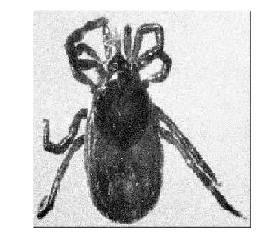

at distance 300.4756476352026:
(Class: tick)
at distance 310.28564030741376:
(Class: tick)
at distance 313.9266877699984:
(Class: tick)
at distance 319.3771146495865:
(Class: ant)
at distance 319.65873537499:
(Class: tick)
4.0
============= original: =============
(Class: ketch)


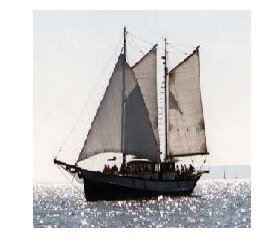

at distance 198.08480380395048:
(Class: schooner)
at distance 223.4674391542028:
(Class: schooner)
at distance 223.56032283640212:
(Class: ketch)
at distance 224.11560997524498:
(Class: schooner)
at distance 229.85513455580244:
(Class: ketch)
2.0
============= original: =============
(Class: hawksbill)


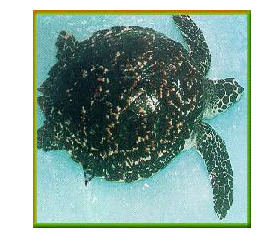

at distance 232.4411617299999:
(Class: crocodile_head)
at distance 234.61774185609696:
(Class: sea_horse)
at distance 237.6318684130768:
(Class: stegosaurus)
at distance 238.05119917692144:
(Class: Leopards)
at distance 239.7927262232657:
(Class: joshua_tree)
0.0
============= original: =============
(Class: Leopards)


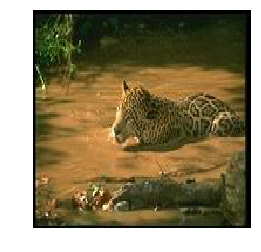

at distance 140.5692786678288:
(Class: Leopards)
at distance 247.84097500766632:
(Class: Leopards)
at distance 253.440487753309:
(Class: Leopards)
at distance 254.8670387194022:
(Class: Leopards)
at distance 255.8256359362275:
(Class: Leopards)
5.0
============= original: =============
(Class: kangaroo)


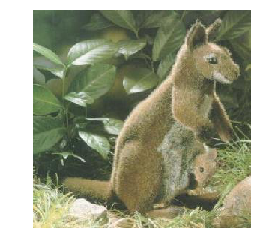

at distance 196.58435541292548:
(Class: pyramid)
at distance 197.38409876702104:
(Class: pyramid)
at distance 202.30412570991095:
(Class: crocodile_head)
at distance 202.700412676075:
(Class: kangaroo)
at distance 205.27421592378943:
(Class: beaver)
1.0
============= original: =============
(Class: garfield)


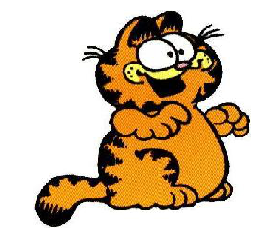

at distance 234.80315400774637:
(Class: garfield)
at distance 236.11755930845595:
(Class: snoopy)
at distance 241.70753548337615:
(Class: bass)
at distance 241.87595710819548:
(Class: cougar_face)
at distance 243.1196244263586:
(Class: bass)
1.0
============= original: =============
(Class: minaret)


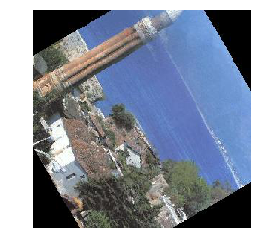

at distance 174.41145477631267:
(Class: minaret)
at distance 183.87335641328966:
(Class: minaret)
at distance 185.3553936416547:
(Class: minaret)
at distance 186.31362058916125:
(Class: minaret)
at distance 189.93688639818683:
(Class: minaret)
5.0
============= original: =============
(Class: elephant)


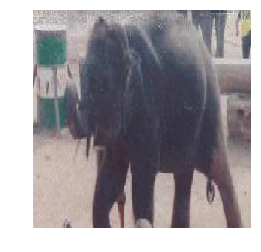

at distance 195.25249490409905:
(Class: pyramid)
at distance 195.73981238485678:
(Class: pyramid)
at distance 199.01732249232623:
(Class: car_side)
at distance 199.10294607848078:
(Class: platypus)
at distance 200.00820031787617:
(Class: car_side)
0.0
============= original: =============
(Class: pigeon)


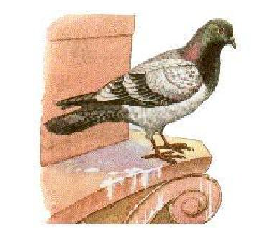

at distance 234.68272504950264:
(Class: gramophone)
at distance 236.31561884164805:
(Class: bonsai)
at distance 237.30412811982444:
(Class: cougar_face)
at distance 239.04774619916276:
(Class: pyramid)
at distance 239.30800729649638:
(Class: pyramid)
0.0
============= original: =============
(Class: strawberry)


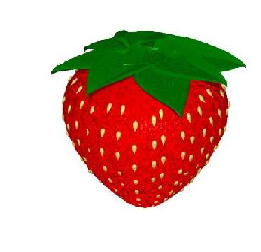

at distance 249.57287185675332:
(Class: strawberry)
at distance 253.70361563572897:
(Class: strawberry)
at distance 256.6894748636863:
(Class: strawberry)
at distance 257.7957112216068:
(Class: strawberry)
at distance 258.30235768321467:
(Class: strawberry)
5.0
============= original: =============
(Class: watch)


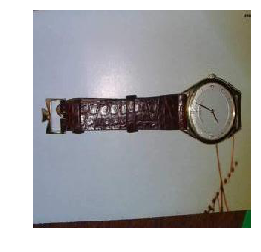

at distance 222.65649647111258:
(Class: pyramid)
at distance 224.78727270122252:
(Class: pyramid)
at distance 225.2866247670784:
(Class: Faces)
at distance 225.43983220816915:
(Class: pyramid)
at distance 227.24288039498347:
(Class: helicopter)
0.0
============= original: =============
(Class: butterfly)


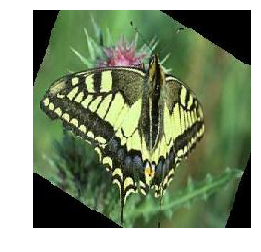

at distance 239.63431553966808:
(Class: butterfly)
at distance 257.56080334222975:
(Class: pyramid)
at distance 258.5238270797735:
(Class: butterfly)
at distance 261.4507387099734:
(Class: pyramid)
at distance 261.99348251466864:
(Class: stegosaurus)
2.0
============= original: =============
(Class: camera)


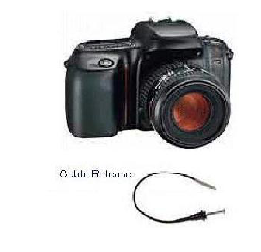

at distance 293.8341376511262:
(Class: camera)
at distance 300.8404192797672:
(Class: camera)
at distance 309.62040456615165:
(Class: camera)
at distance 312.48701855063086:
(Class: camera)
at distance 312.95773966332627:
(Class: camera)
5.0
============= original: =============
(Class: beaver)


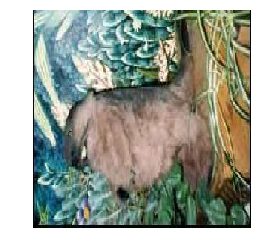

at distance 205.1325339565146:
(Class: brontosaurus)
at distance 205.34703304864908:
(Class: pyramid)
at distance 209.1149471670758:
(Class: pyramid)
at distance 212.16554624334412:
(Class: bonsai)
at distance 212.83556790138712:
(Class: cougar_face)
0.0
============= original: =============
(Class: Faces_easy)


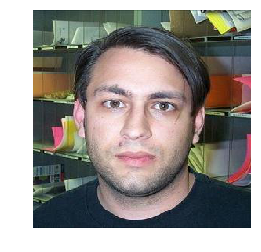

at distance 187.62275497001647:
(Class: Faces_easy)
at distance 188.37344027594108:
(Class: Faces_easy)
at distance 190.74534451177016:
(Class: Faces_easy)
at distance 192.02376909927014:
(Class: Faces_easy)
at distance 193.2052234297902:
(Class: Faces_easy)
5.0
============= original: =============
(Class: menorah)


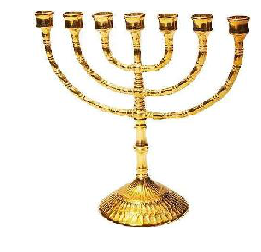

at distance 257.43262947789117:
(Class: menorah)
at distance 318.1561159179951:
(Class: menorah)
at distance 323.34178310021997:
(Class: menorah)
at distance 325.83406792469873:
(Class: menorah)
at distance 328.2440914458517:
(Class: menorah)
5.0
============= original: =============
(Class: brain)


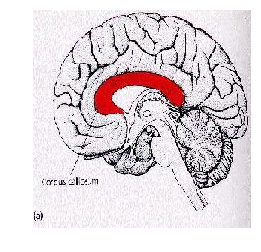

at distance 278.6393899325042:
(Class: snoopy)
at distance 281.10469630420755:
(Class: brain)
at distance 281.87216778753134:
(Class: garfield)
at distance 282.7392640016521:
(Class: brain)
at distance 285.1673215317666:
(Class: snoopy)
2.0
============= original: =============
(Class: flamingo)


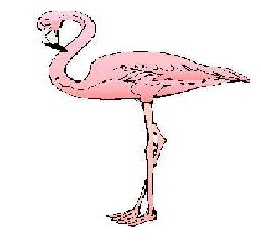

at distance 266.3658882605826:
(Class: flamingo)
at distance 266.6016119253506:
(Class: wrench)
at distance 268.67766219792065:
(Class: cougar_face)
at distance 269.8643129477293:
(Class: snoopy)
at distance 273.43775938374284:
(Class: umbrella)
1.0
============= original: =============
(Class: chair)


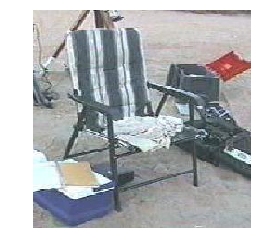

at distance 219.23461227778927:
(Class: pyramid)
at distance 222.89580695419232:
(Class: pyramid)
at distance 223.78631880090333:
(Class: chair)
at distance 226.25373674708297:
(Class: bonsai)
at distance 226.6742657683454:
(Class: chair)
2.0
============= original: =============
(Class: Faces_easy)


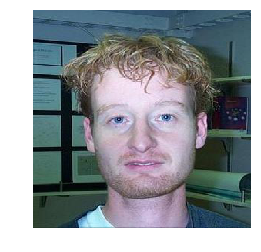

at distance 134.6777648658885:
(Class: Faces)
at distance 136.3527036842834:
(Class: Faces_easy)
at distance 143.62488225829082:
(Class: Faces_easy)
at distance 144.2214340817561:
(Class: Faces_easy)
at distance 144.59908493630027:
(Class: Faces_easy)
4.0
============= original: =============
(Class: watch)


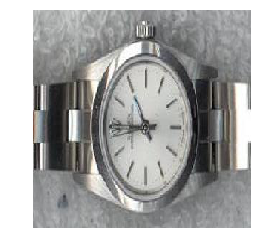

at distance 237.6354731093793:
(Class: watch)
at distance 249.8790634445672:
(Class: watch)
at distance 259.32681228334246:
(Class: watch)
at distance 264.6688096449394:
(Class: watch)
at distance 264.78919305168375:
(Class: watch)
5.0
============= original: =============
(Class: Motorbikes)


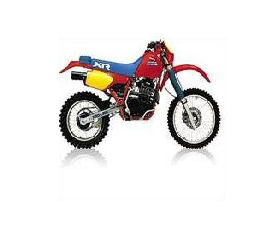

at distance 211.00177847661715:
(Class: Motorbikes)
at distance 215.99271787895748:
(Class: Motorbikes)
at distance 216.34286198281674:
(Class: Motorbikes)
at distance 216.3818038008434:
(Class: Motorbikes)
at distance 216.66758042333083:
(Class: Motorbikes)
5.0
============= original: =============
(Class: stegosaurus)


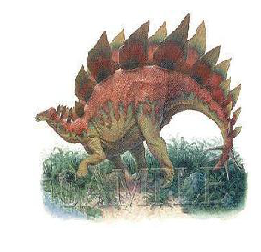

at distance 221.64120170944508:
(Class: stegosaurus)
at distance 223.07065637800014:
(Class: stegosaurus)
at distance 227.3722723351918:
(Class: stegosaurus)
at distance 227.44462892575936:
(Class: helicopter)
at distance 228.93998768586997:
(Class: bonsai)
3.0
============= original: =============
(Class: flamingo_head)


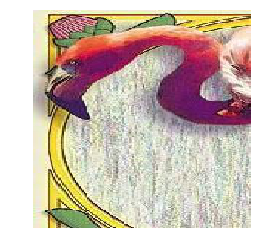

at distance 292.4681628483303:
(Class: pyramid)
at distance 295.77556047354557:
(Class: electric_guitar)
at distance 295.77636187790614:
(Class: buddha)
at distance 297.4921263845965:
(Class: dollar_bill)
at distance 297.5323432971841:
(Class: pyramid)
0.0
============= original: =============
(Class: bass)


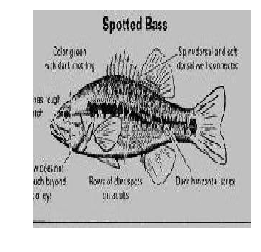

at distance 159.41856582435616:
(Class: bass)
at distance 171.0600308952527:
(Class: bass)
at distance 214.64492338315182:
(Class: cannon)
at distance 216.24702074317398:
(Class: snoopy)
at distance 223.71723127223765:
(Class: brain)
2.0
============= original: =============
(Class: mayfly)


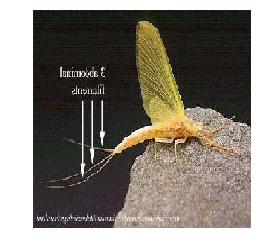

at distance 215.56750836488715:
(Class: starfish)
at distance 219.7295807653642:
(Class: pyramid)
at distance 221.5379005997398:
(Class: pyramid)
at distance 223.13897707851447:
(Class: joshua_tree)
at distance 223.3995029586421:
(Class: scorpion)
0.0
============= original: =============
(Class: lobster)


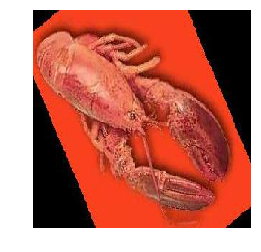

at distance 252.09361325633316:
(Class: crab)
at distance 254.1199657206341:
(Class: pagoda)
at distance 255.016037462651:
(Class: headphone)
at distance 256.74745700557577:
(Class: ant)
at distance 256.94300302003643:
(Class: platypus)
0.0
============= original: =============
(Class: airplanes)


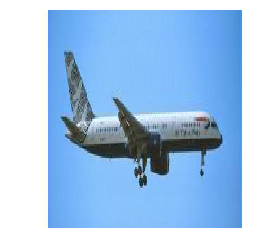

at distance 137.41136944901714:
(Class: airplanes)
at distance 139.48722469093894:
(Class: airplanes)
at distance 139.79706745879153:
(Class: airplanes)
at distance 149.01123641861096:
(Class: airplanes)
at distance 149.87986136039942:
(Class: airplanes)
5.0
============= original: =============
(Class: Leopards)


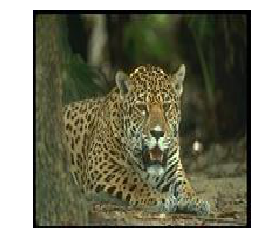

at distance 117.5844515109415:
(Class: Leopards)
at distance 181.30833395223942:
(Class: Leopards)
at distance 182.25937698382225:
(Class: Leopards)
at distance 186.83008082847732:
(Class: Leopards)
at distance 187.98420432545484:
(Class: Leopards)
5.0
============= original: =============
(Class: umbrella)


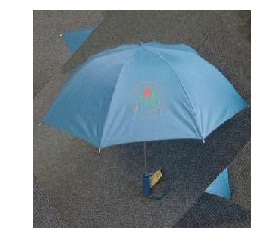

at distance 174.40437381908004:
(Class: umbrella)
at distance 179.2315796236789:
(Class: umbrella)
at distance 180.808763462631:
(Class: umbrella)
at distance 186.15298110952725:
(Class: pyramid)
at distance 187.58107721328955:
(Class: pyramid)
3.0
============= original: =============
(Class: tick)


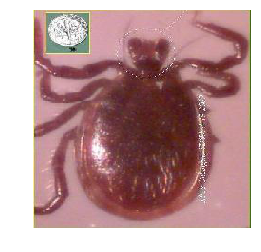

at distance 222.22022791335732:
(Class: octopus)
at distance 226.77524624320074:
(Class: strawberry)
at distance 227.58898701184603:
(Class: platypus)
at distance 232.10638997525209:
(Class: octopus)
at distance 232.37958063933337:
(Class: scorpion)
0.0
============= original: =============
(Class: airplanes)


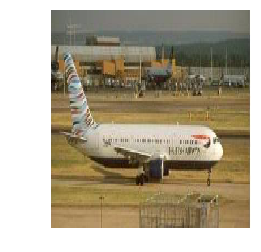

at distance 149.44299615919437:
(Class: airplanes)
at distance 155.40698924486534:
(Class: airplanes)
at distance 157.15531068662781:
(Class: airplanes)
at distance 158.13690684847145:
(Class: airplanes)
at distance 158.75470823153665:
(Class: airplanes)
5.0
============= original: =============
(Class: ketch)


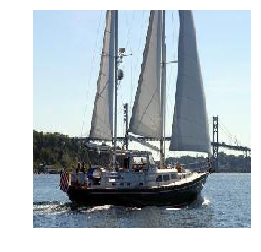

at distance 244.63895751076947:
(Class: ketch)
at distance 252.94234096186423:
(Class: ketch)
at distance 254.90097033993314:
(Class: ketch)
at distance 263.98235825995204:
(Class: ketch)
at distance 265.1336533723321:
(Class: ketch)
5.0
============= original: =============
(Class: lotus)


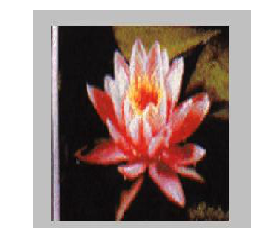

at distance 251.16639910145452:
(Class: lotus)
at distance 259.33399798180506:
(Class: lotus)
at distance 264.9446660387649:
(Class: stegosaurus)
at distance 267.1535227425301:
(Class: lotus)
at distance 269.0530541226376:
(Class: airplanes)
3.0
============= original: =============
(Class: ewer)


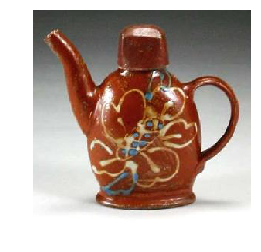

at distance 302.71636646515515:
(Class: ewer)
at distance 308.9457853757334:
(Class: ewer)
at distance 311.4517103467832:
(Class: ewer)
at distance 315.69935406411554:
(Class: cup)
at distance 319.0514104207167:
(Class: ewer)
4.0
============= original: =============
(Class: airplanes)


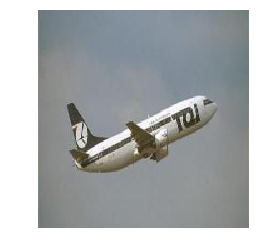

at distance 148.40044249853392:
(Class: airplanes)
at distance 157.23788046719716:
(Class: airplanes)
at distance 160.7459675999692:
(Class: airplanes)
at distance 161.1573299137871:
(Class: airplanes)
at distance 162.42605517429087:
(Class: airplanes)
5.0
============= original: =============
(Class: pigeon)


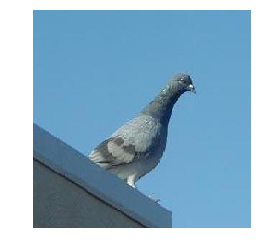

at distance 242.63154679401742:
(Class: pyramid)
at distance 245.06918190785953:
(Class: pyramid)
at distance 247.95952031723613:
(Class: pigeon)
at distance 250.93758434069076:
(Class: helicopter)
at distance 252.00782179397027:
(Class: pyramid)
1.0
============= original: =============
(Class: crab)


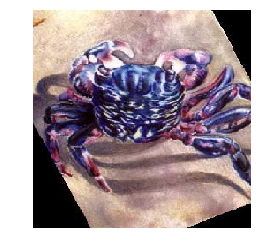

at distance 260.59281104055134:
(Class: strawberry)
at distance 264.8276878499265:
(Class: crab)
at distance 268.27877723103546:
(Class: cougar_face)
at distance 268.45749297696807:
(Class: pyramid)
at distance 269.13210927120764:
(Class: pyramid)
1.0
============= original: =============
(Class: wild_cat)


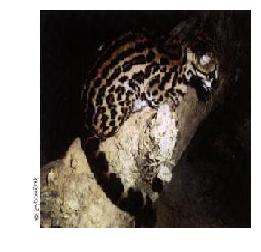

at distance 170.2697369543666:
(Class: Leopards)
at distance 173.42377783636803:
(Class: pyramid)
at distance 173.48673628207752:
(Class: pyramid)
at distance 173.96268958133038:
(Class: crocodile_head)
at distance 177.4720267074461:
(Class: car_side)
0.0
============= original: =============
(Class: airplanes)


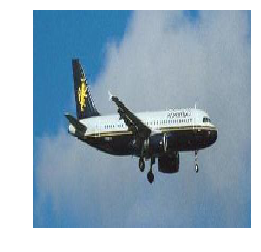

at distance 162.45785964438156:
(Class: airplanes)
at distance 170.4262465676435:
(Class: airplanes)
at distance 172.8117226148642:
(Class: airplanes)
at distance 175.42185680541525:
(Class: airplanes)
at distance 183.5794860280972:
(Class: airplanes)
5.0
============= original: =============
(Class: Faces)


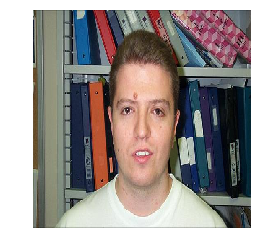

at distance 196.00573490371704:
(Class: Faces)
at distance 197.19808498962306:
(Class: Faces_easy)
at distance 199.19983005820032:
(Class: Faces)
at distance 200.9040229064355:
(Class: Faces)
at distance 200.99756767783816:
(Class: Faces)
4.0
============= original: =============
(Class: cougar_body)


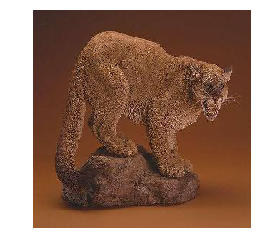

at distance 231.7877539273858:
(Class: crocodile_head)
at distance 236.32931041659774:
(Class: stegosaurus)
at distance 237.24371949865048:
(Class: pyramid)
at distance 239.22339848987443:
(Class: rhino)
at distance 239.43498984097607:
(Class: joshua_tree)
0.0
============= original: =============
(Class: crayfish)


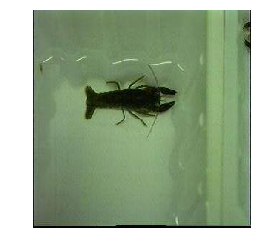

at distance 252.76760978215611:
(Class: crayfish)
at distance 257.2657047358668:
(Class: crayfish)
at distance 265.24591627536284:
(Class: mayfly)
at distance 270.6868214862488:
(Class: scorpion)
at distance 272.2229478630112:
(Class: platypus)
2.0
============= original: =============
(Class: cup)


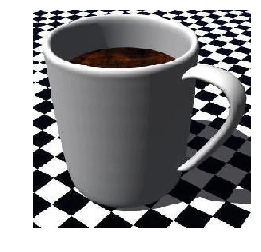

at distance 420.02637495099924:
(Class: cup)
at distance 423.75172455432954:
(Class: cup)
at distance 426.9774596571618:
(Class: cup)
at distance 432.9560005049262:
(Class: cup)
at distance 435.60959802296287:
(Class: cup)
5.0
============= original: =============
(Class: garfield)


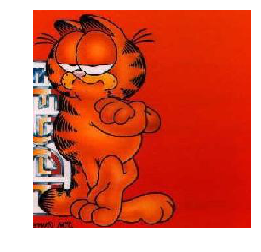

at distance 193.32845228520827:
(Class: snoopy)
at distance 200.41878105557228:
(Class: snoopy)
at distance 201.4019247775454:
(Class: garfield)
at distance 211.79913147216962:
(Class: garfield)
at distance 212.6921534986621:
(Class: garfield)
3.0
============= original: =============
(Class: airplanes)


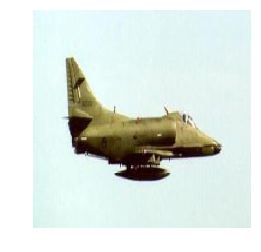

at distance 220.6420322524978:
(Class: airplanes)
at distance 220.73802739179516:
(Class: airplanes)
at distance 221.65659758619896:
(Class: airplanes)
at distance 221.7395230967509:
(Class: airplanes)
at distance 222.09514792826232:
(Class: airplanes)
5.0
============= original: =============
(Class: headphone)


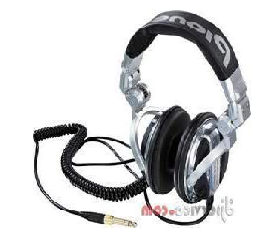

at distance 252.71307416982557:
(Class: headphone)
at distance 263.0686993383684:
(Class: headphone)
at distance 267.1128245751186:
(Class: headphone)
at distance 268.15178928459966:
(Class: headphone)
at distance 268.98038905820454:
(Class: headphone)
5.0
============= original: =============
(Class: wheelchair)


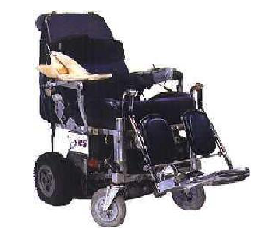

at distance 269.45104390128046:
(Class: wheelchair)
at distance 278.9456137992825:
(Class: wheelchair)
at distance 281.51844892430876:
(Class: Motorbikes)
at distance 285.00429077786276:
(Class: Motorbikes)
at distance 286.06113147320957:
(Class: Motorbikes)
2.0
============= original: =============
(Class: rooster)


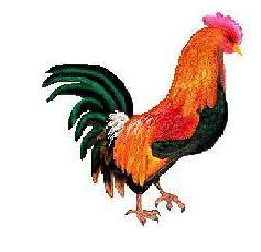

at distance 315.50012359866764:
(Class: rooster)
at distance 335.01529505951487:
(Class: rooster)
at distance 361.8661708929168:
(Class: rooster)
at distance 364.6977155424174:
(Class: rooster)
at distance 365.7180787541904:
(Class: rooster)
5.0
============= original: =============
(Class: Faces)


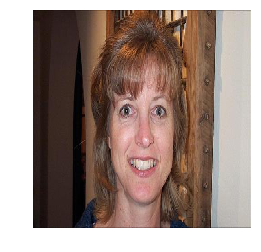

at distance 105.17569342337588:
(Class: Faces_easy)
at distance 113.6188565288697:
(Class: Faces)
at distance 117.07942828055931:
(Class: Faces)
at distance 119.64505308792289:
(Class: Faces)
at distance 119.83875634422763:
(Class: Faces)
4.0
============= original: =============
(Class: airplanes)


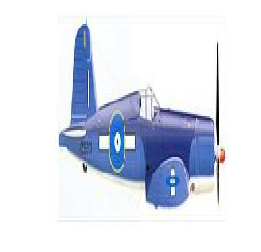

at distance 256.8276341907717:
(Class: airplanes)
at distance 261.23122449298165:
(Class: airplanes)
at distance 261.28658180461787:
(Class: airplanes)
at distance 261.45184274424923:
(Class: airplanes)
at distance 262.08331490126216:
(Class: airplanes)
5.0
============= original: =============
(Class: Motorbikes)


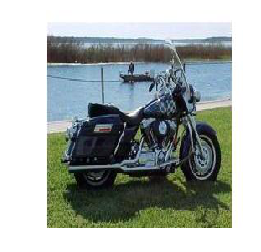

at distance 107.50531528387704:
(Class: Motorbikes)
at distance 195.10300096099533:
(Class: Motorbikes)
at distance 196.21495720590565:
(Class: Motorbikes)
at distance 199.12275548569067:
(Class: Motorbikes)
at distance 199.5541555384041:
(Class: Motorbikes)
5.0
============= original: =============
(Class: cannon)


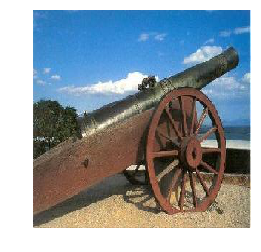

at distance 284.3142265258842:
(Class: cannon)
at distance 290.19812314932756:
(Class: cannon)
at distance 302.95698801863495:
(Class: cannon)
at distance 303.0163187938659:
(Class: cannon)
at distance 305.9833164186341:
(Class: cannon)
5.0
============= original: =============
(Class: airplanes)


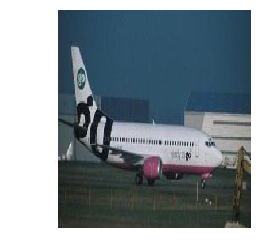

at distance 133.5146341199171:
(Class: airplanes)
at distance 142.3495422940671:
(Class: airplanes)
at distance 152.4176546772547:
(Class: airplanes)
at distance 155.13973958110122:
(Class: airplanes)
at distance 155.204706289103:
(Class: airplanes)
5.0
============= original: =============
(Class: airplanes)


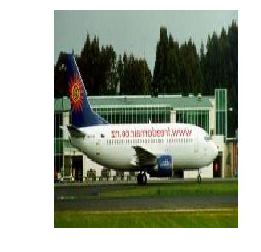

at distance 166.8538767922192:
(Class: airplanes)
at distance 229.3661177307429:
(Class: airplanes)
at distance 237.21956309616573:
(Class: airplanes)
at distance 241.43834055880248:
(Class: airplanes)
at distance 245.36323594082216:
(Class: airplanes)
5.0
============= original: =============
(Class: sea_horse)


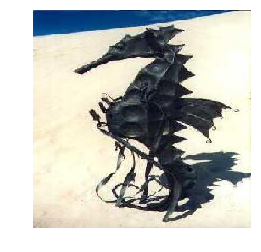

at distance 204.07125653124237:
(Class: platypus)
at distance 213.76864139619317:
(Class: pyramid)
at distance 214.20445506405153:
(Class: joshua_tree)
at distance 215.0577537838797:
(Class: pyramid)
at distance 217.1254021390749:
(Class: pyramid)
0.0
============= original: =============
(Class: cellphone)


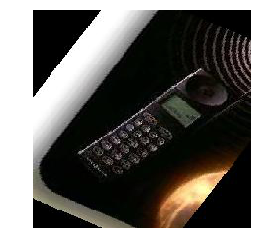

at distance 223.34200845306353:
(Class: cellphone)
at distance 231.2335749828198:
(Class: cellphone)
at distance 231.88895375551712:
(Class: pagoda)
at distance 239.79416388223015:
(Class: minaret)
at distance 241.52270942886736:
(Class: cellphone)
3.0
============= original: =============
(Class: chair)


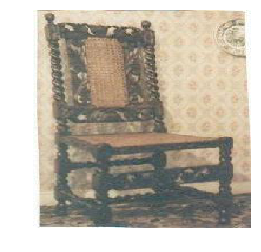

at distance 162.96795612309222:
(Class: buddha)
at distance 170.32680217377887:
(Class: pyramid)
at distance 171.10335300769978:
(Class: bonsai)
at distance 176.00072709657573:
(Class: pyramid)
at distance 177.88099313887494:
(Class: pyramid)
0.0
============= original: =============
(Class: Motorbikes)


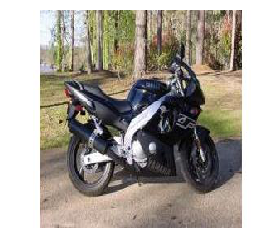

at distance 233.46648602138947:
(Class: Motorbikes)
at distance 263.1654685005056:
(Class: Motorbikes)
at distance 268.8123230890873:
(Class: Motorbikes)
at distance 272.8581338027549:
(Class: Motorbikes)
at distance 273.22826349717224:
(Class: Motorbikes)
5.0
============= original: =============
(Class: dragonfly)


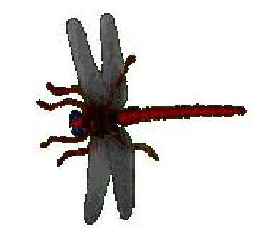

at distance 290.6398089600782:
(Class: ceiling_fan)
at distance 294.0804707325025:
(Class: helicopter)
at distance 298.8516210222204:
(Class: airplanes)
at distance 299.3714835667519:
(Class: chandelier)
at distance 299.7263909227144:
(Class: helicopter)
0.0
============= original: =============
(Class: dragonfly)


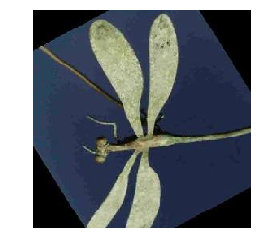

at distance 218.54887655103613:
(Class: minaret)
at distance 220.6371792655005:
(Class: dragonfly)
at distance 224.00028739596814:
(Class: ant)
at distance 225.84917503338386:
(Class: pagoda)
at distance 229.0949369910945:
(Class: scissors)
1.0
============= original: =============
(Class: ceiling_fan)


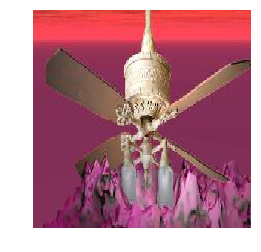

at distance 252.55456510972917:
(Class: ceiling_fan)
at distance 253.51864103976305:
(Class: pyramid)
at distance 257.7627115422454:
(Class: pyramid)
at distance 258.1824595761672:
(Class: ceiling_fan)
at distance 258.2007080061891:
(Class: pyramid)
2.0
============= original: =============
(Class: stop_sign)


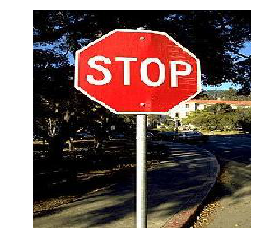

at distance 212.02769201617977:
(Class: stop_sign)
at distance 220.79285841306108:
(Class: stop_sign)
at distance 251.20411849180368:
(Class: stop_sign)
at distance 252.8280182551068:
(Class: stop_sign)
at distance 263.9154149420154:
(Class: stop_sign)
5.0
============= original: =============
(Class: airplanes)


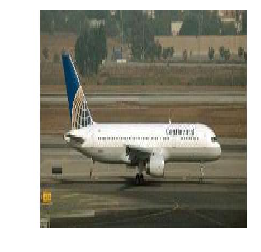

at distance 141.72995725077135:
(Class: airplanes)
at distance 147.4122268654792:
(Class: airplanes)
at distance 164.9981681858525:
(Class: airplanes)
at distance 167.92117605242223:
(Class: airplanes)
at distance 168.33482049142876:
(Class: airplanes)
5.0
============= original: =============
(Class: gerenuk)


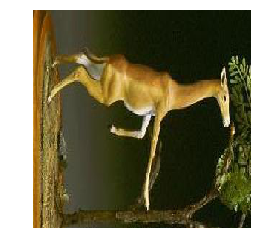

at distance 203.3248973456183:
(Class: gerenuk)
at distance 216.47582485632952:
(Class: gerenuk)
at distance 221.02361801923306:
(Class: brontosaurus)
at distance 229.5275928663065:
(Class: pyramid)
at distance 230.14183813805394:
(Class: bonsai)
2.0
============= original: =============
(Class: Faces_easy)


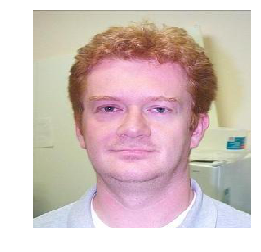

at distance 114.61945452469716:
(Class: Faces_easy)
at distance 117.10149305509516:
(Class: Faces_easy)
at distance 125.64200970363459:
(Class: Faces_easy)
at distance 128.59881256881857:
(Class: Faces_easy)
at distance 129.8882838133953:
(Class: Faces_easy)
5.0
============= original: =============
(Class: Motorbikes)


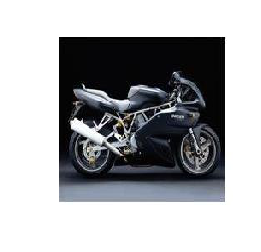

at distance 119.42483661559775:
(Class: Motorbikes)
at distance 120.26318859283637:
(Class: Motorbikes)
at distance 123.20552589100393:
(Class: Motorbikes)
at distance 165.8168657216465:
(Class: Motorbikes)
at distance 169.99730210426122:
(Class: Motorbikes)
5.0
============= original: =============
(Class: Faces)


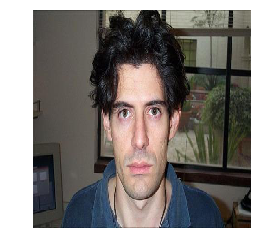

at distance 121.26084027423057:
(Class: Faces)
at distance 128.30248259326757:
(Class: Faces_easy)
at distance 130.9426177074406:
(Class: Faces)
at distance 131.15204354959963:
(Class: Faces)
at distance 135.5837122853081:
(Class: Faces)
4.0
============= original: =============
(Class: wheelchair)


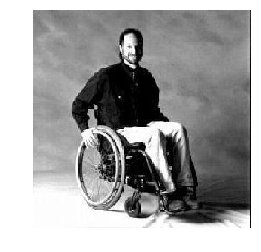

at distance 234.17308065389815:
(Class: Motorbikes)
at distance 236.69506356961824:
(Class: wheelchair)
at distance 240.2174488130063:
(Class: wheelchair)
at distance 243.1994799798498:
(Class: Motorbikes)
at distance 243.6346127515817:
(Class: wheelchair)
3.0
============= original: =============
(Class: ibis)


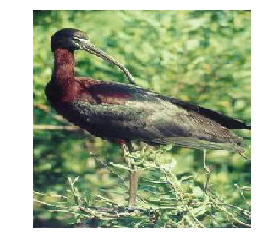

at distance 234.58201253505885:
(Class: ibis)
at distance 266.34687238940063:
(Class: ibis)
at distance 266.8029032291138:
(Class: ibis)
at distance 267.99196047943957:
(Class: flamingo)
at distance 268.3841886387714:
(Class: ibis)
4.0
============= original: =============
(Class: lamp)


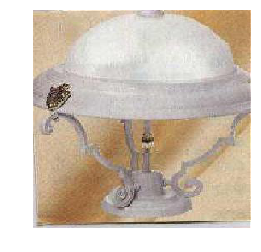

at distance 235.91200234867722:
(Class: bonsai)
at distance 241.68926996772444:
(Class: pyramid)
at distance 242.61041466793594:
(Class: revolver)
at distance 243.0946040201499:
(Class: pyramid)
at distance 244.22463980324042:
(Class: strawberry)
0.0
============= original: =============
(Class: pizza)


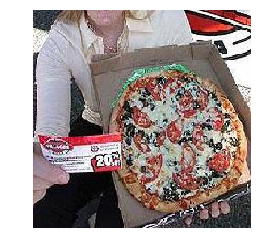

at distance 235.13478666310132:
(Class: pyramid)
at distance 235.7137936089736:
(Class: pyramid)
at distance 235.99870019596395:
(Class: Faces)
at distance 236.7368000236592:
(Class: Faces)
at distance 237.61897030570623:
(Class: pizza)
1.0
============= original: =============
(Class: cup)


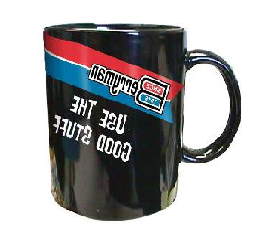

at distance 323.0601436736757:
(Class: cup)
at distance 324.58589894339616:
(Class: cup)
at distance 328.19830335525614:
(Class: cup)
at distance 337.45681103479404:
(Class: cup)
at distance 342.0060558442658:
(Class: cup)
5.0
============= original: =============
(Class: pagoda)


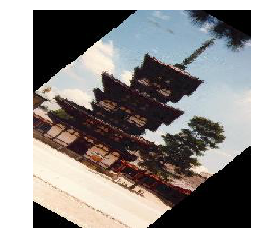

at distance 169.59136458996068:
(Class: pagoda)
at distance 173.92072473661372:
(Class: minaret)
at distance 175.62560920702842:
(Class: minaret)
at distance 178.9154624101254:
(Class: pagoda)
at distance 179.23649184583502:
(Class: pagoda)
3.0
============= original: =============
(Class: soccer_ball)


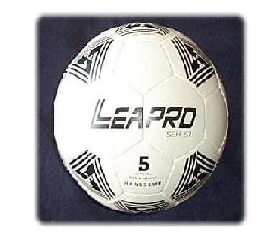

at distance 386.64063598671316:
(Class: soccer_ball)
at distance 398.421087982406:
(Class: soccer_ball)
at distance 400.5654331749461:
(Class: soccer_ball)
at distance 401.845045822131:
(Class: watch)
at distance 402.39295365517506:
(Class: soccer_ball)
4.0
============= original: =============
(Class: car_side)


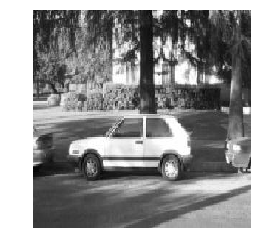

at distance 131.66136777359478:
(Class: car_side)
at distance 143.5821522399921:
(Class: car_side)
at distance 147.56769540214796:
(Class: car_side)
at distance 151.20229502215864:
(Class: car_side)
at distance 151.61050634032398:
(Class: car_side)
5.0
============= original: =============
(Class: Faces_easy)


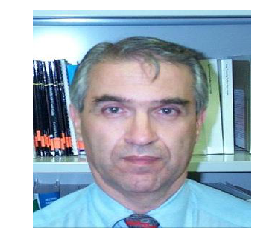

at distance 154.2526387148242:
(Class: Faces_easy)
at distance 162.14377476986596:
(Class: Faces_easy)
at distance 164.19705922884862:
(Class: Faces_easy)
at distance 165.0706574731981:
(Class: Faces_easy)
at distance 167.06419088382435:
(Class: Faces_easy)
5.0
============= original: =============
(Class: Faces)


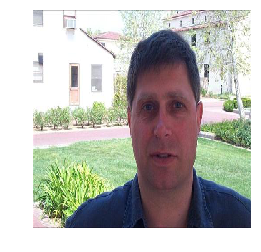

at distance 132.08095437578365:
(Class: Faces_easy)
at distance 148.89241910217396:
(Class: Faces_easy)
at distance 150.5542037911057:
(Class: Faces)
at distance 157.60044002186115:
(Class: Faces)
at distance 158.83089689580507:
(Class: Faces)
3.0
============= original: =============
(Class: trilobite)


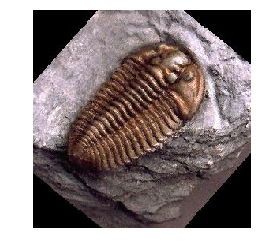

at distance 263.92217065335944:
(Class: trilobite)
at distance 268.1211154482791:
(Class: trilobite)
at distance 277.4206953286746:
(Class: trilobite)
at distance 282.5333211792927:
(Class: trilobite)
at distance 288.1774451009694:
(Class: trilobite)
5.0
============= original: =============
(Class: emu)


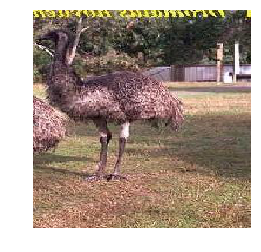

at distance 212.0896650418116:
(Class: emu)
at distance 221.4549159344539:
(Class: emu)
at distance 221.97068603047933:
(Class: emu)
at distance 230.18928788726058:
(Class: llama)
at distance 234.85190779775803:
(Class: brontosaurus)
3.0
============= original: =============
(Class: butterfly)


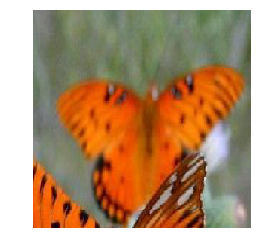

at distance 291.1499954711141:
(Class: pyramid)
at distance 292.23789309619747:
(Class: starfish)
at distance 293.75807870918743:
(Class: pyramid)
at distance 294.50443267226086:
(Class: butterfly)
at distance 296.67442026076185:
(Class: strawberry)
1.0
============= original: =============
(Class: airplanes)


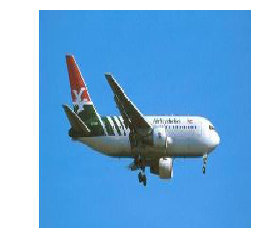

at distance 158.94554677780036:
(Class: airplanes)
at distance 159.48334830455033:
(Class: airplanes)
at distance 166.85949262509934:
(Class: airplanes)
at distance 178.50091958488082:
(Class: airplanes)
at distance 180.1118467350281:
(Class: airplanes)
5.0
============= original: =============
(Class: joshua_tree)


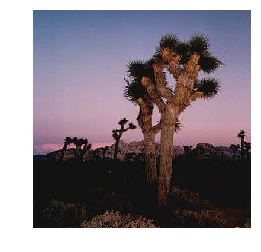

at distance 121.49729628986968:
(Class: joshua_tree)
at distance 143.68808895051873:
(Class: joshua_tree)
at distance 146.36589758141116:
(Class: joshua_tree)
at distance 147.6726454681098:
(Class: joshua_tree)
at distance 149.88323263039428:
(Class: joshua_tree)
5.0
============= original: =============
(Class: ewer)


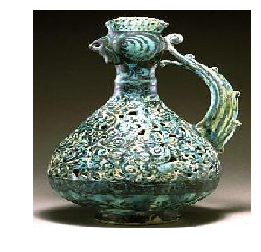

at distance 318.4990596645216:
(Class: ewer)
at distance 321.1383232056886:
(Class: ewer)
at distance 323.96895781508766:
(Class: ewer)
at distance 324.5993628188166:
(Class: ewer)
at distance 329.71918045773566:
(Class: ewer)
5.0
============= original: =============
(Class: pizza)


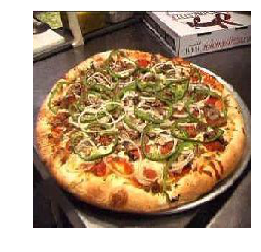

at distance 297.81012124784036:
(Class: pizza)
at distance 309.52106044019723:
(Class: pizza)
at distance 312.1000205912327:
(Class: pizza)
at distance 318.9696594254669:
(Class: pizza)
at distance 319.79571660735263:
(Class: pizza)
5.0
============= original: =============
(Class: emu)


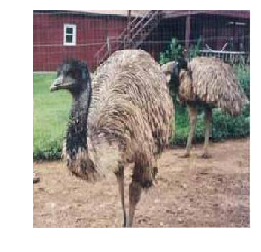

at distance 259.8294890212914:
(Class: emu)
at distance 279.64920565683326:
(Class: emu)
at distance 285.9350117068601:
(Class: emu)
at distance 288.9791401857903:
(Class: emu)
at distance 288.9837278233845:
(Class: emu)
5.0
============= original: =============
(Class: menorah)


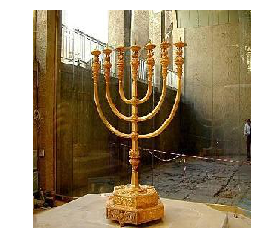

at distance 277.33502015010674:
(Class: menorah)
at distance 288.200809324318:
(Class: menorah)
at distance 290.35292450912283:
(Class: menorah)
at distance 292.58387493007507:
(Class: bonsai)
at distance 293.0555869631813:
(Class: menorah)
4.0
============= original: =============
(Class: ewer)


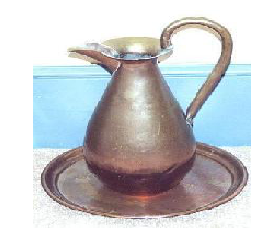

at distance 339.0301300791236:
(Class: ewer)
at distance 343.8779006112033:
(Class: ewer)
at distance 354.48952682178447:
(Class: ewer)
at distance 355.06644425815466:
(Class: ewer)
at distance 355.201355963239:
(Class: ewer)
5.0
============= original: =============
(Class: Faces_easy)


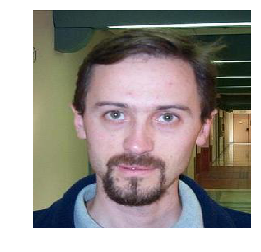

at distance 123.39867262637935:
(Class: Faces_easy)
at distance 128.83162882040872:
(Class: Faces_easy)
at distance 135.99437369950002:
(Class: Faces_easy)
at distance 137.3799330104779:
(Class: Faces_easy)
at distance 138.56304463946276:
(Class: Faces_easy)
5.0
============= original: =============
(Class: airplanes)


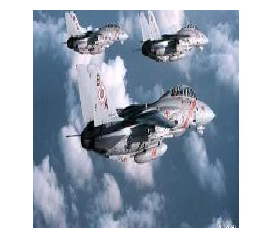

at distance 279.98650474872943:
(Class: airplanes)
at distance 282.34050370269534:
(Class: airplanes)
at distance 286.8394917355173:
(Class: airplanes)
at distance 288.80466011862956:
(Class: helicopter)
at distance 288.9295292781034:
(Class: airplanes)
4.0
============= original: =============
(Class: crab)


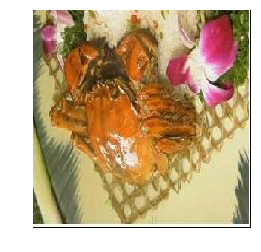

at distance 195.07031100399524:
(Class: pyramid)
at distance 202.2843577076777:
(Class: platypus)
at distance 202.56889081015782:
(Class: buddha)
at distance 203.77774046016592:
(Class: pyramid)
at distance 205.1787961794099:
(Class: bonsai)
0.0
============= original: =============
(Class: scorpion)


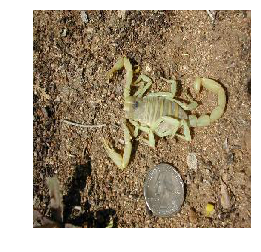

at distance 196.3077204427513:
(Class: scorpion)
at distance 200.45967141530943:
(Class: crab)
at distance 205.43786981620613:
(Class: crayfish)
at distance 206.15579849073384:
(Class: scorpion)
at distance 212.61077068963294:
(Class: scorpion)
3.0
============= original: =============
(Class: airplanes)


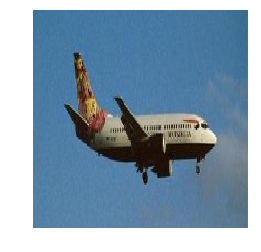

at distance 163.44132624749304:
(Class: airplanes)
at distance 164.445130065525:
(Class: airplanes)
at distance 170.95221360005976:
(Class: airplanes)
at distance 177.62718098971493:
(Class: airplanes)
at distance 180.42433363648297:
(Class: airplanes)
5.0
============= original: =============
(Class: trilobite)


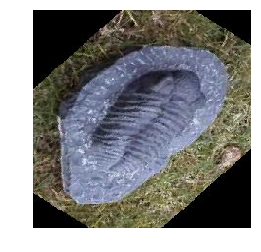

at distance 189.7589112921275:
(Class: trilobite)
at distance 209.03025557098368:
(Class: trilobite)
at distance 214.60534798158292:
(Class: trilobite)
at distance 222.15314938390352:
(Class: trilobite)
at distance 223.50449701175535:
(Class: trilobite)
5.0
============= original: =============
(Class: panda)


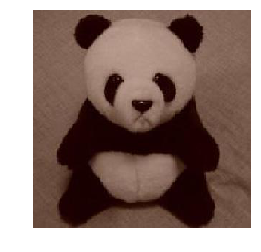

at distance 282.1459940255932:
(Class: panda)
at distance 300.58279740210287:
(Class: panda)
at distance 301.76044017462175:
(Class: panda)
at distance 308.3803288898891:
(Class: panda)
at distance 309.569325387248:
(Class: soccer_ball)
4.0
============= original: =============
(Class: watch)


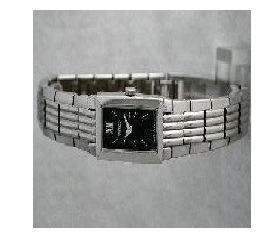

at distance 198.3146608813021:
(Class: pyramid)
at distance 204.10815022097663:
(Class: ferry)
at distance 204.70687116167036:
(Class: electric_guitar)
at distance 207.59687945165885:
(Class: pyramid)
at distance 208.30949450176337:
(Class: car_side)
0.0
============= original: =============
(Class: barrel)


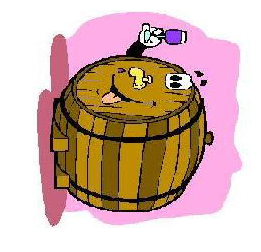

at distance 249.48037111136048:
(Class: cougar_face)
at distance 253.83366655938408:
(Class: bass)
at distance 255.73002741952854:
(Class: bass)
at distance 258.8124396523418:
(Class: helicopter)
at distance 259.2767009289196:
(Class: buddha)
0.0
============= original: =============
(Class: snoopy)


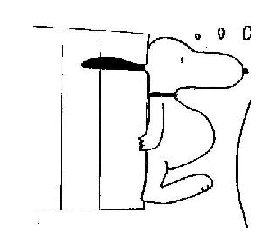

at distance 211.7019595093549:
(Class: snoopy)
at distance 217.60956289691543:
(Class: snoopy)
at distance 220.41566108689074:
(Class: snoopy)
at distance 222.7944234830342:
(Class: snoopy)
at distance 224.60232313435185:
(Class: snoopy)
5.0
============= original: =============
(Class: lobster)


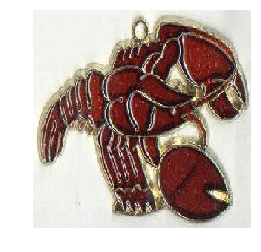

at distance 309.2615393743503:
(Class: garfield)
at distance 310.89341578328924:
(Class: cougar_face)
at distance 311.20113223254793:
(Class: yin_yang)
at distance 311.41759221548006:
(Class: butterfly)
at distance 312.78517202569435:
(Class: bass)
0.0
============= original: =============
(Class: Faces_easy)


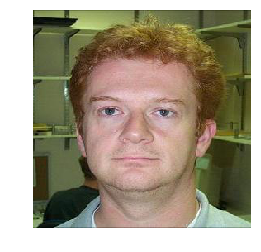

at distance 108.5499909831501:
(Class: Faces_easy)
at distance 113.7244519804235:
(Class: Faces_easy)
at distance 114.42847064854848:
(Class: Faces_easy)
at distance 114.86160788060873:
(Class: Faces_easy)
at distance 115.81027956116648:
(Class: Faces_easy)
5.0
============= original: =============
(Class: Leopards)


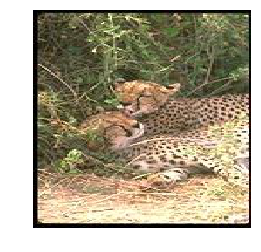

at distance 104.9973959708283:
(Class: Leopards)
at distance 174.16363255865437:
(Class: Leopards)
at distance 176.8339364420887:
(Class: Leopards)
at distance 177.25255134517326:
(Class: Leopards)
at distance 179.86208876943857:
(Class: Leopards)
5.0
============= original: =============
(Class: chair)


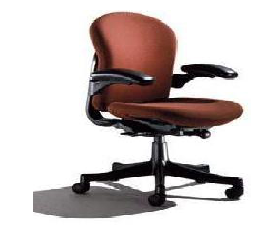

at distance 307.31060829827874:
(Class: chair)
at distance 307.4693289858581:
(Class: chair)
at distance 325.5590928386569:
(Class: windsor_chair)
at distance 328.36079738856694:
(Class: windsor_chair)
at distance 328.42730936125304:
(Class: stapler)
2.0
============= original: =============
(Class: crab)


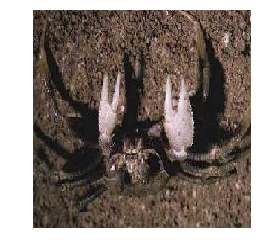

at distance 205.2374348950788:
(Class: crab)
at distance 211.0553100799521:
(Class: crab)
at distance 212.31736427509816:
(Class: crab)
at distance 216.4911054052265:
(Class: scorpion)
at distance 217.43986188182717:
(Class: crayfish)
3.0
============= original: =============
(Class: watch)


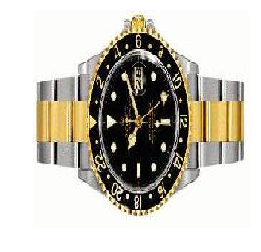

at distance 255.86420229845683:
(Class: watch)
at distance 289.292901875367:
(Class: watch)
at distance 302.06678915421315:
(Class: watch)
at distance 304.0249217664057:
(Class: watch)
at distance 304.98717814194157:
(Class: watch)
5.0
============= original: =============
(Class: brain)


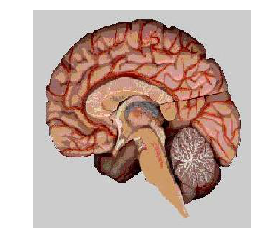

at distance 273.0694571944241:
(Class: brain)
at distance 319.1752917716552:
(Class: brain)
at distance 322.7214123291136:
(Class: brain)
at distance 333.48772721537875:
(Class: brain)
at distance 340.66309794118905:
(Class: brain)
5.0
============= original: =============
(Class: tick)


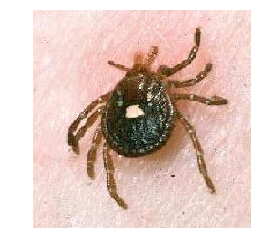

at distance 363.0918707043631:
(Class: tick)
at distance 368.2992334904904:
(Class: crab)
at distance 368.3331584151392:
(Class: tick)
at distance 374.8860969508062:
(Class: tick)
at distance 379.8906478634789:
(Class: scorpion)
3.0
============= original: =============
(Class: ketch)


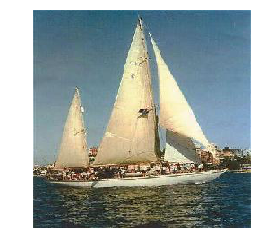

at distance 234.91370203921343:
(Class: ketch)
at distance 235.6990027862457:
(Class: schooner)
at distance 237.12294363378737:
(Class: ketch)
at distance 237.36700134103023:
(Class: schooner)
at distance 238.9199116893705:
(Class: ketch)
3.0
============= original: =============
(Class: joshua_tree)


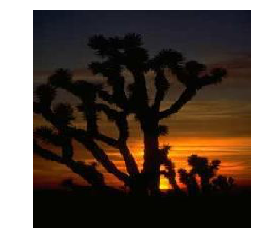

at distance 154.27893362752232:
(Class: joshua_tree)
at distance 156.91337448481931:
(Class: joshua_tree)
at distance 156.93064131834356:
(Class: joshua_tree)
at distance 163.5211646740238:
(Class: joshua_tree)
at distance 164.04927565623822:
(Class: joshua_tree)
5.0
============= original: =============
(Class: car_side)


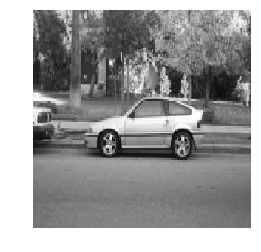

at distance 116.43198063968958:
(Class: car_side)
at distance 117.74749934495655:
(Class: car_side)
at distance 118.95326680798557:
(Class: car_side)
at distance 120.11513505695632:
(Class: car_side)
at distance 120.71479301213087:
(Class: car_side)
5.0
============= original: =============
(Class: Motorbikes)


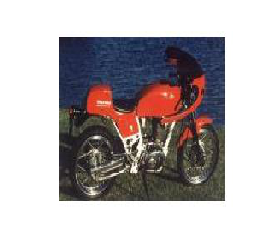

at distance 192.65968831839186:
(Class: Motorbikes)
at distance 202.22851234571135:
(Class: Motorbikes)
at distance 202.72776917907174:
(Class: Motorbikes)
at distance 203.2879861673105:
(Class: Motorbikes)
at distance 203.72311049789352:
(Class: Motorbikes)
5.0
============= original: =============
(Class: wheelchair)


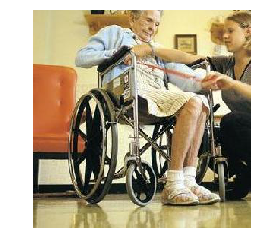

at distance 241.30301236400462:
(Class: wheelchair)
at distance 252.18029583689693:
(Class: wheelchair)
at distance 256.9216823207033:
(Class: wheelchair)
at distance 259.1944215585047:
(Class: wheelchair)
at distance 262.5231110560981:
(Class: wheelchair)
5.0
============= original: =============
(Class: Motorbikes)


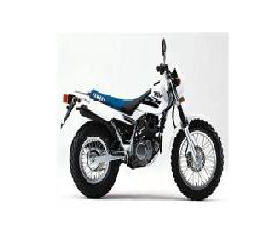

at distance 178.7217103232657:
(Class: Motorbikes)
at distance 186.41306672329264:
(Class: Motorbikes)
at distance 188.99453475564331:
(Class: Motorbikes)
at distance 189.07815368963995:
(Class: Motorbikes)
at distance 191.42989580005042:
(Class: Motorbikes)
5.0
============= original: =============
(Class: dollar_bill)


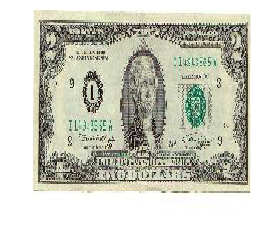

at distance 166.79034553493946:
(Class: dollar_bill)
at distance 169.72378255132773:
(Class: dollar_bill)
at distance 170.7819047549834:
(Class: dollar_bill)
at distance 189.9333310630187:
(Class: dollar_bill)
at distance 193.61299428780313:
(Class: dollar_bill)
5.0
============= original: =============
(Class: stapler)


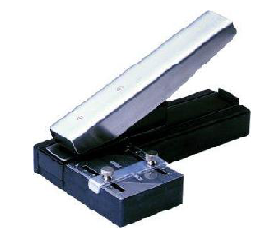

at distance 227.9374891258138:
(Class: stapler)
at distance 231.63861160464762:
(Class: stapler)
at distance 238.2960065239454:
(Class: stapler)
at distance 245.60671353686243:
(Class: stapler)
at distance 250.67155698600192:
(Class: stapler)
5.0
============= original: =============
(Class: dragonfly)


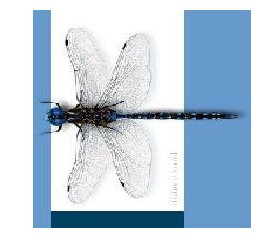

at distance 254.67607078013995:
(Class: dragonfly)
at distance 282.8762786271057:
(Class: dragonfly)
at distance 309.0096543502439:
(Class: dragonfly)
at distance 320.1202915976447:
(Class: dragonfly)
at distance 320.78123618545897:
(Class: dragonfly)
5.0
============= original: =============
(Class: chair)


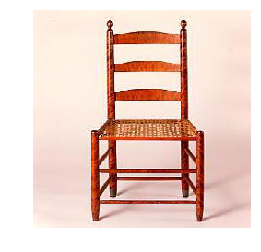

at distance 248.74921147811864:
(Class: chair)
at distance 289.79407140708804:
(Class: chair)
at distance 306.59532696590486:
(Class: chair)
at distance 308.9522220019702:
(Class: chair)
at distance 320.0085260823321:
(Class: chair)
5.0
============= original: =============
(Class: scissors)


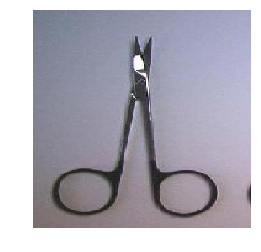

at distance 177.78516077570222:
(Class: scissors)
at distance 180.3086182250707:
(Class: scissors)
at distance 187.02449036142647:
(Class: pyramid)
at distance 187.0358548470736:
(Class: scissors)
at distance 189.0986188674145:
(Class: scissors)
4.0
============= original: =============
(Class: Faces_easy)


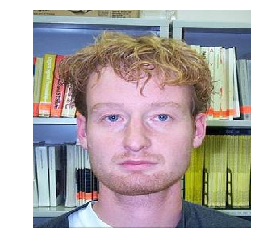

at distance 159.07934465900928:
(Class: Faces_easy)
at distance 172.6895865216691:
(Class: Faces_easy)
at distance 175.17215153735197:
(Class: Faces_easy)
at distance 179.77763813411792:
(Class: Faces_easy)
at distance 180.55336742044855:
(Class: Faces_easy)
5.0
============= original: =============
(Class: airplanes)


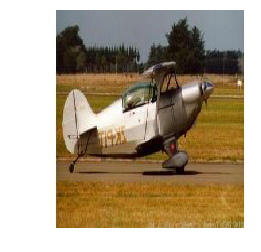

at distance 221.80617781333385:
(Class: airplanes)
at distance 222.68329720006022:
(Class: airplanes)
at distance 224.9453073066224:
(Class: airplanes)
at distance 225.1197864831844:
(Class: airplanes)
at distance 225.29680026804425:
(Class: airplanes)
5.0
============= original: =============
(Class: hedgehog)


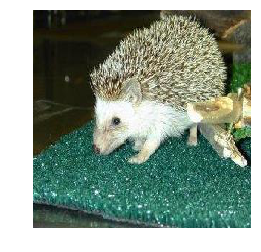

at distance 143.31905842328285:
(Class: hedgehog)
at distance 300.21338037058325:
(Class: hedgehog)
at distance 307.1906818904811:
(Class: hedgehog)
at distance 310.28672305175576:
(Class: hedgehog)
at distance 310.8813349255685:
(Class: hedgehog)
5.0
============= original: =============
(Class: schooner)


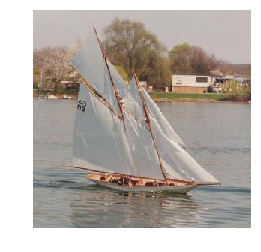

at distance 199.79557215519762:
(Class: ketch)
at distance 205.346791048849:
(Class: schooner)
at distance 208.53163532033645:
(Class: ketch)
at distance 209.8661916675864:
(Class: schooner)
at distance 213.68368057996304:
(Class: ketch)
2.0
============= original: =============
(Class: cellphone)


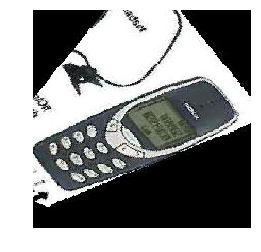

at distance 219.83609861814676:
(Class: cellphone)
at distance 241.38712661050369:
(Class: cellphone)
at distance 241.4899808564491:
(Class: cellphone)
at distance 244.48651356028978:
(Class: minaret)
at distance 245.13980512796013:
(Class: cellphone)
4.0
============= original: =============
(Class: watch)


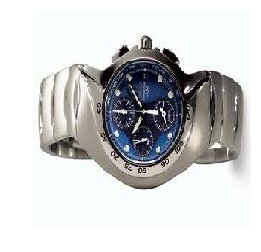

at distance 287.82002303385445:
(Class: watch)
at distance 289.60207836183804:
(Class: watch)
at distance 291.75629180609565:
(Class: watch)
at distance 292.2922382570497:
(Class: watch)
at distance 295.7159628254677:
(Class: watch)
5.0
============= original: =============
(Class: grand_piano)


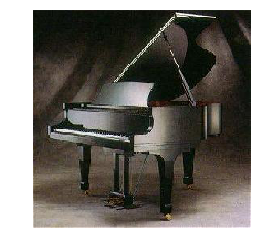

at distance 228.933465308265:
(Class: grand_piano)
at distance 245.70789119837144:
(Class: grand_piano)
at distance 246.42821626165642:
(Class: grand_piano)
at distance 259.62515659775806:
(Class: grand_piano)
at distance 264.28000631351466:
(Class: grand_piano)
5.0
============= original: =============
(Class: helicopter)


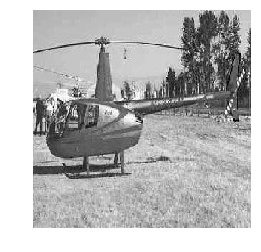

at distance 194.25153040541935:
(Class: helicopter)
at distance 194.55449731571596:
(Class: helicopter)
at distance 196.57276919250012:
(Class: car_side)
at distance 197.03509408971246:
(Class: helicopter)
at distance 197.5308711914565:
(Class: helicopter)
4.0
============= original: =============
(Class: Leopards)


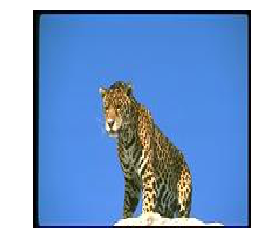

at distance 107.78235889721117:
(Class: Leopards)
at distance 192.42720392342235:
(Class: Leopards)
at distance 194.9682897732633:
(Class: Leopards)
at distance 201.8074286517509:
(Class: Leopards)
at distance 203.48035523196413:
(Class: Leopards)
5.0
============= original: =============
(Class: wheelchair)


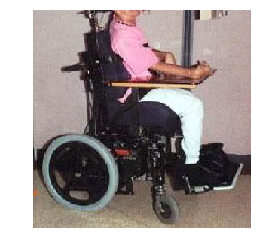

at distance 235.78032076004982:
(Class: wheelchair)
at distance 248.61447244818336:
(Class: wheelchair)
at distance 251.8276377718431:
(Class: Motorbikes)
at distance 253.8918785936316:
(Class: Motorbikes)
at distance 254.23523886135652:
(Class: wheelchair)
3.0
============= original: =============
(Class: Faces_easy)


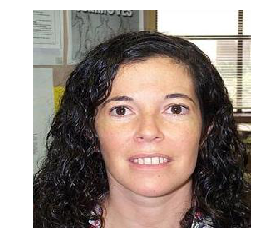

at distance 134.87031094282648:
(Class: Faces_easy)
at distance 137.84371777609093:
(Class: Faces_easy)
at distance 138.8659569392984:
(Class: Faces_easy)
at distance 139.90629879078062:
(Class: Faces_easy)
at distance 144.13827543254538:
(Class: Faces_easy)
5.0
============= original: =============
(Class: pizza)


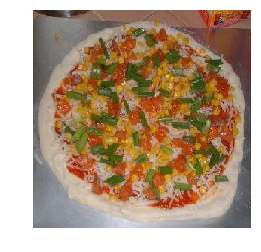

at distance 202.00816405620242:
(Class: pyramid)
at distance 206.47274628363874:
(Class: pyramid)
at distance 206.6460132878131:
(Class: Faces)
at distance 206.82252658014497:
(Class: Faces)
at distance 207.00457826648787:
(Class: Faces)
0.0
============= original: =============
(Class: brontosaurus)


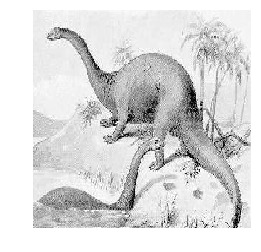

at distance 270.6739843235966:
(Class: brontosaurus)
at distance 279.5724457802799:
(Class: brontosaurus)
at distance 280.0908652106798:
(Class: brontosaurus)
at distance 284.8383387284366:
(Class: brontosaurus)
at distance 285.8442880586129:
(Class: brontosaurus)
5.0
============= original: =============
(Class: cannon)


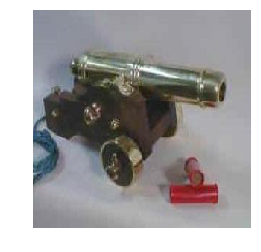

at distance 225.92621081636906:
(Class: revolver)
at distance 237.27018987088064:
(Class: helicopter)
at distance 237.72780458957334:
(Class: pyramid)
at distance 238.429814603719:
(Class: wheelchair)
at distance 239.72624177927688:
(Class: platypus)
0.0
============= original: =============
(Class: cougar_face)


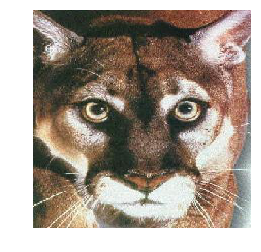

at distance 291.47992326361924:
(Class: cougar_face)
at distance 303.8597997828488:
(Class: cougar_face)
at distance 316.0675560236517:
(Class: cougar_face)
at distance 319.1302585841563:
(Class: cougar_face)
at distance 328.18974221128974:
(Class: cougar_face)
5.0
============= original: =============
(Class: airplanes)


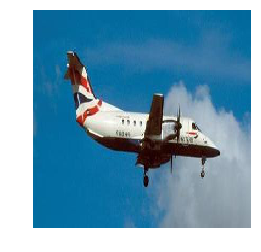

at distance 187.12429543113456:
(Class: airplanes)
at distance 195.05298465539155:
(Class: airplanes)
at distance 197.88594338467917:
(Class: airplanes)
at distance 202.60409659184464:
(Class: airplanes)
at distance 203.67877373032084:
(Class: airplanes)
5.0
============= original: =============
(Class: airplanes)


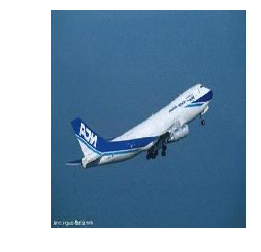

at distance 184.0890763167685:
(Class: airplanes)
at distance 193.5017678485646:
(Class: airplanes)
at distance 199.49571164471865:
(Class: airplanes)
at distance 199.74190903176722:
(Class: airplanes)
at distance 205.30783801097746:
(Class: airplanes)
5.0
============= original: =============
(Class: airplanes)


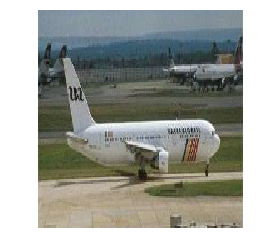

at distance 161.8875303699173:
(Class: airplanes)
at distance 162.90190287495773:
(Class: airplanes)
at distance 169.8975475506302:
(Class: airplanes)
at distance 170.99579346932794:
(Class: airplanes)
at distance 171.30256882691316:
(Class: airplanes)
5.0
============= original: =============
(Class: Faces)


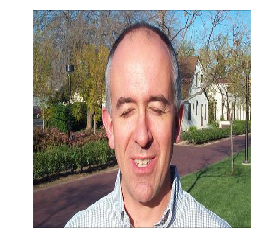

at distance 132.8211790112497:
(Class: Faces_easy)
at distance 148.58187091936284:
(Class: Faces)
at distance 150.08909731291664:
(Class: Faces)
at distance 160.01618842694128:
(Class: Faces)
at distance 160.35404165097557:
(Class: Faces)
4.0
============= original: =============
(Class: panda)


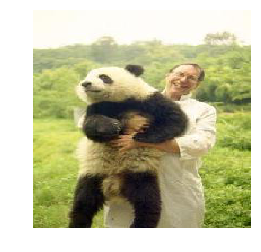

at distance 272.31092179625443:
(Class: panda)
at distance 284.2654406086824:
(Class: panda)
at distance 286.72950568809426:
(Class: bonsai)
at distance 286.8576063765265:
(Class: panda)
at distance 288.0402659347196:
(Class: pyramid)
3.0
============= original: =============
(Class: helicopter)


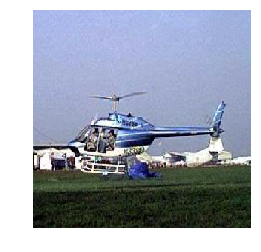

at distance 184.8544205994165:
(Class: helicopter)
at distance 201.296345163992:
(Class: helicopter)
at distance 203.50432148448596:
(Class: helicopter)
at distance 203.8198764002399:
(Class: helicopter)
at distance 204.80263065228385:
(Class: airplanes)
4.0
============= original: =============
(Class: euphonium)


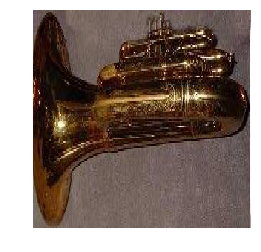

at distance 236.02759058451053:
(Class: euphonium)
at distance 257.5073856821678:
(Class: euphonium)
at distance 263.50283650691966:
(Class: wrench)
at distance 264.62148789051304:
(Class: wrench)
at distance 265.7729538408533:
(Class: wrench)
2.0
============= original: =============
(Class: trilobite)


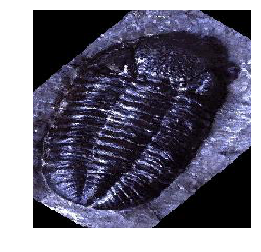

at distance 219.02368255216183:
(Class: trilobite)
at distance 246.4008048684705:
(Class: trilobite)
at distance 246.40537150300088:
(Class: trilobite)
at distance 251.64066377260454:
(Class: trilobite)
at distance 252.89484571480153:
(Class: trilobite)
5.0
============= original: =============
(Class: airplanes)


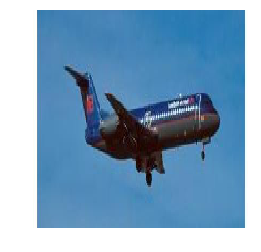

at distance 162.22941798790401:
(Class: airplanes)
at distance 165.60733398752976:
(Class: airplanes)
at distance 174.18250665744623:
(Class: airplanes)
at distance 175.3809963076848:
(Class: airplanes)
at distance 175.9281818582974:
(Class: airplanes)
5.0
============= original: =============
(Class: Faces_easy)


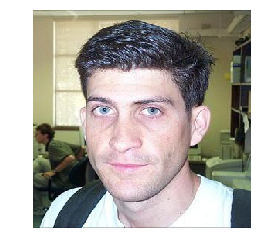

at distance 139.2655627617695:
(Class: Faces_easy)
at distance 142.39565358435829:
(Class: Faces_easy)
at distance 143.8731135794016:
(Class: Faces_easy)
at distance 144.30169083267108:
(Class: Faces_easy)
at distance 147.08272289633:
(Class: Faces_easy)
5.0
============= original: =============
(Class: Motorbikes)


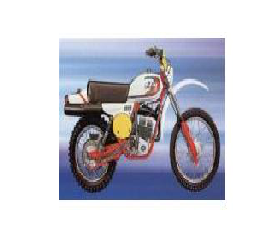

at distance 185.9956299676344:
(Class: Motorbikes)
at distance 190.91790047251666:
(Class: Motorbikes)
at distance 191.5623640009264:
(Class: Motorbikes)
at distance 195.33028965081206:
(Class: Motorbikes)
at distance 196.5643469226273:
(Class: Motorbikes)
5.0
============= original: =============
(Class: sea_horse)


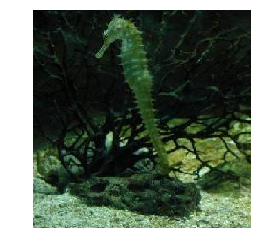

at distance 153.47388717054824:
(Class: crocodile_head)
at distance 163.59027461555846:
(Class: crab)
at distance 168.66322221329267:
(Class: starfish)
at distance 169.75562322240725:
(Class: pyramid)
at distance 170.62437231292287:
(Class: beaver)
0.0
============= original: =============
(Class: airplanes)


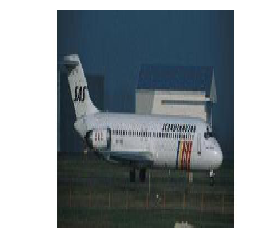

at distance 157.5061858382525:
(Class: airplanes)
at distance 158.8815703808659:
(Class: airplanes)
at distance 167.18862521008475:
(Class: airplanes)
at distance 169.7605812778624:
(Class: airplanes)
at distance 170.8616902245958:
(Class: airplanes)
5.0
============= original: =============
(Class: lotus)


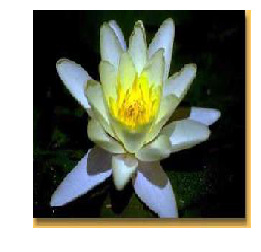

at distance 230.68744946825035:
(Class: lotus)
at distance 231.89639793665606:
(Class: lotus)
at distance 235.58897233156645:
(Class: water_lilly)
at distance 237.29172973023574:
(Class: water_lilly)
at distance 240.3910788877713:
(Class: water_lilly)
2.0
============= original: =============
(Class: Motorbikes)


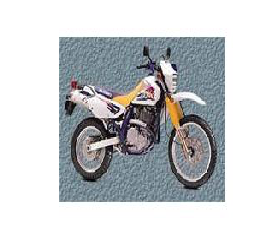

at distance 193.08920811172044:
(Class: Motorbikes)
at distance 193.3044163689666:
(Class: Motorbikes)
at distance 196.11872410514277:
(Class: Motorbikes)
at distance 201.57468256762698:
(Class: Motorbikes)
at distance 202.73836921577455:
(Class: Motorbikes)
5.0
============= original: =============
(Class: cellphone)


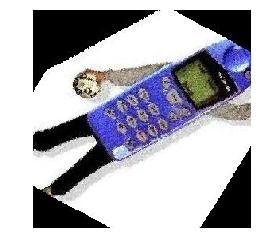

at distance 238.3612445077754:
(Class: cellphone)
at distance 244.57486392118054:
(Class: cellphone)
at distance 248.47458551976337:
(Class: cellphone)
at distance 250.25961391092466:
(Class: cellphone)
at distance 254.71932952207885:
(Class: cellphone)
5.0
============= original: =============
(Class: electric_guitar)


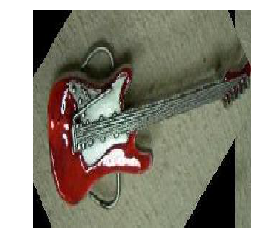

at distance 234.91277199793197:
(Class: scissors)
at distance 235.94869206761055:
(Class: scorpion)
at distance 239.29372670649533:
(Class: pyramid)
at distance 241.0485475992959:
(Class: revolver)
at distance 241.51382144873156:
(Class: electric_guitar)
1.0
============= original: =============
(Class: accordion)


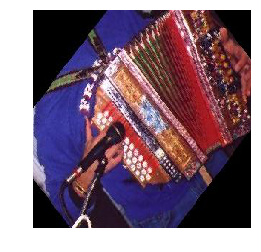

at distance 301.3649431704081:
(Class: accordion)
at distance 306.42109598489134:
(Class: accordion)
at distance 311.65072070622455:
(Class: accordion)
at distance 313.6276392252862:
(Class: accordion)
at distance 314.6938449056927:
(Class: accordion)
5.0
============= original: =============
(Class: pizza)


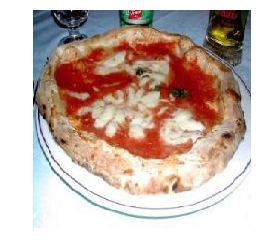

at distance 245.37533724124322:
(Class: pizza)
at distance 246.7651955940953:
(Class: pizza)
at distance 246.97930687077397:
(Class: pizza)
at distance 247.66217712767028:
(Class: pizza)
at distance 268.4386452074673:
(Class: pizza)
5.0
============= original: =============
(Class: airplanes)


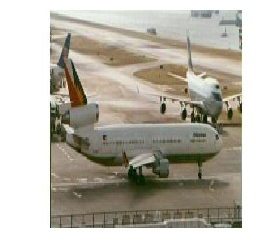

at distance 153.93671427179717:
(Class: airplanes)
at distance 162.49627084250872:
(Class: airplanes)
at distance 164.49871331939426:
(Class: airplanes)
at distance 164.64809752534566:
(Class: airplanes)
at distance 164.80192032835228:
(Class: airplanes)
5.0
============= original: =============
(Class: pizza)


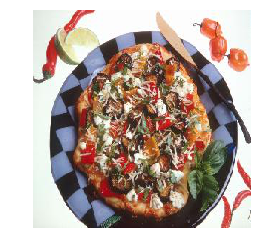

at distance 264.3095904068534:
(Class: pizza)
at distance 275.3142603130562:
(Class: pizza)
at distance 283.74638422776485:
(Class: pizza)
at distance 283.76472386263873:
(Class: buddha)
at distance 288.5828230849307:
(Class: cougar_face)
3.0
============= original: =============
(Class: watch)


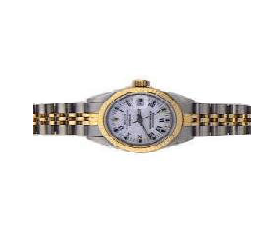

at distance 212.13540151125287:
(Class: watch)
at distance 212.1817242429677:
(Class: watch)
at distance 215.57443399538505:
(Class: watch)
at distance 233.20685007868553:
(Class: watch)
at distance 255.7654712883084:
(Class: watch)
5.0
============= original: =============
(Class: ferry)


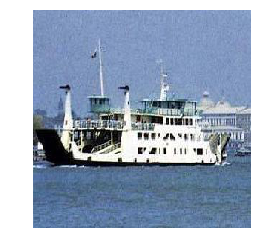

at distance 172.602606385543:
(Class: ferry)
at distance 174.17864501660677:
(Class: ferry)
at distance 182.94814578516932:
(Class: ferry)
at distance 194.24042567831083:
(Class: ferry)
at distance 197.2562906908156:
(Class: ferry)
5.0
============= original: =============
(Class: camera)


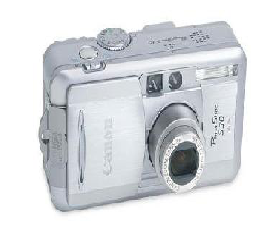

at distance 229.67000811996036:
(Class: camera)
at distance 233.2530635366733:
(Class: dollar_bill)
at distance 233.55548574817675:
(Class: camera)
at distance 233.81867034586787:
(Class: camera)
at distance 234.08363483298848:
(Class: camera)
4.0
============= original: =============
(Class: windsor_chair)


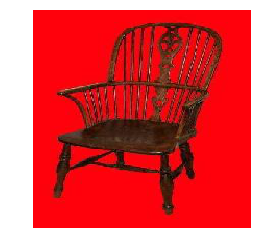

at distance 238.48458032148784:
(Class: windsor_chair)
at distance 244.14460402884853:
(Class: windsor_chair)
at distance 247.2435698851902:
(Class: windsor_chair)
at distance 248.22956629365962:
(Class: windsor_chair)
at distance 248.99699580048838:
(Class: windsor_chair)
5.0
============= original: =============
(Class: Motorbikes)


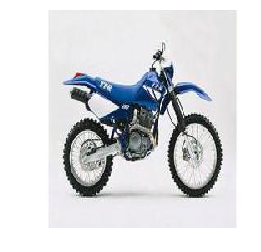

at distance 139.51572329382586:
(Class: Motorbikes)
at distance 139.95534000521872:
(Class: Motorbikes)
at distance 140.05470955804304:
(Class: Motorbikes)
at distance 141.5145557532288:
(Class: Motorbikes)
at distance 152.4689926758238:
(Class: Motorbikes)
5.0
============= original: =============
(Class: dollar_bill)


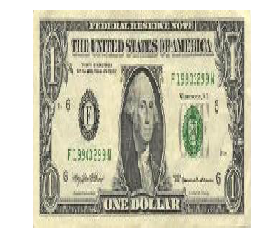

at distance 122.56392460884567:
(Class: dollar_bill)
at distance 123.80413618345861:
(Class: dollar_bill)
at distance 133.19231094773025:
(Class: dollar_bill)
at distance 138.4993026059879:
(Class: dollar_bill)
at distance 147.691657580653:
(Class: dollar_bill)
5.0
============= original: =============
(Class: crab)


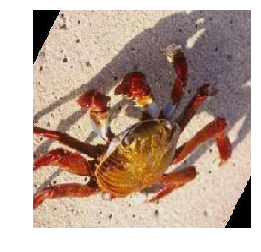

at distance 324.538966997716:
(Class: crab)
at distance 329.06770940294825:
(Class: crab)
at distance 333.743560407734:
(Class: scorpion)
at distance 335.1266323387915:
(Class: crab)
at distance 336.85636936632545:
(Class: crab)
4.0
============= original: =============
(Class: Motorbikes)


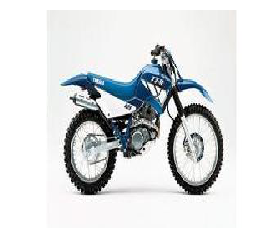

at distance 139.51572329382586:
(Class: Motorbikes)
at distance 158.79594506207624:
(Class: Motorbikes)
at distance 161.20307561042864:
(Class: Motorbikes)
at distance 162.06938014827205:
(Class: Motorbikes)
at distance 163.30108723169866:
(Class: Motorbikes)
5.0
============= original: =============
(Class: cannon)


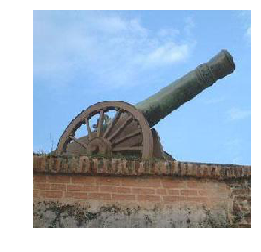

at distance 230.70832948708548:
(Class: cannon)
at distance 239.5533214536265:
(Class: pyramid)
at distance 245.22224036664915:
(Class: bonsai)
at distance 245.3036898303066:
(Class: pyramid)
at distance 245.8950532381815:
(Class: joshua_tree)
1.0
============= original: =============
(Class: airplanes)


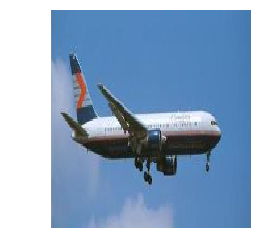

at distance 116.694884075552:
(Class: airplanes)
at distance 131.34725624375957:
(Class: airplanes)
at distance 136.3824148376853:
(Class: airplanes)
at distance 137.23757068673086:
(Class: airplanes)
at distance 139.0501303602256:
(Class: airplanes)
5.0
============= original: =============
(Class: sunflower)


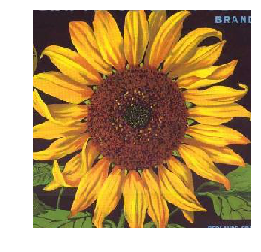

at distance 246.96295576838793:
(Class: sunflower)
at distance 248.88770369687322:
(Class: sunflower)
at distance 250.5046327296565:
(Class: sunflower)
at distance 254.7275212990779:
(Class: sunflower)
at distance 258.88501931743843:
(Class: sunflower)
5.0
============= original: =============
(Class: rhino)


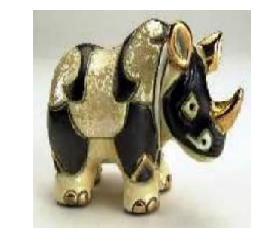

at distance 273.46060518106344:
(Class: cougar_face)
at distance 274.97609782677085:
(Class: cougar_face)
at distance 275.5456095963212:
(Class: helicopter)
at distance 276.2300146502099:
(Class: butterfly)
at distance 276.45831084319815:
(Class: metronome)
0.0
============= original: =============
(Class: airplanes)


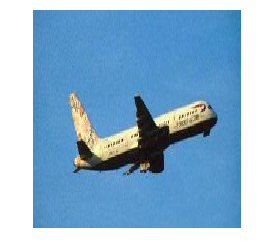

at distance 179.7691448567571:
(Class: airplanes)
at distance 184.52187375210121:
(Class: airplanes)
at distance 187.99625135543766:
(Class: airplanes)
at distance 189.79208244894372:
(Class: airplanes)
at distance 190.44119746094515:
(Class: airplanes)
5.0
============= original: =============
(Class: airplanes)


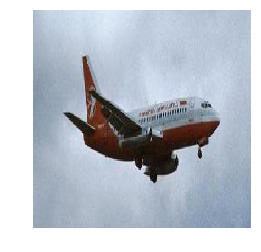

at distance 217.16744140741764:
(Class: airplanes)
at distance 218.01128671164548:
(Class: airplanes)
at distance 219.45136354118952:
(Class: airplanes)
at distance 221.96573394038478:
(Class: airplanes)
at distance 222.1220789087443:
(Class: airplanes)
5.0
============= original: =============
(Class: watch)


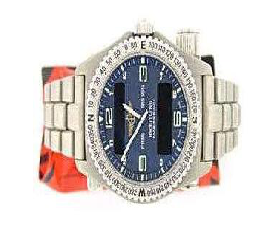

at distance 128.3681627529707:
(Class: watch)
at distance 226.8665701162061:
(Class: watch)
at distance 236.77176078218108:
(Class: watch)
at distance 244.11905853265708:
(Class: watch)
at distance 244.30873268317004:
(Class: watch)
5.0
============= original: =============
(Class: airplanes)


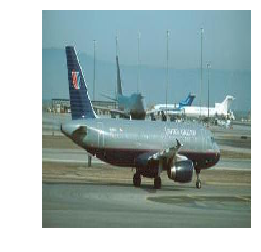

at distance 173.99006421981372:
(Class: airplanes)
at distance 183.00869911445503:
(Class: airplanes)
at distance 183.63220029435237:
(Class: airplanes)
at distance 186.94284294693543:
(Class: airplanes)
at distance 187.3362978196211:
(Class: airplanes)
5.0
============= original: =============
(Class: ceiling_fan)


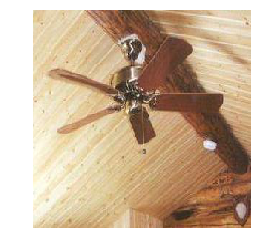

at distance 262.63682852763543:
(Class: ceiling_fan)
at distance 267.74793813435036:
(Class: ceiling_fan)
at distance 268.76723951117566:
(Class: ceiling_fan)
at distance 273.0188137097662:
(Class: ceiling_fan)
at distance 273.0931989465122:
(Class: ceiling_fan)
5.0
============= original: =============
(Class: airplanes)


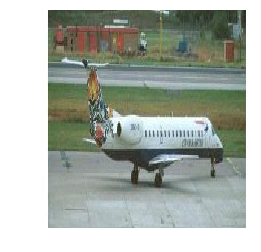

at distance 162.92177231725188:
(Class: airplanes)
at distance 163.59144333526876:
(Class: airplanes)
at distance 165.36844553863048:
(Class: airplanes)
at distance 165.58752084546833:
(Class: airplanes)
at distance 165.8888584855643:
(Class: airplanes)
5.0
============= original: =============
(Class: airplanes)


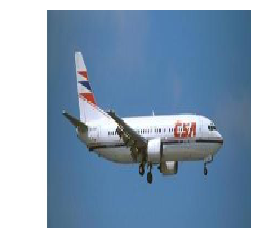

at distance 143.839307988486:
(Class: airplanes)
at distance 146.8066499341058:
(Class: airplanes)
at distance 148.23499726533475:
(Class: airplanes)
at distance 148.34835436793614:
(Class: airplanes)
at distance 149.89594385974448:
(Class: airplanes)
5.0
============= original: =============
(Class: dalmatian)


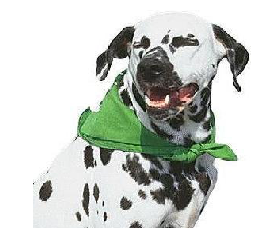

at distance 291.78415096191947:
(Class: dalmatian)
at distance 296.9568027952172:
(Class: dalmatian)
at distance 300.5192650188224:
(Class: dalmatian)
at distance 300.7286348755845:
(Class: dalmatian)
at distance 301.2482256002733:
(Class: dalmatian)
5.0
============= original: =============
(Class: hawksbill)


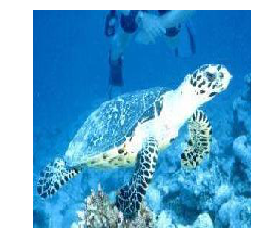

at distance 215.92729630136472:
(Class: hawksbill)
at distance 216.14188254846837:
(Class: hawksbill)
at distance 232.4436053011979:
(Class: hawksbill)
at distance 235.91241911509437:
(Class: hawksbill)
at distance 244.58246522126518:
(Class: hawksbill)
5.0
============= original: =============
(Class: elephant)


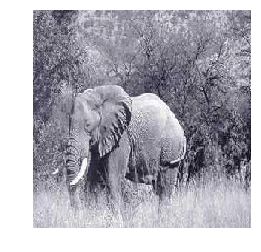

at distance 210.9464264849543:
(Class: rhino)
at distance 218.52290220221386:
(Class: joshua_tree)
at distance 227.9093335872925:
(Class: joshua_tree)
at distance 228.75437269136896:
(Class: joshua_tree)
at distance 231.61286422936368:
(Class: rhino)
0.0
============= original: =============
(Class: llama)


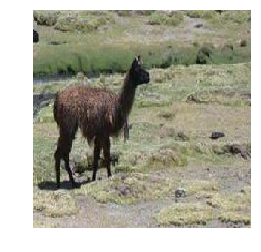

at distance 275.23251460724185:
(Class: llama)
at distance 296.05852554935035:
(Class: llama)
at distance 303.8163784321944:
(Class: emu)
at distance 311.12798176607345:
(Class: llama)
at distance 311.8867037690996:
(Class: llama)
4.0
============= original: =============
(Class: airplanes)


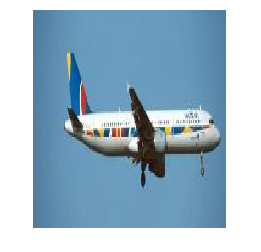

at distance 141.78094091167156:
(Class: airplanes)
at distance 145.5900753252315:
(Class: airplanes)
at distance 172.14537486237094:
(Class: airplanes)
at distance 173.30272083176737:
(Class: airplanes)
at distance 174.14734096669673:
(Class: airplanes)
5.0
============= original: =============
(Class: ketch)


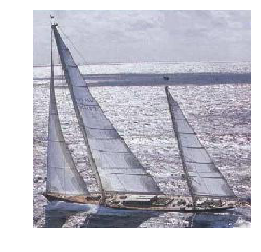

at distance 218.17032720070486:
(Class: ketch)
at distance 221.4675626094329:
(Class: pyramid)
at distance 222.7057703740685:
(Class: schooner)
at distance 222.79616426217018:
(Class: pyramid)
at distance 226.35861316442796:
(Class: ketch)
2.0
============= original: =============
(Class: Motorbikes)


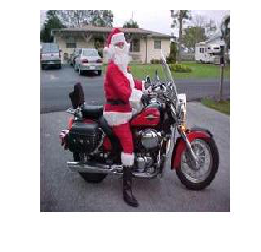

at distance 209.58409937478987:
(Class: Motorbikes)
at distance 212.4522693239837:
(Class: Motorbikes)
at distance 217.75199914998282:
(Class: Motorbikes)
at distance 218.24466791977068:
(Class: Motorbikes)
at distance 218.98002126894394:
(Class: Motorbikes)
5.0
============= original: =============
(Class: Faces)


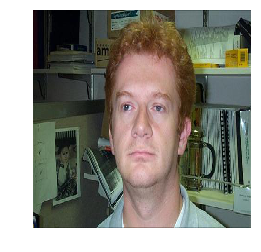

at distance 135.63807749563625:
(Class: Faces_easy)
at distance 136.47621287042037:
(Class: Faces_easy)
at distance 142.26904611065854:
(Class: Faces)
at distance 145.96572990079278:
(Class: Faces)
at distance 147.41565928745942:
(Class: Faces_easy)
2.0
============= original: =============
(Class: Motorbikes)


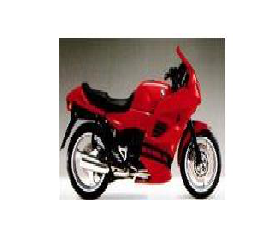

at distance 191.96241166552625:
(Class: Motorbikes)
at distance 209.313498246154:
(Class: Motorbikes)
at distance 220.55765204864514:
(Class: Motorbikes)
at distance 221.26529844986163:
(Class: Motorbikes)
at distance 224.4470708516769:
(Class: Motorbikes)
5.0
============= original: =============
(Class: starfish)


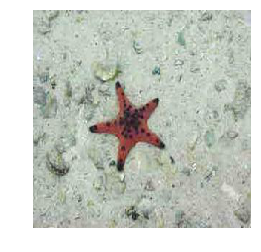

at distance 232.9543957160011:
(Class: starfish)
at distance 235.91367765339066:
(Class: starfish)
at distance 249.17435434098286:
(Class: starfish)
at distance 258.8584460618472:
(Class: starfish)
at distance 266.84600120823944:
(Class: starfish)
5.0
============= original: =============
(Class: Motorbikes)


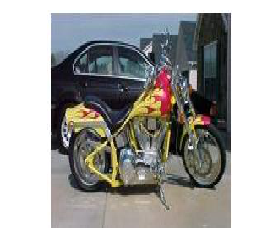

at distance 189.1173876774539:
(Class: Motorbikes)
at distance 195.25814818955197:
(Class: Motorbikes)
at distance 199.57128803570248:
(Class: Motorbikes)
at distance 201.68524937121063:
(Class: Motorbikes)
at distance 205.58109025110664:
(Class: Motorbikes)
5.0
============= original: =============
(Class: Faces)


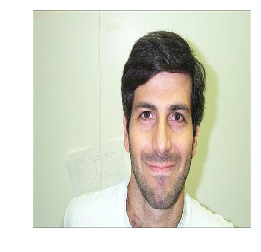

at distance 106.76989969828762:
(Class: Faces_easy)
at distance 121.0126638521285:
(Class: Faces_easy)
at distance 130.3662589869626:
(Class: Faces)
at distance 131.05125034980267:
(Class: Faces)
at distance 135.15206154924545:
(Class: Faces_easy)
2.0
============= original: =============
(Class: metronome)


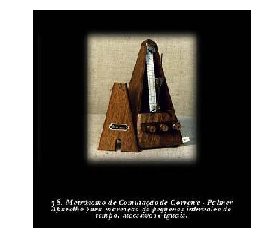

at distance 209.0029702231598:
(Class: metronome)
at distance 209.28514051345243:
(Class: pyramid)
at distance 211.57299913143044:
(Class: metronome)
at distance 214.49135251366133:
(Class: revolver)
at distance 214.6078078645626:
(Class: airplanes)
2.0
============= original: =============
(Class: ant)


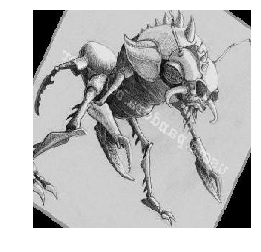

at distance 222.23528780725763:
(Class: cougar_face)
at distance 222.23580478212963:
(Class: pyramid)
at distance 222.78434669671017:
(Class: elephant)
at distance 227.43220896482958:
(Class: pyramid)
at distance 227.66247116740573:
(Class: stegosaurus)
0.0
============= original: =============
(Class: dalmatian)


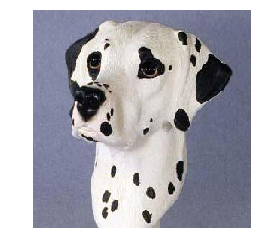

at distance 309.7294103300921:
(Class: dalmatian)
at distance 311.3549164580686:
(Class: dalmatian)
at distance 318.778790450808:
(Class: dalmatian)
at distance 324.9900032377248:
(Class: dalmatian)
at distance 328.69489283903266:
(Class: dalmatian)
5.0
============= original: =============
(Class: llama)


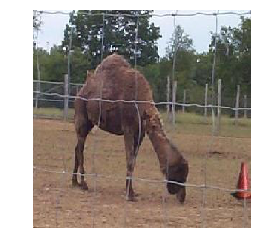

at distance 267.90807365985364:
(Class: elephant)
at distance 270.7208193925279:
(Class: elephant)
at distance 276.57709312895264:
(Class: elephant)
at distance 278.71083212057766:
(Class: elephant)
at distance 279.7555103151228:
(Class: okapi)
0.0
============= original: =============
(Class: trilobite)


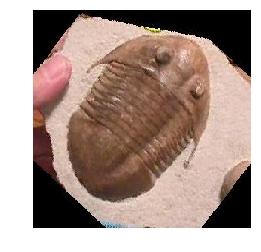

at distance 239.6775973069938:
(Class: trilobite)
at distance 246.14690335600824:
(Class: trilobite)
at distance 249.45021202379604:
(Class: trilobite)
at distance 250.26788213381687:
(Class: trilobite)
at distance 250.32526172438924:
(Class: trilobite)
5.0
============= original: =============
(Class: Motorbikes)


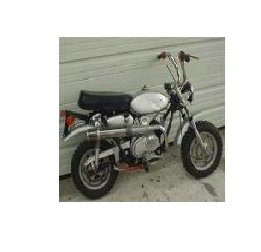

at distance 188.80669071188785:
(Class: Motorbikes)
at distance 195.7450135083615:
(Class: Motorbikes)
at distance 196.8602185140937:
(Class: Motorbikes)
at distance 199.49475046038796:
(Class: Motorbikes)
at distance 200.0328938697861:
(Class: Motorbikes)
5.0
============= original: =============
(Class: Motorbikes)


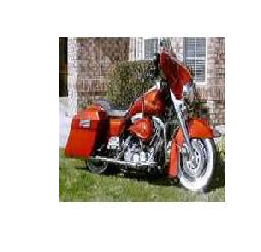

at distance 217.28072649355312:
(Class: Motorbikes)
at distance 217.50056536328023:
(Class: Motorbikes)
at distance 218.27085028405364:
(Class: Motorbikes)
at distance 219.51658135310845:
(Class: Motorbikes)
at distance 221.43573429767537:
(Class: Motorbikes)
5.0
============= original: =============
(Class: euphonium)


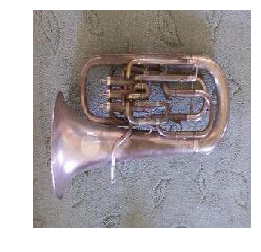

at distance 242.92311193357224:
(Class: euphonium)
at distance 247.66858009171534:
(Class: euphonium)
at distance 256.0004769175095:
(Class: euphonium)
at distance 260.7615678306886:
(Class: euphonium)
at distance 265.3965650163957:
(Class: euphonium)
5.0
============= original: =============
(Class: flamingo)


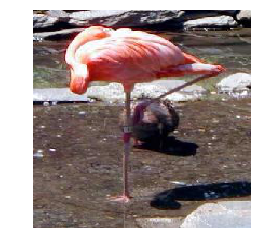

at distance 277.14744797994535:
(Class: flamingo)
at distance 279.29537253960916:
(Class: flamingo)
at distance 280.6491990728137:
(Class: flamingo)
at distance 281.84657151193267:
(Class: flamingo)
at distance 283.45821168872817:
(Class: flamingo)
5.0
============= original: =============
(Class: ferry)


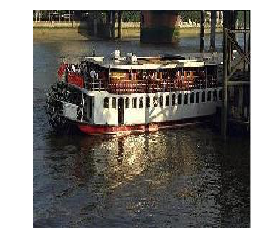

at distance 255.08642355069716:
(Class: ferry)
at distance 260.6960238074992:
(Class: ferry)
at distance 266.7052104975759:
(Class: ferry)
at distance 267.10565504336637:
(Class: ferry)
at distance 267.7697813279754:
(Class: ferry)
5.0
============= original: =============
(Class: chandelier)


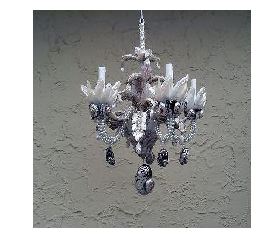

at distance 241.27779039615012:
(Class: chandelier)
at distance 246.39816352074507:
(Class: ceiling_fan)
at distance 248.18346268005817:
(Class: strawberry)
at distance 248.68594562273046:
(Class: pyramid)
at distance 250.80085569995973:
(Class: crab)
1.0
============= original: =============
(Class: wheelchair)


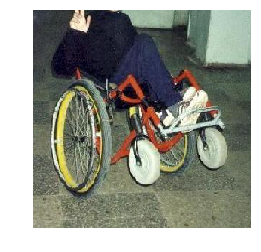

at distance 294.59672457292464:
(Class: Motorbikes)
at distance 297.13046117573305:
(Class: Motorbikes)
at distance 298.93495378187436:
(Class: Motorbikes)
at distance 299.86115769442574:
(Class: Motorbikes)
at distance 300.53155894905916:
(Class: Motorbikes)
0.0
============= original: =============
(Class: Motorbikes)


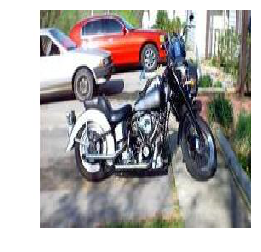

at distance 198.3001345137478:
(Class: Motorbikes)
at distance 218.46126551413855:
(Class: Motorbikes)
at distance 221.4764014548364:
(Class: Motorbikes)
at distance 221.53713058848714:
(Class: Motorbikes)
at distance 222.2948688687476:
(Class: Motorbikes)
5.0
============= original: =============
(Class: ketch)


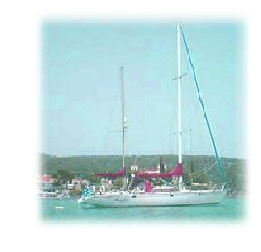

at distance 164.29273766324138:
(Class: ketch)
at distance 179.5524719366279:
(Class: pyramid)
at distance 181.32776117028936:
(Class: ketch)
at distance 182.46434998036045:
(Class: ketch)
at distance 185.13087017280705:
(Class: ketch)
4.0
============= original: =============
(Class: watch)


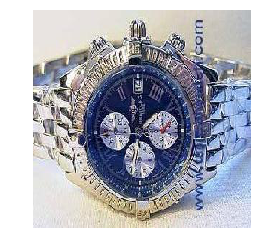

at distance 242.04196028744332:
(Class: watch)
at distance 255.97354891923334:
(Class: watch)
at distance 282.2706823583297:
(Class: watch)
at distance 282.3930097173742:
(Class: watch)
at distance 284.22485514724366:
(Class: watch)
5.0
============= original: =============
(Class: airplanes)


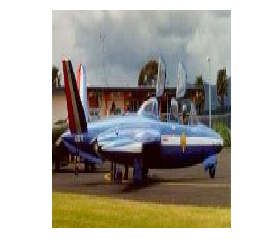

at distance 180.75602730086496:
(Class: airplanes)
at distance 187.4656869627524:
(Class: airplanes)
at distance 190.1583366585409:
(Class: airplanes)
at distance 191.26992247810455:
(Class: airplanes)
at distance 192.80051808782446:
(Class: airplanes)
5.0
##########################################################################################
################################# caltech101_VGG16_fc2.p #################################
Query results
============= original: =============
(Class: tick)


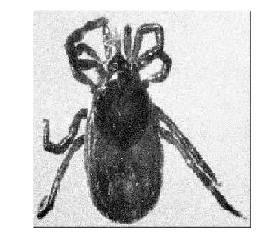

at distance 77.12784360728695:
(Class: tick)
at distance 78.28907824427708:
(Class: tick)
at distance 79.75457660595316:
(Class: tick)
at distance 81.7488231333908:
(Class: tick)
at distance 82.07303264602687:
(Class: tick)
5.0
============= original: =============
(Class: ketch)


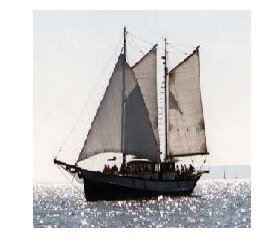

at distance 46.57570926081991:
(Class: schooner)
at distance 48.0237830277462:
(Class: schooner)
at distance 49.64692371176367:
(Class: schooner)
at distance 49.73686354851926:
(Class: ketch)
at distance 49.80095403062324:
(Class: schooner)
1.0
============= original: =============
(Class: hawksbill)


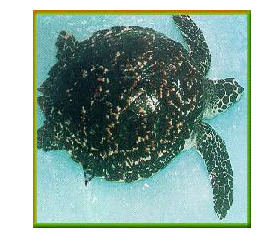

at distance 68.60832562326556:
(Class: sea_horse)
at distance 76.80420905579022:
(Class: stegosaurus)
at distance 77.37189999392457:
(Class: stegosaurus)
at distance 79.31386652636411:
(Class: joshua_tree)
at distance 80.16696703206809:
(Class: hawksbill)
1.0
============= original: =============
(Class: Leopards)


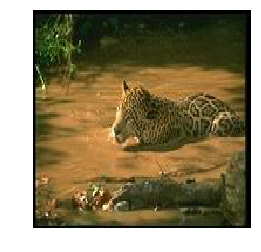

at distance 29.037683570905156:
(Class: Leopards)
at distance 64.34729990143613:
(Class: Leopards)
at distance 64.81728288163976:
(Class: Leopards)
at distance 65.54792308897912:
(Class: Leopards)
at distance 66.15035452747392:
(Class: Leopards)
5.0
============= original: =============
(Class: kangaroo)


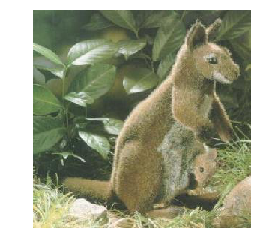

at distance 65.13680992587202:
(Class: beaver)
at distance 68.58651168121834:
(Class: kangaroo)
at distance 68.68080565361903:
(Class: wild_cat)
at distance 69.84600323244075:
(Class: beaver)
at distance 70.1971864360617:
(Class: Faces)
1.0
============= original: =============
(Class: garfield)


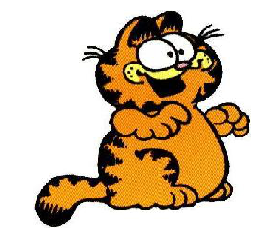

at distance 62.970697964361804:
(Class: garfield)
at distance 64.35415947188707:
(Class: garfield)
at distance 66.59186034468037:
(Class: garfield)
at distance 66.90086536512041:
(Class: garfield)
at distance 68.57715289906488:
(Class: snoopy)
4.0
============= original: =============
(Class: minaret)


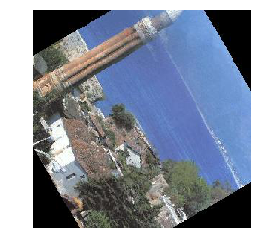

at distance 48.798372844411325:
(Class: minaret)
at distance 53.452934356380624:
(Class: minaret)
at distance 53.491692140266295:
(Class: minaret)
at distance 54.63598206431209:
(Class: minaret)
at distance 54.82865735600039:
(Class: minaret)
5.0
============= original: =============
(Class: elephant)


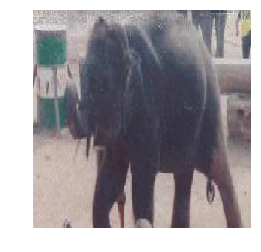

at distance 66.40557997068925:
(Class: elephant)
at distance 66.6991366267402:
(Class: elephant)
at distance 68.72554681257833:
(Class: elephant)
at distance 69.50822959338902:
(Class: rhino)
at distance 69.92558064640473:
(Class: elephant)
4.0
============= original: =============
(Class: pigeon)


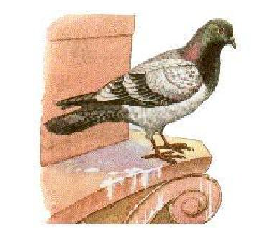

at distance 82.78057774343793:
(Class: scorpion)
at distance 83.19189710390306:
(Class: gramophone)
at distance 85.14770505702194:
(Class: buddha)
at distance 85.28389882262506:
(Class: bonsai)
at distance 86.35914867323893:
(Class: pigeon)
1.0
============= original: =============
(Class: strawberry)


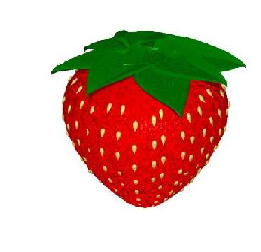

at distance 65.03006594586765:
(Class: strawberry)
at distance 65.35813963593442:
(Class: strawberry)
at distance 65.454055417923:
(Class: strawberry)
at distance 66.38666559875377:
(Class: strawberry)
at distance 68.26934326058982:
(Class: strawberry)
5.0
============= original: =============
(Class: watch)


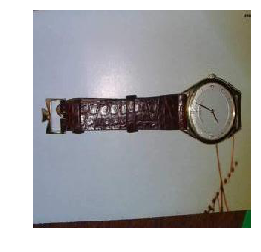

at distance 74.66994309212346:
(Class: watch)
at distance 75.92089799777955:
(Class: wrench)
at distance 76.40807388485958:
(Class: anchor)
at distance 77.6021256147461:
(Class: Faces)
at distance 77.61815129868053:
(Class: mandolin)
1.0
============= original: =============
(Class: butterfly)


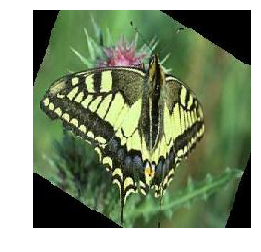

at distance 62.83662438010442:
(Class: butterfly)
at distance 63.927249925711386:
(Class: butterfly)
at distance 74.65157842405074:
(Class: butterfly)
at distance 75.49523110651964:
(Class: mayfly)
at distance 76.00203613971081:
(Class: crab)
3.0
============= original: =============
(Class: camera)


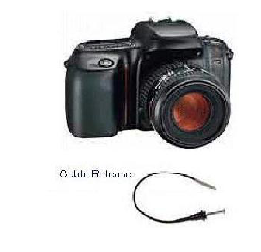

at distance 73.61745840918425:
(Class: camera)
at distance 74.25194359510512:
(Class: camera)
at distance 74.89158556744212:
(Class: camera)
at distance 75.40201042010672:
(Class: camera)
at distance 75.80904521427948:
(Class: camera)
5.0
============= original: =============
(Class: beaver)


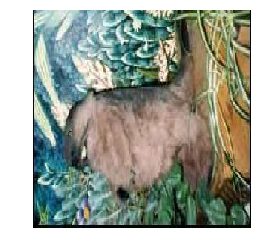

at distance 69.18237817531003:
(Class: brontosaurus)
at distance 69.22968900760957:
(Class: Leopards)
at distance 70.32243992737902:
(Class: Leopards)
at distance 70.36117065476765:
(Class: bonsai)
at distance 70.3928047402018:
(Class: sea_horse)
0.0
============= original: =============
(Class: Faces_easy)


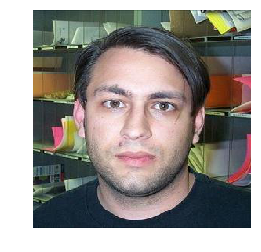

at distance 46.36740708355382:
(Class: Faces_easy)
at distance 49.324758244045185:
(Class: Faces_easy)
at distance 50.72754830667602:
(Class: Faces_easy)
at distance 50.818304271192424:
(Class: Faces_easy)
at distance 50.86732783983916:
(Class: Faces_easy)
5.0
============= original: =============
(Class: menorah)


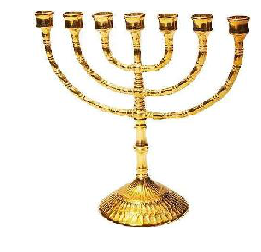

at distance 52.926009327425376:
(Class: menorah)
at distance 77.5325664656319:
(Class: menorah)
at distance 78.17098155451583:
(Class: menorah)
at distance 79.198088579594:
(Class: menorah)
at distance 79.42336554011979:
(Class: menorah)
5.0
============= original: =============
(Class: brain)


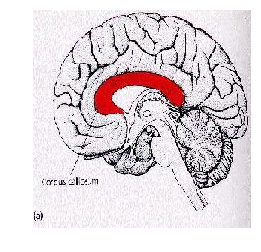

at distance 74.8920136373542:
(Class: brain)
at distance 76.76138845168907:
(Class: snoopy)
at distance 77.53973727816711:
(Class: yin_yang)
at distance 77.8182787365981:
(Class: brain)
at distance 78.19036368863905:
(Class: garfield)
2.0
============= original: =============
(Class: flamingo)


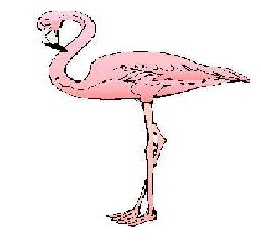

at distance 73.0881257845607:
(Class: flamingo)
at distance 76.23882384801898:
(Class: menorah)
at distance 77.31436108999084:
(Class: cougar_face)
at distance 78.30043366822339:
(Class: umbrella)
at distance 78.44195416714403:
(Class: octopus)
1.0
============= original: =============
(Class: chair)


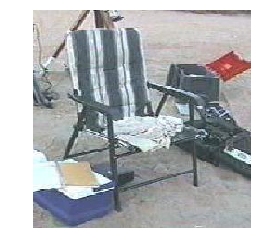

at distance 67.40472568392589:
(Class: chair)
at distance 68.41179536253289:
(Class: wheelchair)
at distance 69.66579833455783:
(Class: laptop)
at distance 70.30612210686357:
(Class: chair)
at distance 70.68570454105374:
(Class: barrel)
2.0
============= original: =============
(Class: Faces_easy)


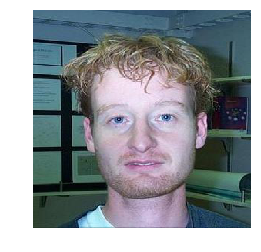

at distance 33.77825086973251:
(Class: Faces)
at distance 37.45599908498822:
(Class: Faces_easy)
at distance 37.86323691690514:
(Class: Faces_easy)
at distance 38.123166785397395:
(Class: Faces_easy)
at distance 38.282270471303576:
(Class: Faces)
3.0
============= original: =============
(Class: watch)


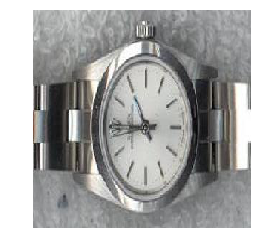

at distance 59.25989098878031:
(Class: watch)
at distance 60.157374514471854:
(Class: watch)
at distance 60.7510783505464:
(Class: watch)
at distance 60.85260553060423:
(Class: watch)
at distance 62.12383160744364:
(Class: watch)
5.0
============= original: =============
(Class: Motorbikes)


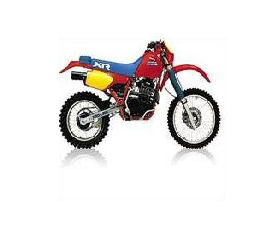

at distance 43.64024361733287:
(Class: Motorbikes)
at distance 44.978649527544654:
(Class: Motorbikes)
at distance 45.22655846450553:
(Class: Motorbikes)
at distance 47.14279060658331:
(Class: Motorbikes)
at distance 48.56998963456352:
(Class: Motorbikes)
5.0
============= original: =============
(Class: stegosaurus)


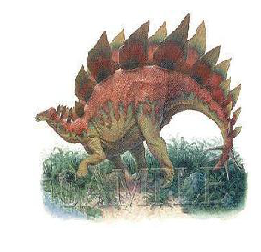

at distance 70.2344571661904:
(Class: stegosaurus)
at distance 70.45978647039331:
(Class: stegosaurus)
at distance 73.18656239942187:
(Class: stegosaurus)
at distance 76.58946284515996:
(Class: stegosaurus)
at distance 76.82972535632528:
(Class: stegosaurus)
5.0
============= original: =============
(Class: flamingo_head)


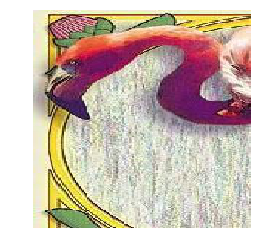

at distance 86.53962318520658:
(Class: watch)
at distance 87.86482835345109:
(Class: flamingo)
at distance 89.51395343009966:
(Class: gramophone)
at distance 90.40107250723234:
(Class: buddha)
at distance 90.56122188168474:
(Class: electric_guitar)
0.0
============= original: =============
(Class: bass)


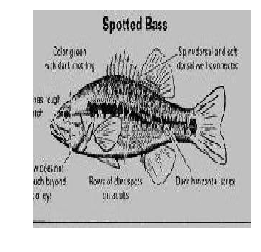

at distance 42.85079469583046:
(Class: bass)
at distance 50.48689323898191:
(Class: bass)
at distance 58.68802414428615:
(Class: cannon)
at distance 64.10709499905605:
(Class: snoopy)
at distance 66.98293860051407:
(Class: brain)
2.0
============= original: =============
(Class: mayfly)


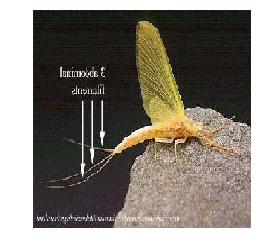

at distance 71.73177008003219:
(Class: scorpion)
at distance 72.86969899401585:
(Class: mayfly)
at distance 75.20361888261291:
(Class: joshua_tree)
at distance 75.97488948771714:
(Class: starfish)
at distance 76.73181354191331:
(Class: mayfly)
2.0
============= original: =============
(Class: lobster)


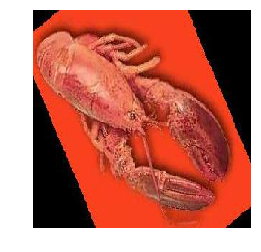

at distance 76.65553150426938:
(Class: headphone)
at distance 78.03237998134081:
(Class: pagoda)
at distance 79.4467778813646:
(Class: octopus)
at distance 79.8451803360824:
(Class: rooster)
at distance 80.70279791494075:
(Class: Faces)
0.0
============= original: =============
(Class: airplanes)


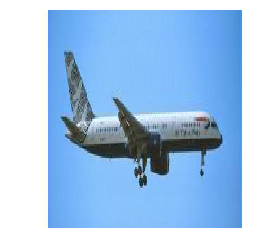

at distance 39.52299521794664:
(Class: airplanes)
at distance 40.838608778562346:
(Class: airplanes)
at distance 43.95162659320683:
(Class: airplanes)
at distance 45.153303109864254:
(Class: airplanes)
at distance 45.27519291793524:
(Class: airplanes)
5.0
============= original: =============
(Class: Leopards)


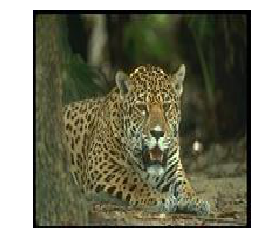

at distance 25.40768932333106:
(Class: Leopards)
at distance 46.29719876647349:
(Class: Leopards)
at distance 47.08483818330124:
(Class: Leopards)
at distance 47.721094611203895:
(Class: Leopards)
at distance 50.35739495790066:
(Class: Leopards)
5.0
============= original: =============
(Class: umbrella)


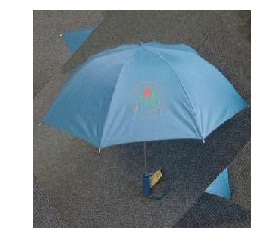

at distance 53.42777995425349:
(Class: umbrella)
at distance 58.11245003794891:
(Class: umbrella)
at distance 59.27816596037001:
(Class: umbrella)
at distance 60.49945280845881:
(Class: umbrella)
at distance 65.18875623770684:
(Class: umbrella)
5.0
============= original: =============
(Class: tick)


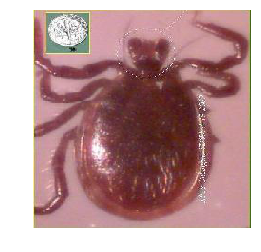

at distance 75.96757603121218:
(Class: octopus)
at distance 79.94150761905388:
(Class: tick)
at distance 80.40286017046242:
(Class: tick)
at distance 80.5382676111055:
(Class: strawberry)
at distance 81.45109028341048:
(Class: crab)
2.0
============= original: =============
(Class: airplanes)


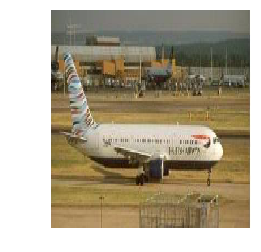

at distance 40.375968107279355:
(Class: airplanes)
at distance 46.0587546425542:
(Class: airplanes)
at distance 46.44686297137713:
(Class: airplanes)
at distance 47.280941252688194:
(Class: airplanes)
at distance 47.678729884458704:
(Class: airplanes)
5.0
============= original: =============
(Class: ketch)


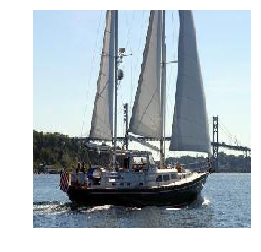

at distance 52.51768833639349:
(Class: ketch)
at distance 53.28245224538497:
(Class: ketch)
at distance 55.50742460428891:
(Class: ketch)
at distance 55.75895986944391:
(Class: ketch)
at distance 57.58638433538303:
(Class: ketch)
5.0
============= original: =============
(Class: lotus)


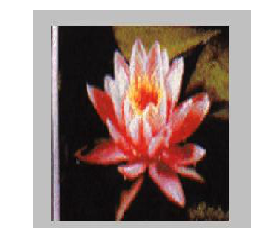

at distance 71.29844624214839:
(Class: lotus)
at distance 71.90353912105043:
(Class: butterfly)
at distance 72.27914014582989:
(Class: lotus)
at distance 72.28192757477018:
(Class: sunflower)
at distance 72.56193635730092:
(Class: water_lilly)
2.0
============= original: =============
(Class: ewer)


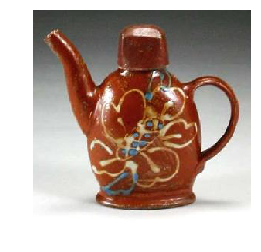

at distance 76.53941221895934:
(Class: ewer)
at distance 77.41403093133356:
(Class: ewer)
at distance 79.09939097958573:
(Class: ewer)
at distance 80.9802268669023:
(Class: ewer)
at distance 81.37316115364641:
(Class: ewer)
5.0
============= original: =============
(Class: airplanes)


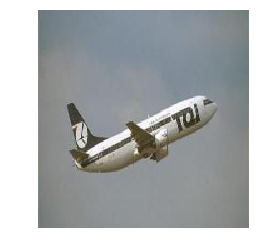

at distance 51.22940210601012:
(Class: airplanes)
at distance 52.42533213232471:
(Class: airplanes)
at distance 53.297696259401185:
(Class: airplanes)
at distance 53.54887570682998:
(Class: airplanes)
at distance 54.262968210101086:
(Class: airplanes)
5.0
============= original: =============
(Class: pigeon)


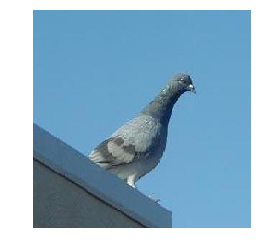

at distance 71.92276460788622:
(Class: pigeon)
at distance 72.3970636252129:
(Class: pigeon)
at distance 73.43963047620588:
(Class: pigeon)
at distance 75.52606525032253:
(Class: pigeon)
at distance 77.16662686904533:
(Class: pigeon)
5.0
============= original: =============
(Class: crab)


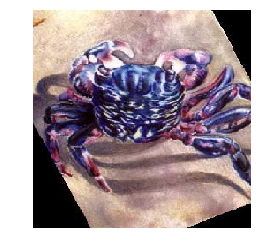

at distance 78.10073426019666:
(Class: crab)
at distance 81.25481548795918:
(Class: strawberry)
at distance 82.2441202207681:
(Class: crab)
at distance 82.62589295835684:
(Class: crab)
at distance 82.72929301734457:
(Class: crab)
4.0
============= original: =============
(Class: wild_cat)


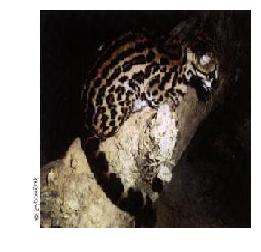

at distance 51.59921078877279:
(Class: wild_cat)
at distance 54.39379921415729:
(Class: Leopards)
at distance 54.607232619155795:
(Class: Leopards)
at distance 55.662166839852894:
(Class: wild_cat)
at distance 55.83193233299093:
(Class: wild_cat)
3.0
============= original: =============
(Class: airplanes)


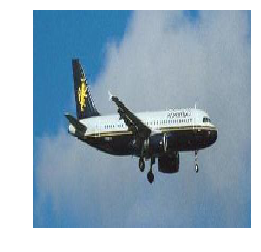

at distance 48.127396276671625:
(Class: airplanes)
at distance 48.23096736919325:
(Class: airplanes)
at distance 49.240065287543274:
(Class: airplanes)
at distance 50.95884406645996:
(Class: airplanes)
at distance 51.471799138062536:
(Class: airplanes)
5.0
============= original: =============
(Class: Faces)


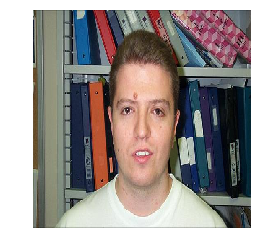

at distance 51.19274906794107:
(Class: Faces)
at distance 53.2492442224657:
(Class: Faces_easy)
at distance 53.67846200275268:
(Class: Faces)
at distance 54.317035797253475:
(Class: Faces)
at distance 54.46558534074468:
(Class: Faces)
4.0
============= original: =============
(Class: cougar_body)


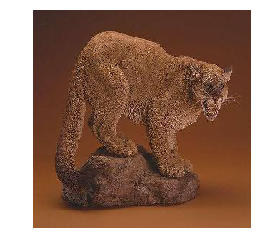

at distance 74.4799691602933:
(Class: elephant)
at distance 74.56443749553954:
(Class: bass)
at distance 76.00197521225044:
(Class: platypus)
at distance 76.4182204797057:
(Class: Leopards)
at distance 77.12965744957798:
(Class: beaver)
0.0
============= original: =============
(Class: crayfish)


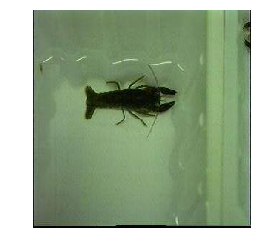

at distance 70.18111849578848:
(Class: crayfish)
at distance 78.2430372703272:
(Class: crayfish)
at distance 79.78967854936059:
(Class: scorpion)
at distance 80.20318594767028:
(Class: crayfish)
at distance 81.02313152804408:
(Class: crayfish)
4.0
============= original: =============
(Class: cup)


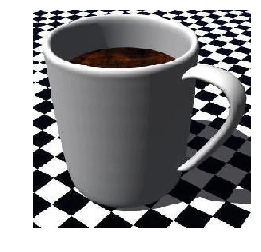

at distance 82.7928279089836:
(Class: cup)
at distance 83.74086572046293:
(Class: cup)
at distance 84.33620443443708:
(Class: cup)
at distance 86.59747001577149:
(Class: cup)
at distance 89.32416946348987:
(Class: cup)
5.0
============= original: =============
(Class: garfield)


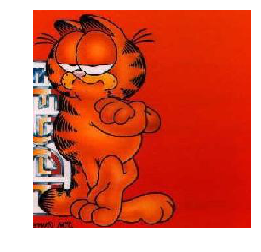

at distance 52.27822388386349:
(Class: snoopy)
at distance 52.82016162405867:
(Class: snoopy)
at distance 53.813771159953646:
(Class: garfield)
at distance 55.41238597933462:
(Class: garfield)
at distance 57.03243905497995:
(Class: garfield)
3.0
============= original: =============
(Class: airplanes)


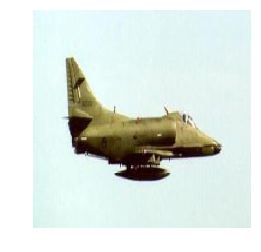

at distance 57.43573137838272:
(Class: airplanes)
at distance 59.67367461015698:
(Class: airplanes)
at distance 59.83036832574147:
(Class: airplanes)
at distance 60.75079835882764:
(Class: airplanes)
at distance 60.81854515887661:
(Class: airplanes)
5.0
============= original: =============
(Class: headphone)


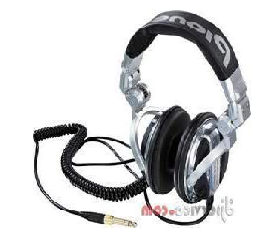

at distance 65.1394346677275:
(Class: headphone)
at distance 69.20346023557757:
(Class: headphone)
at distance 70.54514879566685:
(Class: headphone)
at distance 70.6623833688121:
(Class: headphone)
at distance 71.82270463050891:
(Class: headphone)
5.0
============= original: =============
(Class: wheelchair)


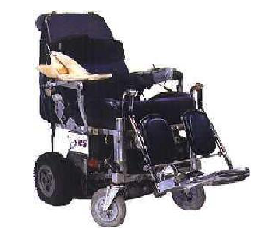

at distance 61.02304154451553:
(Class: wheelchair)
at distance 61.82996342069468:
(Class: wheelchair)
at distance 66.85172569440162:
(Class: Motorbikes)
at distance 67.89438507724954:
(Class: Motorbikes)
at distance 68.0559061604972:
(Class: Motorbikes)
2.0
============= original: =============
(Class: rooster)


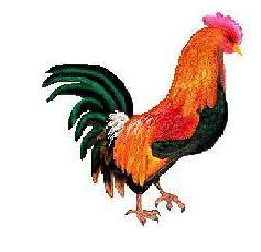

at distance 73.17472664723283:
(Class: rooster)
at distance 75.57497335844734:
(Class: rooster)
at distance 83.29546605965612:
(Class: rooster)
at distance 84.40384179832353:
(Class: rooster)
at distance 84.75775956134846:
(Class: rooster)
5.0
============= original: =============
(Class: Faces)


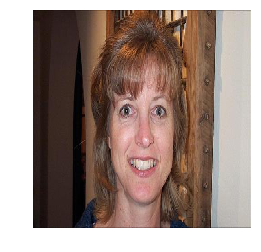

at distance 31.18793705326372:
(Class: Faces_easy)
at distance 36.687641342254494:
(Class: Faces)
at distance 37.37796933023362:
(Class: Faces)
at distance 37.69440725503042:
(Class: Faces)
at distance 38.719186056088596:
(Class: Faces)
4.0
============= original: =============
(Class: airplanes)


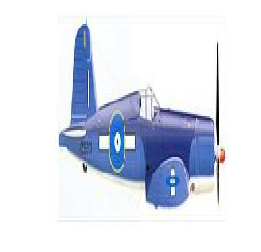

at distance 79.57978002607777:
(Class: airplanes)
at distance 80.59404933002476:
(Class: airplanes)
at distance 82.13409729433234:
(Class: airplanes)
at distance 82.52898035603452:
(Class: airplanes)
at distance 83.07615772217677:
(Class: airplanes)
5.0
============= original: =============
(Class: Motorbikes)


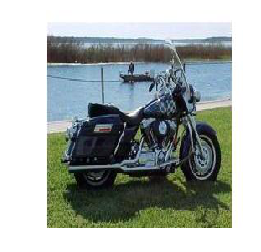

at distance 27.99247522634027:
(Class: Motorbikes)
at distance 48.15232066521111:
(Class: Motorbikes)
at distance 49.617990689026314:
(Class: Motorbikes)
at distance 50.89626151537625:
(Class: Motorbikes)
at distance 51.268901557465604:
(Class: Motorbikes)
5.0
============= original: =============
(Class: cannon)


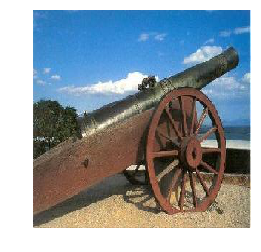

at distance 80.59082855961007:
(Class: cannon)
at distance 82.70159878894393:
(Class: cannon)
at distance 83.00594797895353:
(Class: cannon)
at distance 83.6388726310323:
(Class: cannon)
at distance 84.70210884076917:
(Class: cannon)
5.0
============= original: =============
(Class: airplanes)


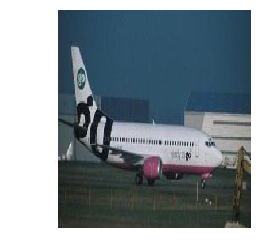

at distance 38.68713511212018:
(Class: airplanes)
at distance 44.73023827527484:
(Class: airplanes)
at distance 47.67684686304614:
(Class: airplanes)
at distance 48.06187354530871:
(Class: airplanes)
at distance 48.34854439839372:
(Class: airplanes)
5.0
============= original: =============
(Class: airplanes)


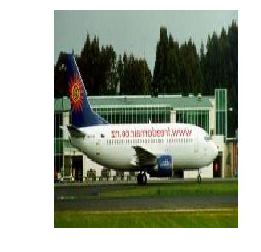

at distance 42.884166218566826:
(Class: airplanes)
at distance 65.34310888305998:
(Class: airplanes)
at distance 66.40398442101613:
(Class: airplanes)
at distance 67.24844094955004:
(Class: airplanes)
at distance 67.76502610518386:
(Class: airplanes)
5.0
============= original: =============
(Class: sea_horse)


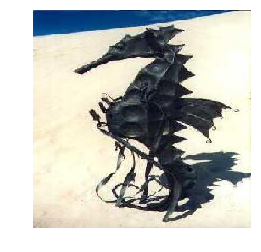

at distance 71.85898895902119:
(Class: platypus)
at distance 74.17393671545682:
(Class: ewer)
at distance 75.21197684598687:
(Class: rooster)
at distance 75.78110448996883:
(Class: chandelier)
at distance 76.2249967473338:
(Class: airplanes)
0.0
============= original: =============
(Class: cellphone)


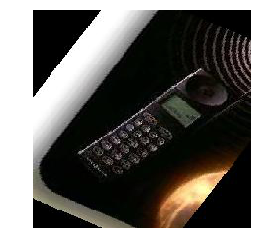

at distance 62.83340009844547:
(Class: cellphone)
at distance 66.67622759025592:
(Class: cellphone)
at distance 67.49202908407473:
(Class: cellphone)
at distance 68.54703384148631:
(Class: cellphone)
at distance 69.45847637956729:
(Class: cellphone)
5.0
============= original: =============
(Class: chair)


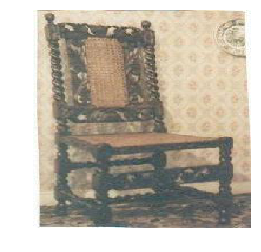

at distance 55.89041681327893:
(Class: buddha)
at distance 62.12577471023467:
(Class: menorah)
at distance 63.767629056144145:
(Class: starfish)
at distance 65.38584993204626:
(Class: chair)
at distance 66.2840592305959:
(Class: dollar_bill)
1.0
============= original: =============
(Class: Motorbikes)


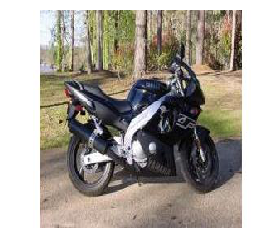

at distance 49.66189545023305:
(Class: Motorbikes)
at distance 58.2411135632706:
(Class: Motorbikes)
at distance 59.99370196176038:
(Class: Motorbikes)
at distance 60.288578179139215:
(Class: Motorbikes)
at distance 60.91867206459461:
(Class: Motorbikes)
5.0
============= original: =============
(Class: dragonfly)


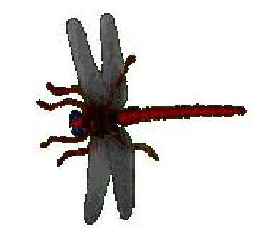

at distance 77.8429453452997:
(Class: ceiling_fan)
at distance 83.07084770862538:
(Class: airplanes)
at distance 84.23411862649519:
(Class: crayfish)
at distance 85.19311540664955:
(Class: airplanes)
at distance 85.2874531631932:
(Class: airplanes)
0.0
============= original: =============
(Class: dragonfly)


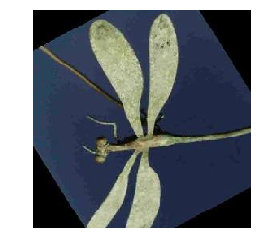

at distance 69.58948721066251:
(Class: dragonfly)
at distance 76.4212129885075:
(Class: butterfly)
at distance 77.0559340416981:
(Class: pagoda)
at distance 77.63192445337252:
(Class: rooster)
at distance 77.63206897759038:
(Class: ant)
1.0
============= original: =============
(Class: ceiling_fan)


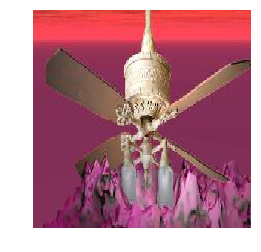

at distance 72.77611549042922:
(Class: ceiling_fan)
at distance 73.87263774998698:
(Class: chandelier)
at distance 73.93223671607468:
(Class: menorah)
at distance 75.16055639417814:
(Class: buddha)
at distance 75.16552403092041:
(Class: minaret)
1.0
============= original: =============
(Class: stop_sign)


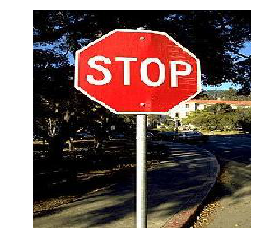

at distance 52.69976371209838:
(Class: stop_sign)
at distance 58.322351649046134:
(Class: stop_sign)
at distance 61.61007364028843:
(Class: stop_sign)
at distance 66.68636513275752:
(Class: stop_sign)
at distance 66.90663208339342:
(Class: stop_sign)
5.0
============= original: =============
(Class: airplanes)


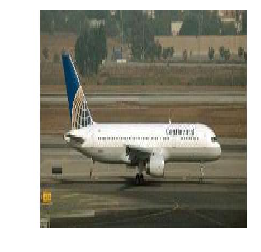

at distance 36.0370612511793:
(Class: airplanes)
at distance 42.658633219508374:
(Class: airplanes)
at distance 42.90158753847271:
(Class: airplanes)
at distance 43.30854496872444:
(Class: airplanes)
at distance 44.453259742333024:
(Class: airplanes)
5.0
============= original: =============
(Class: gerenuk)


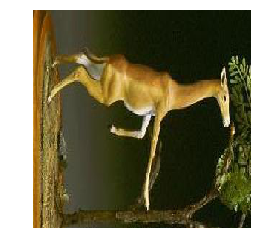

at distance 60.672925772667575:
(Class: gerenuk)
at distance 66.1205685374225:
(Class: gerenuk)
at distance 68.57956228339054:
(Class: gerenuk)
at distance 69.61573281784872:
(Class: brontosaurus)
at distance 70.10184372655594:
(Class: kangaroo)
3.0
============= original: =============
(Class: Faces_easy)


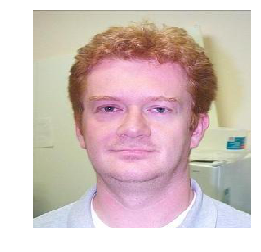

at distance 29.80195030375064:
(Class: Faces_easy)
at distance 31.82161876153511:
(Class: Faces_easy)
at distance 32.761424443210174:
(Class: Faces_easy)
at distance 33.22230240306611:
(Class: Faces_easy)
at distance 33.336794032275044:
(Class: Faces_easy)
5.0
============= original: =============
(Class: Motorbikes)


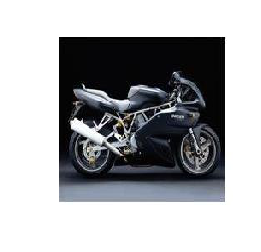

at distance 30.000815024181446:
(Class: Motorbikes)
at distance 31.06962636708604:
(Class: Motorbikes)
at distance 31.110065233169937:
(Class: Motorbikes)
at distance 44.24433690918353:
(Class: Motorbikes)
at distance 45.93710468165478:
(Class: Motorbikes)
5.0
============= original: =============
(Class: Faces)


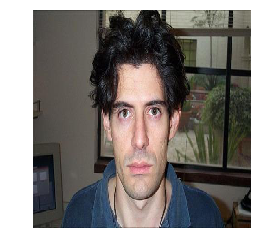

at distance 30.901301949755833:
(Class: Faces_easy)
at distance 32.75732161688053:
(Class: Faces)
at distance 33.148848662638684:
(Class: Faces_easy)
at distance 35.9087348784065:
(Class: Faces)
at distance 36.29194298565706:
(Class: Faces)
3.0
============= original: =============
(Class: wheelchair)


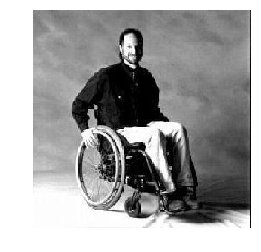

at distance 61.087573395805464:
(Class: Motorbikes)
at distance 61.928558317926814:
(Class: Motorbikes)
at distance 63.05282448129686:
(Class: wheelchair)
at distance 64.53430373568587:
(Class: wheelchair)
at distance 64.78424670951125:
(Class: Motorbikes)
2.0
============= original: =============
(Class: ibis)


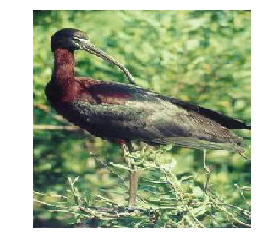

at distance 65.4130902331725:
(Class: ibis)
at distance 66.70039657056118:
(Class: ibis)
at distance 70.42084509735332:
(Class: ibis)
at distance 71.2197282733613:
(Class: ibis)
at distance 74.55320902515308:
(Class: ibis)
5.0
============= original: =============
(Class: lamp)


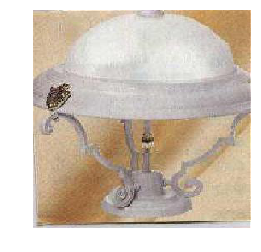

at distance 74.38743831533995:
(Class: menorah)
at distance 75.01312652826081:
(Class: lamp)
at distance 75.41581693835388:
(Class: bonsai)
at distance 75.91825223985177:
(Class: ewer)
at distance 76.3908486333939:
(Class: lamp)
2.0
============= original: =============
(Class: pizza)


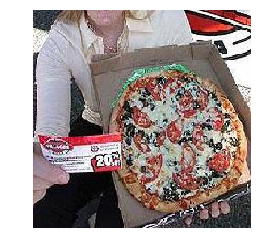

at distance 69.20888168527065:
(Class: Faces_easy)
at distance 69.55617597698865:
(Class: pizza)
at distance 71.66363989567976:
(Class: Faces_easy)
at distance 71.87739144761794:
(Class: Faces)
at distance 72.00050936738938:
(Class: Faces)
1.0
============= original: =============
(Class: cup)


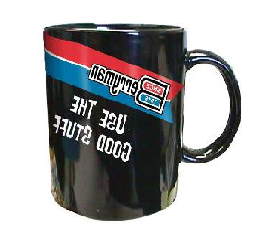

at distance 70.70574529346457:
(Class: cup)
at distance 71.25130599924664:
(Class: cup)
at distance 74.17879642494124:
(Class: cup)
at distance 74.20661829932517:
(Class: cup)
at distance 75.86725929077639:
(Class: cup)
5.0
============= original: =============
(Class: pagoda)


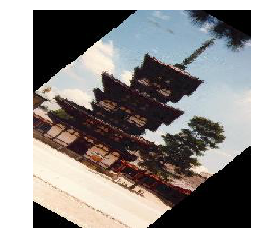

at distance 54.17941921482436:
(Class: pagoda)
at distance 55.264266856736846:
(Class: minaret)
at distance 55.76963643341557:
(Class: pagoda)
at distance 55.8571092023575:
(Class: minaret)
at distance 56.11786470835648:
(Class: pagoda)
3.0
============= original: =============
(Class: soccer_ball)


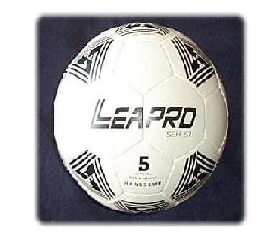

at distance 101.12383653671962:
(Class: soccer_ball)
at distance 102.21915158965247:
(Class: soccer_ball)
at distance 102.39728571326775:
(Class: soccer_ball)
at distance 102.77057044469548:
(Class: soccer_ball)
at distance 104.82848546775449:
(Class: soccer_ball)
5.0
============= original: =============
(Class: car_side)


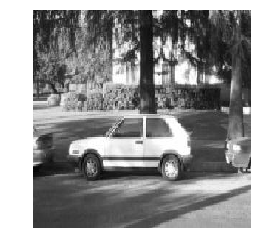

at distance 34.811269573118835:
(Class: car_side)
at distance 34.82653037156282:
(Class: car_side)
at distance 35.22756986910951:
(Class: car_side)
at distance 36.7907165568618:
(Class: car_side)
at distance 36.83360335678283:
(Class: car_side)
5.0
============= original: =============
(Class: Faces_easy)


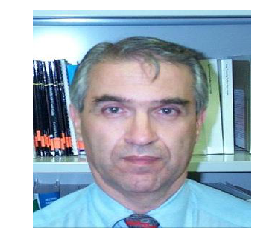

at distance 36.91425117473767:
(Class: Faces_easy)
at distance 37.79451517809767:
(Class: Faces_easy)
at distance 38.598556719924964:
(Class: Faces_easy)
at distance 38.79624795131216:
(Class: Faces_easy)
at distance 38.98757008394435:
(Class: Faces_easy)
5.0
============= original: =============
(Class: Faces)


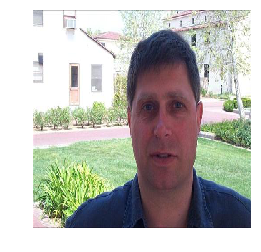

at distance 32.761674978172074:
(Class: Faces_easy)
at distance 36.86051922662122:
(Class: Faces_easy)
at distance 36.86917128425059:
(Class: Faces_easy)
at distance 38.22185662516675:
(Class: Faces)
at distance 38.2594134699062:
(Class: Faces_easy)
1.0
============= original: =============
(Class: trilobite)


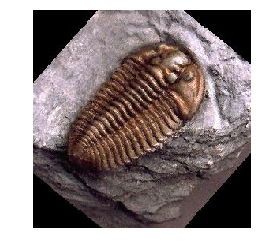

at distance 79.54374360972308:
(Class: trilobite)
at distance 81.129629314244:
(Class: trilobite)
at distance 82.21954743696944:
(Class: trilobite)
at distance 82.92977974065892:
(Class: trilobite)
at distance 86.04056426784592:
(Class: trilobite)
5.0
============= original: =============
(Class: emu)


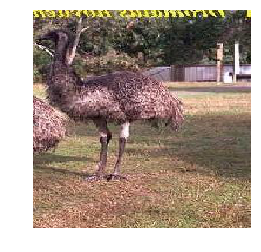

at distance 60.51621956142818:
(Class: emu)
at distance 67.74882704978633:
(Class: emu)
at distance 69.30931313680946:
(Class: emu)
at distance 69.48271750068561:
(Class: emu)
at distance 70.28560872526073:
(Class: emu)
5.0
============= original: =============
(Class: butterfly)


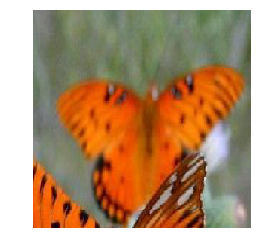

at distance 68.3871456322121:
(Class: butterfly)
at distance 76.22381025548549:
(Class: butterfly)
at distance 76.27636398640621:
(Class: butterfly)
at distance 78.56453374745793:
(Class: butterfly)
at distance 79.21732962709484:
(Class: butterfly)
5.0
============= original: =============
(Class: airplanes)


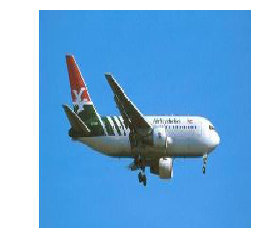

at distance 40.033927233375785:
(Class: airplanes)
at distance 41.09033635109983:
(Class: airplanes)
at distance 41.44399482705424:
(Class: airplanes)
at distance 46.984695976174066:
(Class: airplanes)
at distance 47.160794358808275:
(Class: airplanes)
5.0
============= original: =============
(Class: joshua_tree)


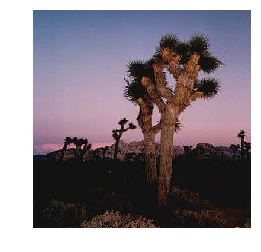

at distance 37.71309932407454:
(Class: joshua_tree)
at distance 49.587861817328566:
(Class: joshua_tree)
at distance 49.892625586338944:
(Class: joshua_tree)
at distance 49.93253360229367:
(Class: joshua_tree)
at distance 50.162366790958615:
(Class: joshua_tree)
5.0
============= original: =============
(Class: ewer)


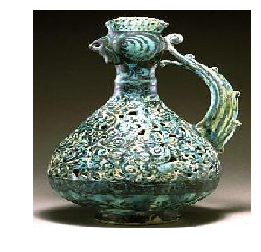

at distance 77.4220187125447:
(Class: ewer)
at distance 78.47551802689406:
(Class: ewer)
at distance 78.77704680091163:
(Class: ewer)
at distance 81.05324067600738:
(Class: ewer)
at distance 81.11096465965532:
(Class: ewer)
5.0
============= original: =============
(Class: pizza)


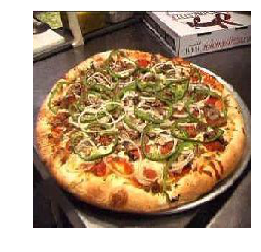

at distance 63.3407673398151:
(Class: pizza)
at distance 71.06939065694239:
(Class: pizza)
at distance 71.53762442531173:
(Class: pizza)
at distance 71.79017068121307:
(Class: pizza)
at distance 72.65274392434756:
(Class: pizza)
5.0
============= original: =============
(Class: emu)


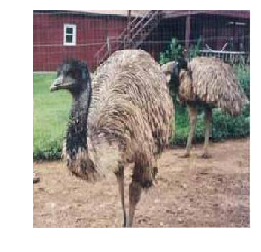

at distance 68.57798823337873:
(Class: emu)
at distance 75.46976529959144:
(Class: emu)
at distance 76.82483328981866:
(Class: emu)
at distance 78.15850169068317:
(Class: llama)
at distance 79.5212199449289:
(Class: llama)
3.0
============= original: =============
(Class: menorah)


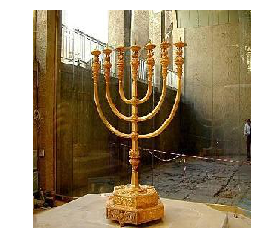

at distance 74.15270989630281:
(Class: menorah)
at distance 76.48286710996202:
(Class: chandelier)
at distance 77.12266194458635:
(Class: menorah)
at distance 77.42525148049025:
(Class: ceiling_fan)
at distance 78.7346492056349:
(Class: menorah)
3.0
============= original: =============
(Class: ewer)


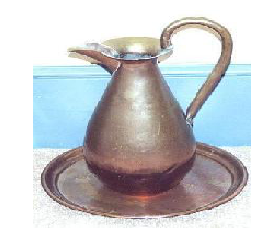

at distance 71.93744274029265:
(Class: ewer)
at distance 75.40116532475507:
(Class: ewer)
at distance 75.5461906252186:
(Class: ewer)
at distance 76.54942747583242:
(Class: ewer)
at distance 77.67507134006321:
(Class: ewer)
5.0
============= original: =============
(Class: Faces_easy)


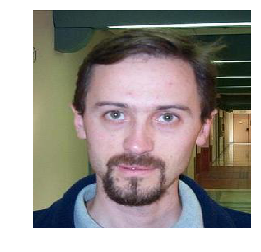

at distance 33.578068607256014:
(Class: Faces_easy)
at distance 34.17043323863217:
(Class: Faces_easy)
at distance 36.945240092203406:
(Class: Faces_easy)
at distance 37.38226856571931:
(Class: Faces_easy)
at distance 37.62963167978306:
(Class: Faces_easy)
5.0
============= original: =============
(Class: airplanes)


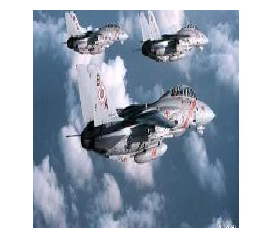

at distance 80.39335279640702:
(Class: helicopter)
at distance 84.48529320598458:
(Class: airplanes)
at distance 85.029756980614:
(Class: airplanes)
at distance 86.45799001986545:
(Class: airplanes)
at distance 87.79346775231406:
(Class: airplanes)
4.0
============= original: =============
(Class: crab)


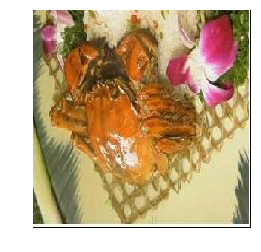

at distance 59.02402731605375:
(Class: crab)
at distance 61.578471570393106:
(Class: water_lilly)
at distance 62.680840822851884:
(Class: Faces)
at distance 64.26988320327209:
(Class: buddha)
at distance 64.29724653113355:
(Class: Faces_easy)
1.0
============= original: =============
(Class: scorpion)


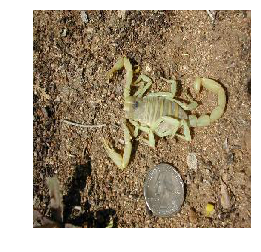

at distance 62.25221602944631:
(Class: scorpion)
at distance 65.61812373845726:
(Class: scorpion)
at distance 68.48525443324714:
(Class: crab)
at distance 68.9931068578286:
(Class: scorpion)
at distance 70.51962113704113:
(Class: crayfish)
3.0
============= original: =============
(Class: airplanes)


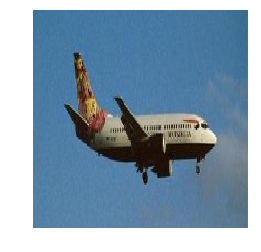

at distance 45.216521265266884:
(Class: airplanes)
at distance 46.02367294620358:
(Class: airplanes)
at distance 46.984864481947895:
(Class: airplanes)
at distance 48.92618102681011:
(Class: airplanes)
at distance 49.27574158448862:
(Class: airplanes)
5.0
============= original: =============
(Class: trilobite)


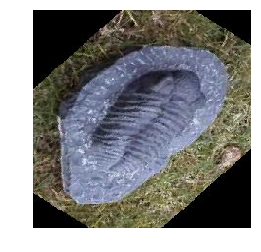

at distance 59.53709388371778:
(Class: trilobite)
at distance 65.87337749244278:
(Class: trilobite)
at distance 72.3115532852805:
(Class: trilobite)
at distance 73.29694356003614:
(Class: trilobite)
at distance 73.82126227452446:
(Class: trilobite)
5.0
============= original: =============
(Class: panda)


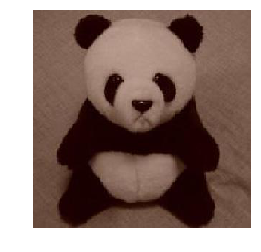

at distance 73.19480950630147:
(Class: panda)
at distance 73.67791881952223:
(Class: panda)
at distance 74.88372351045025:
(Class: panda)
at distance 77.73870378355869:
(Class: panda)
at distance 78.07628333891225:
(Class: panda)
5.0
============= original: =============
(Class: watch)


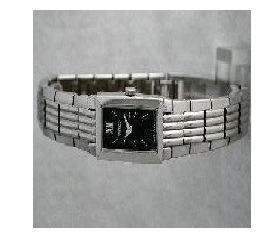

at distance 71.13133273611618:
(Class: watch)
at distance 71.36486594640104:
(Class: wheelchair)
at distance 72.6845227573079:
(Class: electric_guitar)
at distance 73.93429823838892:
(Class: watch)
at distance 74.05983612258412:
(Class: watch)
3.0
============= original: =============
(Class: barrel)


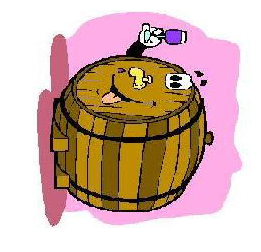

at distance 72.53300855055483:
(Class: garfield)
at distance 72.68430111177918:
(Class: watch)
at distance 74.53355062774376:
(Class: saxophone)
at distance 75.54301720045852:
(Class: yin_yang)
at distance 75.70712875054033:
(Class: yin_yang)
0.0
============= original: =============
(Class: snoopy)


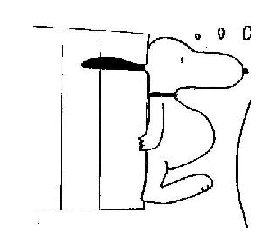

at distance 64.58716057645799:
(Class: snoopy)
at distance 67.46424280930614:
(Class: snoopy)
at distance 67.64225252350964:
(Class: snoopy)
at distance 67.83844513272705:
(Class: wrench)
at distance 69.8953496472003:
(Class: snoopy)
4.0
============= original: =============
(Class: lobster)


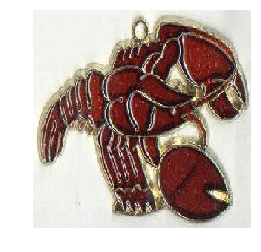

at distance 82.27331589810326:
(Class: yin_yang)
at distance 84.41623230279362:
(Class: garfield)
at distance 84.44757116919158:
(Class: watch)
at distance 84.97208008820114:
(Class: butterfly)
at distance 85.41592781947855:
(Class: butterfly)
0.0
============= original: =============
(Class: Faces_easy)


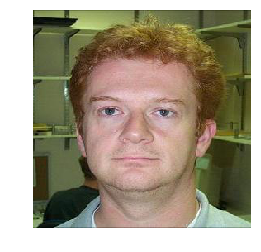

at distance 29.50620227804379:
(Class: Faces_easy)
at distance 29.73570736716508:
(Class: Faces_easy)
at distance 30.763758675744715:
(Class: Faces_easy)
at distance 32.27833446842651:
(Class: Faces_easy)
at distance 32.30291843290407:
(Class: Faces_easy)
5.0
============= original: =============
(Class: Leopards)


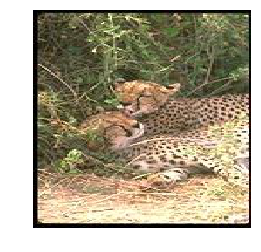

at distance 26.96624053135326:
(Class: Leopards)
at distance 50.38996138197153:
(Class: Leopards)
at distance 51.239478529101966:
(Class: Leopards)
at distance 51.60215153001412:
(Class: Leopards)
at distance 52.27239180332785:
(Class: Leopards)
5.0
============= original: =============
(Class: chair)


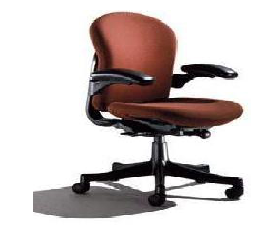

at distance 83.57079324484128:
(Class: chair)
at distance 88.08540870971059:
(Class: chair)
at distance 92.5417306549538:
(Class: chair)
at distance 92.64041445483878:
(Class: windsor_chair)
at distance 93.23176681080595:
(Class: chair)
4.0
============= original: =============
(Class: crab)


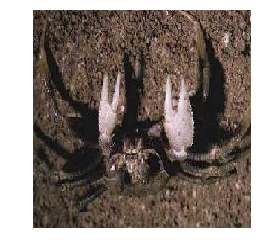

at distance 65.06878240194929:
(Class: crab)
at distance 65.96367953050184:
(Class: crab)
at distance 66.92276958853842:
(Class: crab)
at distance 67.43235800307376:
(Class: crayfish)
at distance 70.18949225674466:
(Class: hawksbill)
3.0
============= original: =============
(Class: watch)


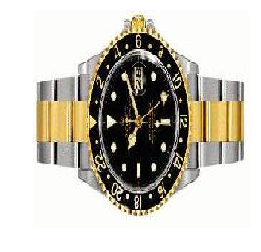

at distance 63.0915474903918:
(Class: watch)
at distance 63.23941160091524:
(Class: watch)
at distance 63.27320640951446:
(Class: watch)
at distance 65.19512578198251:
(Class: watch)
at distance 65.65332623473405:
(Class: watch)
5.0
============= original: =============
(Class: brain)


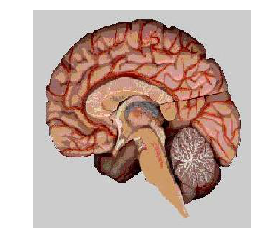

at distance 75.24706392494174:
(Class: brain)
at distance 83.06656268641538:
(Class: brain)
at distance 87.27431949573848:
(Class: brain)
at distance 90.61462473955963:
(Class: brain)
at distance 90.8255518923991:
(Class: brain)
5.0
============= original: =============
(Class: tick)


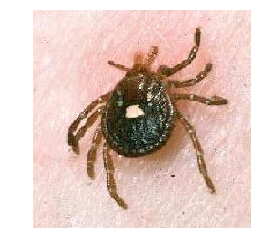

at distance 89.0157294003841:
(Class: crab)
at distance 90.46188694309514:
(Class: tick)
at distance 90.70804232089203:
(Class: tick)
at distance 90.92532423840589:
(Class: tick)
at distance 91.11444978195041:
(Class: tick)
4.0
============= original: =============
(Class: ketch)


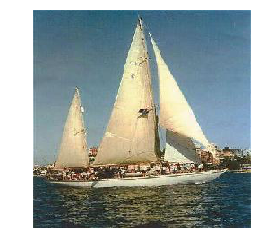

at distance 47.476632884897896:
(Class: ketch)
at distance 48.724654931740545:
(Class: ketch)
at distance 49.5120272067009:
(Class: schooner)
at distance 50.04764277546821:
(Class: ketch)
at distance 51.39187745555068:
(Class: ketch)
4.0
============= original: =============
(Class: joshua_tree)


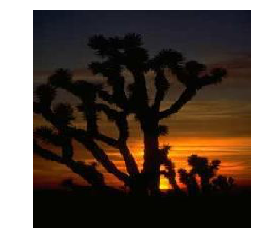

at distance 49.05517257993913:
(Class: joshua_tree)
at distance 52.82249427097535:
(Class: joshua_tree)
at distance 54.086801579699184:
(Class: joshua_tree)
at distance 56.12303700425967:
(Class: joshua_tree)
at distance 57.714541929482074:
(Class: joshua_tree)
5.0
============= original: =============
(Class: car_side)


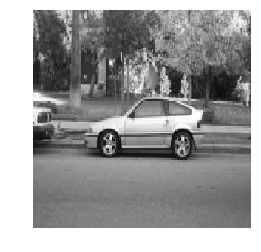

at distance 30.80764530765174:
(Class: car_side)
at distance 32.57824588838147:
(Class: car_side)
at distance 33.249387075463815:
(Class: car_side)
at distance 33.69348926914247:
(Class: car_side)
at distance 33.82441746434353:
(Class: car_side)
5.0
============= original: =============
(Class: Motorbikes)


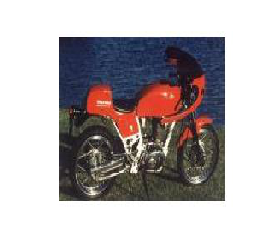

at distance 47.053922436702706:
(Class: Motorbikes)
at distance 48.19558838284813:
(Class: Motorbikes)
at distance 48.339161486129015:
(Class: Motorbikes)
at distance 48.81072494416354:
(Class: Motorbikes)
at distance 48.9601980911097:
(Class: Motorbikes)
5.0
============= original: =============
(Class: wheelchair)


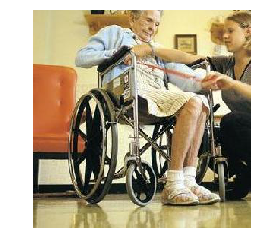

at distance 55.95311315049609:
(Class: wheelchair)
at distance 56.499661877992956:
(Class: wheelchair)
at distance 61.18611496353336:
(Class: wheelchair)
at distance 61.18731138501391:
(Class: wheelchair)
at distance 64.6769978642423:
(Class: wheelchair)
5.0
============= original: =============
(Class: Motorbikes)


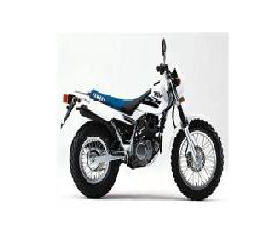

at distance 42.012305512803906:
(Class: Motorbikes)
at distance 42.90659308200992:
(Class: Motorbikes)
at distance 44.58672751632787:
(Class: Motorbikes)
at distance 44.764112853609674:
(Class: Motorbikes)
at distance 44.784686077035545:
(Class: Motorbikes)
5.0
============= original: =============
(Class: dollar_bill)


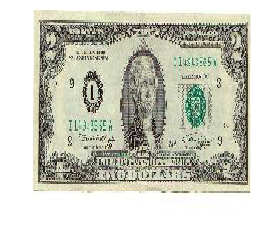

at distance 48.305119963756646:
(Class: dollar_bill)
at distance 53.06719939790307:
(Class: dollar_bill)
at distance 56.88285955877723:
(Class: dollar_bill)
at distance 58.66682243536978:
(Class: dollar_bill)
at distance 58.849964032353604:
(Class: dollar_bill)
5.0
============= original: =============
(Class: stapler)


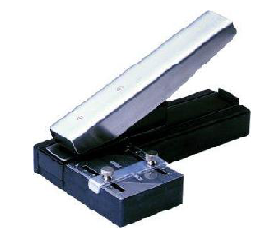

at distance 65.2433043701197:
(Class: stapler)
at distance 67.74772115668125:
(Class: stapler)
at distance 68.13061526534442:
(Class: stapler)
at distance 69.47479431160036:
(Class: stapler)
at distance 70.24770019668989:
(Class: stapler)
5.0
============= original: =============
(Class: dragonfly)


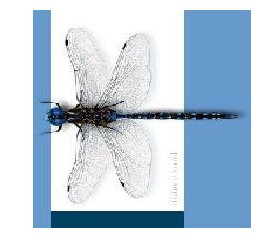

at distance 69.31189175483443:
(Class: dragonfly)
at distance 80.20441985201609:
(Class: dragonfly)
at distance 86.98321143890682:
(Class: dragonfly)
at distance 89.18097039177353:
(Class: dragonfly)
at distance 90.22036360114298:
(Class: dragonfly)
5.0
============= original: =============
(Class: chair)


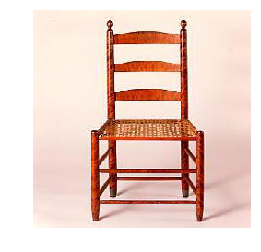

at distance 71.99918173551883:
(Class: chair)
at distance 83.75968426424996:
(Class: chair)
at distance 89.42829331164127:
(Class: chair)
at distance 92.10557721418729:
(Class: chair)
at distance 92.49160317358955:
(Class: chair)
5.0
============= original: =============
(Class: scissors)


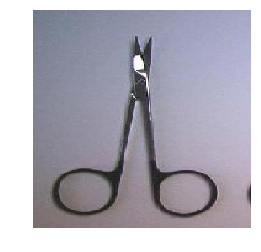

at distance 60.604119317997494:
(Class: scissors)
at distance 61.809329546959354:
(Class: scissors)
at distance 62.09415361432486:
(Class: scissors)
at distance 62.248204090585006:
(Class: scissors)
at distance 62.49378823876863:
(Class: scissors)
5.0
============= original: =============
(Class: Faces_easy)


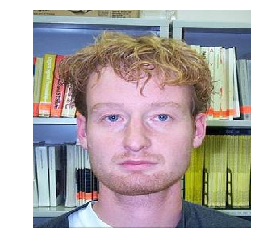

at distance 39.90976735414044:
(Class: Faces_easy)
at distance 40.81178518741064:
(Class: Faces_easy)
at distance 42.7772227225638:
(Class: Faces_easy)
at distance 43.01232386176378:
(Class: Faces_easy)
at distance 43.208782264244974:
(Class: Faces_easy)
5.0
============= original: =============
(Class: airplanes)


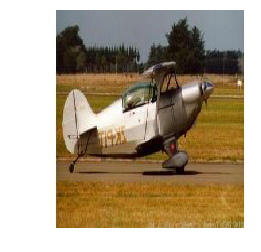

at distance 66.1552379986231:
(Class: airplanes)
at distance 66.2384069187291:
(Class: airplanes)
at distance 67.10932041898769:
(Class: airplanes)
at distance 69.40043305008939:
(Class: airplanes)
at distance 69.72035083001738:
(Class: airplanes)
5.0
============= original: =============
(Class: hedgehog)


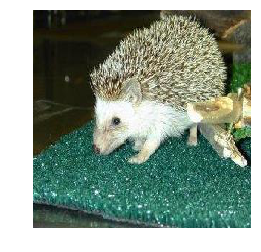

at distance 36.45974492103128:
(Class: hedgehog)
at distance 66.21365320347923:
(Class: hedgehog)
at distance 67.99963981106642:
(Class: hedgehog)
at distance 71.59041949004269:
(Class: hedgehog)
at distance 71.64823397798095:
(Class: hedgehog)
5.0
============= original: =============
(Class: schooner)


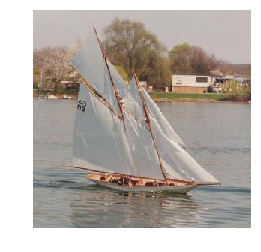

at distance 45.86543417712053:
(Class: ketch)
at distance 47.58785862631126:
(Class: ketch)
at distance 48.57534120988234:
(Class: ketch)
at distance 49.85785749068205:
(Class: ketch)
at distance 50.026675545923894:
(Class: schooner)
1.0
============= original: =============
(Class: cellphone)


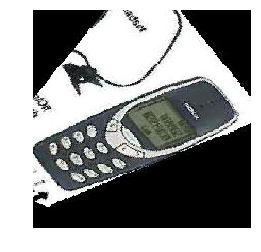

at distance 61.40869897296816:
(Class: cellphone)
at distance 65.92051598634897:
(Class: cellphone)
at distance 66.87431362073671:
(Class: cellphone)
at distance 67.3353476440775:
(Class: cellphone)
at distance 69.60978837001618:
(Class: cellphone)
5.0
============= original: =============
(Class: watch)


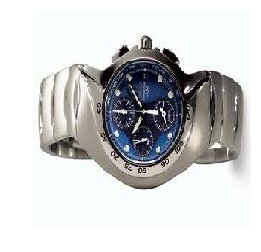

at distance 62.43177514576996:
(Class: watch)
at distance 69.13493916991196:
(Class: watch)
at distance 69.22398176335898:
(Class: watch)
at distance 69.3402784755199:
(Class: watch)
at distance 69.86093255085744:
(Class: watch)
5.0
============= original: =============
(Class: grand_piano)


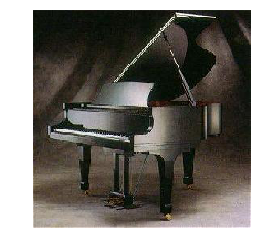

at distance 64.32990295743198:
(Class: grand_piano)
at distance 65.76772016252728:
(Class: grand_piano)
at distance 68.73215328377036:
(Class: grand_piano)
at distance 71.45677991880477:
(Class: grand_piano)
at distance 73.27006640547428:
(Class: grand_piano)
5.0
============= original: =============
(Class: helicopter)


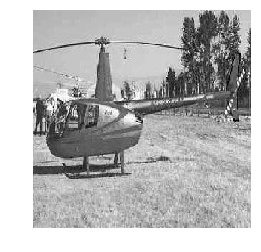

at distance 57.01359284130634:
(Class: helicopter)
at distance 60.506657737473795:
(Class: helicopter)
at distance 60.800006476660705:
(Class: airplanes)
at distance 62.262926419138836:
(Class: airplanes)
at distance 63.1217795998558:
(Class: helicopter)
3.0
============= original: =============
(Class: Leopards)


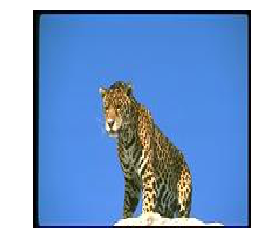

at distance 24.693109779796245:
(Class: Leopards)
at distance 50.786384258304395:
(Class: Leopards)
at distance 51.410763354892:
(Class: Leopards)
at distance 56.92058456730777:
(Class: Leopards)
at distance 58.04036017558573:
(Class: Leopards)
5.0
============= original: =============
(Class: wheelchair)


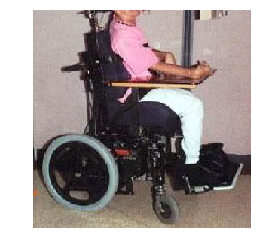

at distance 64.24797916208945:
(Class: wheelchair)
at distance 68.48099616898106:
(Class: Motorbikes)
at distance 69.38711381311155:
(Class: Motorbikes)
at distance 69.60687407774637:
(Class: wheelchair)
at distance 70.11992400026713:
(Class: Motorbikes)
2.0
============= original: =============
(Class: Faces_easy)


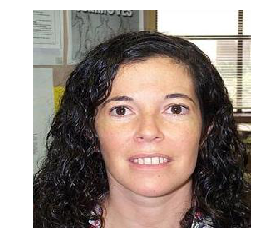

at distance 34.068968957143404:
(Class: Faces_easy)
at distance 34.659043986661054:
(Class: Faces_easy)
at distance 34.708336999135504:
(Class: Faces_easy)
at distance 35.16695280186239:
(Class: Faces_easy)
at distance 35.96033164493583:
(Class: Faces_easy)
5.0
============= original: =============
(Class: pizza)


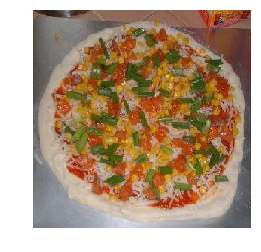

at distance 56.28367706598527:
(Class: pizza)
at distance 59.85608979868707:
(Class: pizza)
at distance 61.34634583878214:
(Class: pizza)
at distance 61.44400642565679:
(Class: pizza)
at distance 62.10143092872656:
(Class: pizza)
5.0
============= original: =============
(Class: brontosaurus)


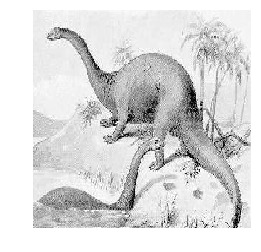

at distance 77.40501685974456:
(Class: brontosaurus)
at distance 87.15697073834089:
(Class: brontosaurus)
at distance 87.26880156003214:
(Class: brontosaurus)
at distance 87.38399955967087:
(Class: brontosaurus)
at distance 89.23964125864993:
(Class: brontosaurus)
5.0
============= original: =============
(Class: cannon)


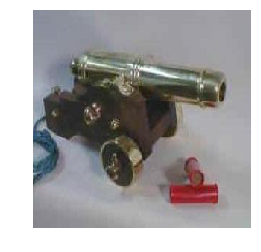

at distance 71.02680907491363:
(Class: Motorbikes)
at distance 71.48749060973553:
(Class: revolver)
at distance 71.75992670941258:
(Class: euphonium)
at distance 72.74038061706489:
(Class: watch)
at distance 73.9949603960507:
(Class: wheelchair)
0.0
============= original: =============
(Class: cougar_face)


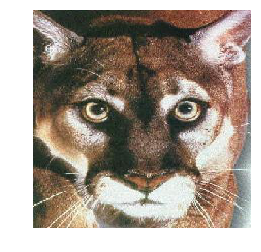

at distance 76.72790180097378:
(Class: cougar_face)
at distance 77.85530110862531:
(Class: cougar_face)
at distance 80.87444897705254:
(Class: cougar_face)
at distance 81.67102607060238:
(Class: cougar_face)
at distance 83.56186532518616:
(Class: cougar_face)
5.0
============= original: =============
(Class: airplanes)


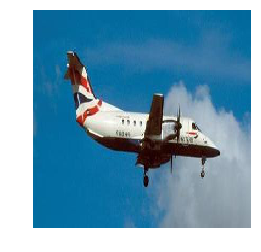

at distance 48.984135137755956:
(Class: airplanes)
at distance 52.304170648863796:
(Class: airplanes)
at distance 53.20749674309915:
(Class: airplanes)
at distance 54.53434017139101:
(Class: airplanes)
at distance 54.67892376563299:
(Class: airplanes)
5.0
============= original: =============
(Class: airplanes)


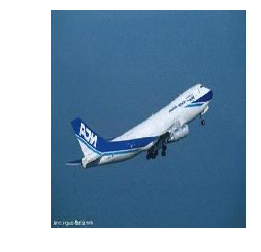

at distance 56.289756423881435:
(Class: airplanes)
at distance 58.34853227770626:
(Class: airplanes)
at distance 61.15869059089899:
(Class: airplanes)
at distance 62.157745193923105:
(Class: airplanes)
at distance 62.84393317753628:
(Class: airplanes)
5.0
============= original: =============
(Class: airplanes)


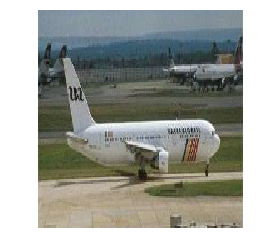

at distance 43.52040564539626:
(Class: airplanes)
at distance 46.14891842973502:
(Class: airplanes)
at distance 46.333658081168075:
(Class: airplanes)
at distance 46.34411613068384:
(Class: airplanes)
at distance 46.80705674736864:
(Class: airplanes)
5.0
============= original: =============
(Class: Faces)


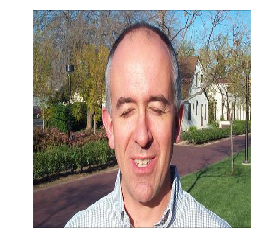

at distance 34.59072344479941:
(Class: Faces_easy)
at distance 39.63684588719458:
(Class: Faces)
at distance 39.98649061531636:
(Class: Faces)
at distance 42.01216573959207:
(Class: Faces)
at distance 43.85338670553755:
(Class: Faces_easy)
3.0
============= original: =============
(Class: panda)


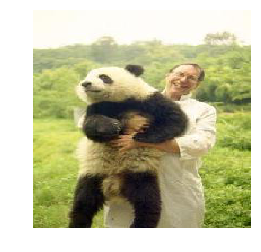

at distance 76.42531896139708:
(Class: panda)
at distance 78.19947695016509:
(Class: panda)
at distance 79.98243158523539:
(Class: panda)
at distance 82.53592284137602:
(Class: panda)
at distance 82.75774044947093:
(Class: panda)
5.0
============= original: =============
(Class: helicopter)


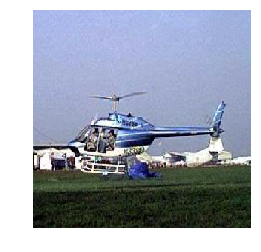

at distance 57.89073565899301:
(Class: helicopter)
at distance 60.071686672760535:
(Class: helicopter)
at distance 61.57385707423742:
(Class: airplanes)
at distance 63.47999291939257:
(Class: airplanes)
at distance 63.873603781633726:
(Class: helicopter)
3.0
============= original: =============
(Class: euphonium)


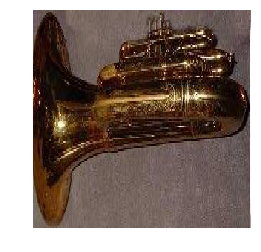

at distance 60.648654629889606:
(Class: euphonium)
at distance 73.41567786515411:
(Class: euphonium)
at distance 73.90423761674744:
(Class: wrench)
at distance 75.40226944156585:
(Class: wrench)
at distance 76.39723587660475:
(Class: saxophone)
2.0
============= original: =============
(Class: trilobite)


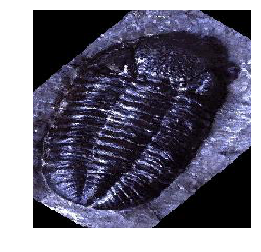

at distance 64.98882180718533:
(Class: trilobite)
at distance 74.43773622630921:
(Class: trilobite)
at distance 75.51170338924082:
(Class: trilobite)
at distance 76.14045280856777:
(Class: trilobite)
at distance 76.52664634272045:
(Class: trilobite)
5.0
============= original: =============
(Class: airplanes)


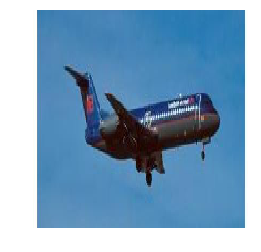

at distance 47.64475261218344:
(Class: airplanes)
at distance 50.37071681880352:
(Class: airplanes)
at distance 50.860531063581156:
(Class: airplanes)
at distance 51.28135973074467:
(Class: airplanes)
at distance 52.64259271145637:
(Class: airplanes)
5.0
============= original: =============
(Class: Faces_easy)


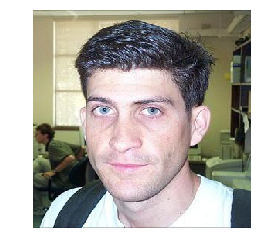

at distance 36.479320111417046:
(Class: Faces_easy)
at distance 37.55456743039773:
(Class: Faces_easy)
at distance 38.635692543658564:
(Class: Faces_easy)
at distance 39.0870846865265:
(Class: Faces_easy)
at distance 39.25422299516737:
(Class: Faces_easy)
5.0
============= original: =============
(Class: Motorbikes)


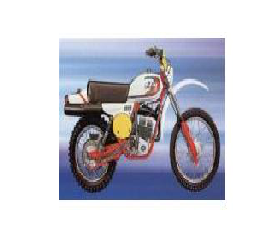

at distance 40.55451696263462:
(Class: Motorbikes)
at distance 42.048978255911116:
(Class: Motorbikes)
at distance 43.63706763295254:
(Class: Motorbikes)
at distance 43.64306896815696:
(Class: Motorbikes)
at distance 43.68056148500265:
(Class: Motorbikes)
5.0
============= original: =============
(Class: sea_horse)


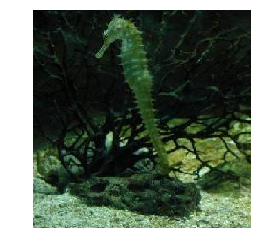

at distance 58.86884018552893:
(Class: sea_horse)
at distance 59.297889608651836:
(Class: crayfish)
at distance 59.506537773466:
(Class: crocodile_head)
at distance 61.38412154430364:
(Class: crab)
at distance 62.05657191284291:
(Class: hawksbill)
1.0
============= original: =============
(Class: airplanes)


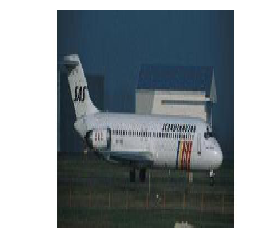

at distance 52.13258063280469:
(Class: airplanes)
at distance 53.23590836832288:
(Class: airplanes)
at distance 53.560451913021375:
(Class: airplanes)
at distance 54.32873258319996:
(Class: airplanes)
at distance 55.7480569102916:
(Class: airplanes)
5.0
============= original: =============
(Class: lotus)


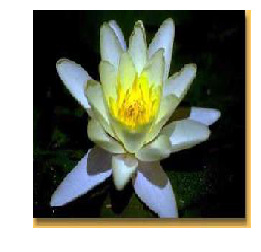

at distance 57.65694040870396:
(Class: lotus)
at distance 57.74199584505426:
(Class: water_lilly)
at distance 58.19942051716884:
(Class: lotus)
at distance 59.40254945136785:
(Class: water_lilly)
at distance 59.754914233422575:
(Class: water_lilly)
2.0
============= original: =============
(Class: Motorbikes)


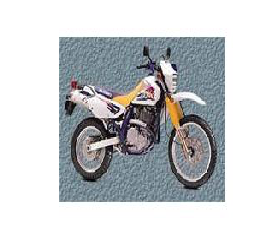

at distance 45.993923033648336:
(Class: Motorbikes)
at distance 46.37734358457704:
(Class: Motorbikes)
at distance 47.62686839160013:
(Class: Motorbikes)
at distance 47.70749595343749:
(Class: Motorbikes)
at distance 47.72464215576595:
(Class: Motorbikes)
5.0
============= original: =============
(Class: cellphone)


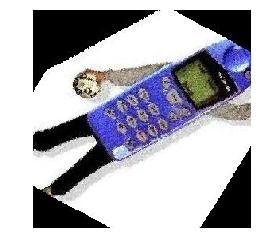

at distance 63.75055320993768:
(Class: cellphone)
at distance 64.60926427296702:
(Class: cellphone)
at distance 65.37708163450132:
(Class: cellphone)
at distance 67.02406623836221:
(Class: cellphone)
at distance 67.2012589006043:
(Class: cellphone)
5.0
============= original: =============
(Class: electric_guitar)


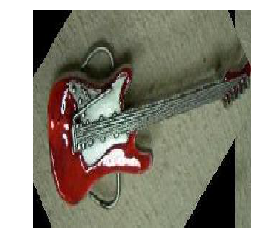

at distance 73.47140826752229:
(Class: gramophone)
at distance 73.68599152060118:
(Class: scissors)
at distance 74.13357336060376:
(Class: watch)
at distance 74.49248792042953:
(Class: pagoda)
at distance 74.49809412304214:
(Class: wheelchair)
0.0
============= original: =============
(Class: accordion)


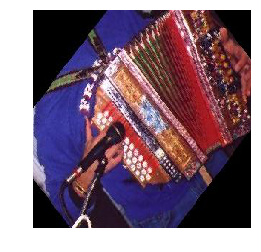

at distance 75.7719736066678:
(Class: accordion)
at distance 78.80395415989042:
(Class: accordion)
at distance 79.3652774750316:
(Class: accordion)
at distance 79.86646820970255:
(Class: accordion)
at distance 81.43009500612784:
(Class: accordion)
5.0
============= original: =============
(Class: pizza)


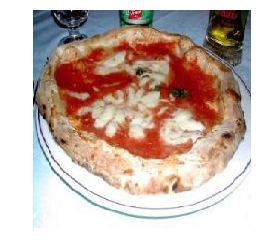

at distance 58.2375353882162:
(Class: pizza)
at distance 59.73149275347072:
(Class: pizza)
at distance 61.44400642565679:
(Class: pizza)
at distance 65.85128975041233:
(Class: pizza)
at distance 67.21799108582805:
(Class: pizza)
5.0
============= original: =============
(Class: airplanes)


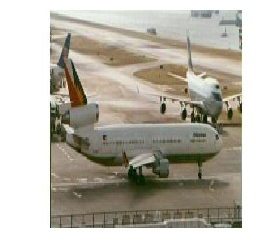

at distance 49.922979553663964:
(Class: airplanes)
at distance 50.89781027648946:
(Class: airplanes)
at distance 53.92504457108306:
(Class: airplanes)
at distance 54.7222402139104:
(Class: airplanes)
at distance 55.24309424389854:
(Class: airplanes)
5.0
============= original: =============
(Class: pizza)


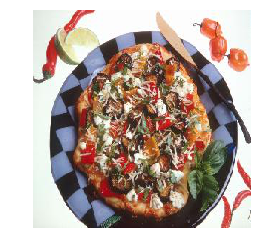

at distance 72.73770662092556:
(Class: pizza)
at distance 76.18779793964883:
(Class: pizza)
at distance 76.38760873134562:
(Class: pizza)
at distance 77.07963487267082:
(Class: pizza)
at distance 77.57190935916131:
(Class: pizza)
5.0
============= original: =============
(Class: watch)


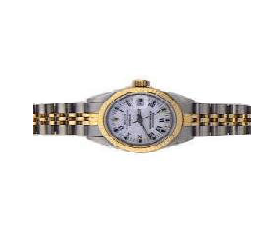

at distance 59.496867898650486:
(Class: watch)
at distance 59.84588626986659:
(Class: watch)
at distance 65.21027857803091:
(Class: watch)
at distance 65.90810039185511:
(Class: watch)
at distance 66.25196851587005:
(Class: watch)
5.0
============= original: =============
(Class: ferry)


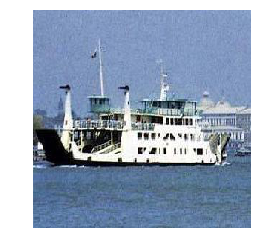

at distance 45.20576212835049:
(Class: ferry)
at distance 45.378067904018856:
(Class: ferry)
at distance 47.460688264394754:
(Class: ferry)
at distance 49.38925150860652:
(Class: ferry)
at distance 50.724030358089806:
(Class: ferry)
5.0
============= original: =============
(Class: camera)


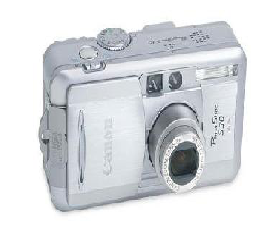

at distance 56.619501606116394:
(Class: camera)
at distance 56.91413943633915:
(Class: camera)
at distance 57.09708453072686:
(Class: camera)
at distance 60.38312574068492:
(Class: camera)
at distance 61.8817820489314:
(Class: camera)
5.0
============= original: =============
(Class: windsor_chair)


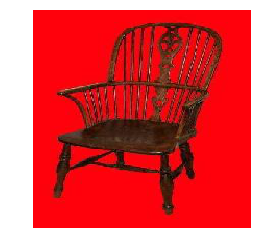

at distance 58.11985836419165:
(Class: windsor_chair)
at distance 58.25502411897725:
(Class: windsor_chair)
at distance 58.58335879787915:
(Class: windsor_chair)
at distance 59.69138246534436:
(Class: windsor_chair)
at distance 60.276333341025946:
(Class: windsor_chair)
5.0
============= original: =============
(Class: Motorbikes)


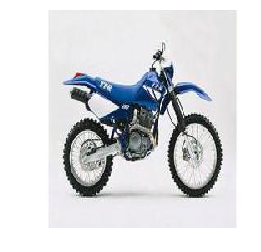

at distance 31.08585774661376:
(Class: Motorbikes)
at distance 31.34679427907389:
(Class: Motorbikes)
at distance 33.3410404738603:
(Class: Motorbikes)
at distance 39.07981062016612:
(Class: Motorbikes)
at distance 39.13541093527035:
(Class: Motorbikes)
5.0
============= original: =============
(Class: dollar_bill)


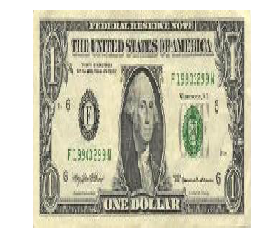

at distance 33.716913948050376:
(Class: dollar_bill)
at distance 35.14394202922539:
(Class: dollar_bill)
at distance 36.13837692018001:
(Class: dollar_bill)
at distance 40.66137940003767:
(Class: dollar_bill)
at distance 42.50500921512629:
(Class: dollar_bill)
5.0
============= original: =============
(Class: crab)


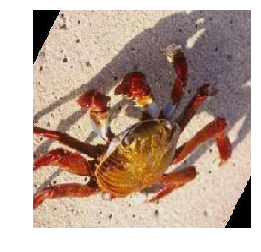

at distance 87.28681537224561:
(Class: crab)
at distance 90.28105840624201:
(Class: crab)
at distance 90.88993948875066:
(Class: crab)
at distance 91.1240884495595:
(Class: crab)
at distance 92.65202174488444:
(Class: crab)
5.0
============= original: =============
(Class: Motorbikes)


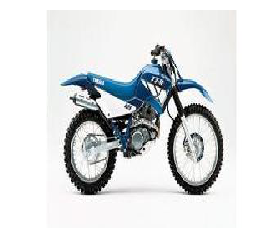

at distance 31.34679427907389:
(Class: Motorbikes)
at distance 34.39951631492841:
(Class: Motorbikes)
at distance 35.82402521411939:
(Class: Motorbikes)
at distance 35.84375535075765:
(Class: Motorbikes)
at distance 37.13266659029798:
(Class: Motorbikes)
5.0
============= original: =============
(Class: cannon)


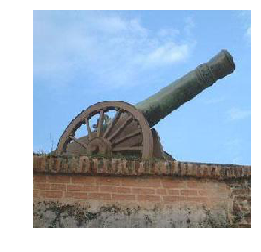

at distance 62.59181374097682:
(Class: cannon)
at distance 68.59452525553911:
(Class: cannon)
at distance 72.298216850002:
(Class: minaret)
at distance 72.77475301589986:
(Class: cannon)
at distance 73.21876650644836:
(Class: cannon)
4.0
============= original: =============
(Class: airplanes)


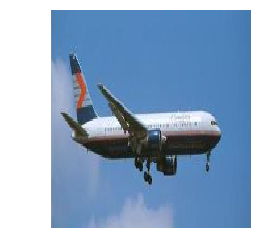

at distance 34.89757426852387:
(Class: airplanes)
at distance 37.214496636213354:
(Class: airplanes)
at distance 37.23703421621045:
(Class: airplanes)
at distance 37.66684841776554:
(Class: airplanes)
at distance 38.6017892512634:
(Class: airplanes)
5.0
============= original: =============
(Class: sunflower)


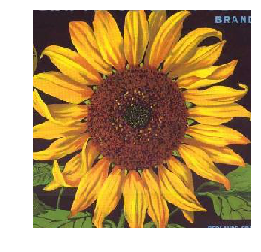

at distance 50.29625754742182:
(Class: sunflower)
at distance 54.7336708998176:
(Class: sunflower)
at distance 55.54930149110094:
(Class: sunflower)
at distance 55.70461082394379:
(Class: sunflower)
at distance 56.173656550888175:
(Class: sunflower)
5.0
============= original: =============
(Class: rhino)


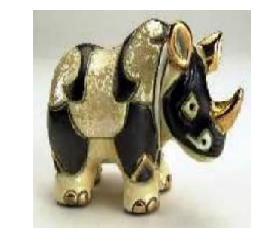

at distance 83.44650306924603:
(Class: butterfly)
at distance 86.67121698579054:
(Class: watch)
at distance 86.94079893485979:
(Class: crayfish)
at distance 87.04418759082526:
(Class: butterfly)
at distance 87.33267830577125:
(Class: gramophone)
0.0
============= original: =============
(Class: airplanes)


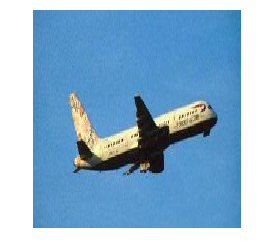

at distance 49.184530470958364:
(Class: airplanes)
at distance 49.77919097594024:
(Class: airplanes)
at distance 50.413886155743825:
(Class: airplanes)
at distance 50.63884248339856:
(Class: airplanes)
at distance 51.40457033667276:
(Class: airplanes)
5.0
============= original: =============
(Class: airplanes)


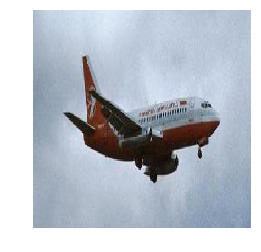

at distance 63.426979232046605:
(Class: airplanes)
at distance 63.73685807387709:
(Class: airplanes)
at distance 63.88465828093784:
(Class: airplanes)
at distance 64.87089998216042:
(Class: airplanes)
at distance 64.95684585215945:
(Class: airplanes)
5.0
============= original: =============
(Class: watch)


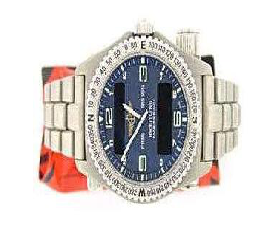

at distance 32.01811840243058:
(Class: watch)
at distance 51.44255175367201:
(Class: watch)
at distance 54.04578651004156:
(Class: watch)
at distance 57.431850061750296:
(Class: watch)
at distance 57.74001763540444:
(Class: watch)
5.0
============= original: =============
(Class: airplanes)


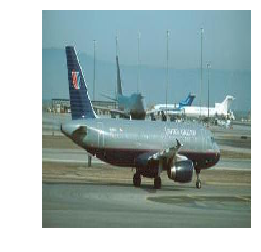

at distance 48.439551796575444:
(Class: airplanes)
at distance 51.94373919846109:
(Class: airplanes)
at distance 52.02316244128516:
(Class: airplanes)
at distance 52.15244148075983:
(Class: airplanes)
at distance 52.79214672386581:
(Class: airplanes)
5.0
============= original: =============
(Class: ceiling_fan)


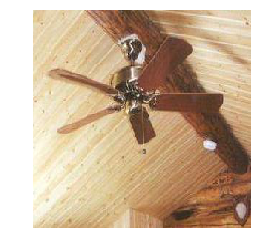

at distance 72.21321669426547:
(Class: dragonfly)
at distance 73.08903252876924:
(Class: ceiling_fan)
at distance 73.91053915313614:
(Class: ceiling_fan)
at distance 74.47720499883575:
(Class: ceiling_fan)
at distance 75.7502382133605:
(Class: ceiling_fan)
4.0
============= original: =============
(Class: airplanes)


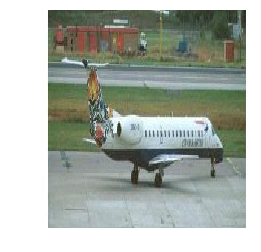

at distance 48.14074351427157:
(Class: airplanes)
at distance 49.667822121134044:
(Class: airplanes)
at distance 49.827526622748984:
(Class: airplanes)
at distance 50.03739461922821:
(Class: airplanes)
at distance 50.16810672866508:
(Class: airplanes)
5.0
============= original: =============
(Class: airplanes)


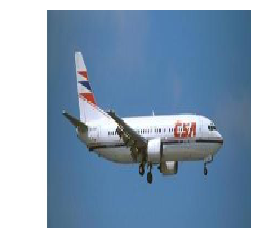

at distance 37.63489730976983:
(Class: airplanes)
at distance 38.66780156915207:
(Class: airplanes)
at distance 38.94088008379895:
(Class: airplanes)
at distance 40.18973772225496:
(Class: airplanes)
at distance 41.15881676793685:
(Class: airplanes)
5.0
============= original: =============
(Class: dalmatian)


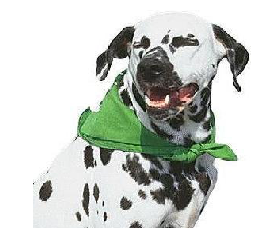

at distance 64.73428109299438:
(Class: dalmatian)
at distance 66.40575510597337:
(Class: dalmatian)
at distance 66.44965932674374:
(Class: dalmatian)
at distance 68.74349735523633:
(Class: dalmatian)
at distance 68.82976749559337:
(Class: dalmatian)
5.0
============= original: =============
(Class: hawksbill)


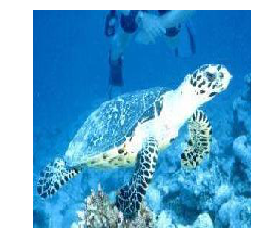

at distance 49.06667052832317:
(Class: hawksbill)
at distance 53.15531565477064:
(Class: hawksbill)
at distance 56.35186025690256:
(Class: hawksbill)
at distance 60.03604176113501:
(Class: hawksbill)
at distance 60.34776206234821:
(Class: hawksbill)
5.0
============= original: =============
(Class: elephant)


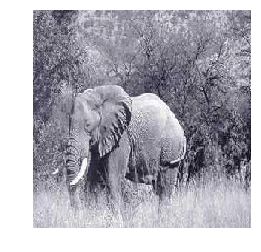

at distance 70.76005758203982:
(Class: rhino)
at distance 70.78342464197927:
(Class: elephant)
at distance 71.29724150397088:
(Class: elephant)
at distance 74.51002344559302:
(Class: elephant)
at distance 75.12945628080358:
(Class: elephant)
4.0
============= original: =============
(Class: llama)


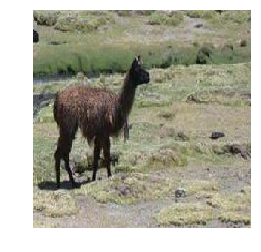

at distance 66.44539258451965:
(Class: llama)
at distance 74.97858867119851:
(Class: llama)
at distance 81.9947017692567:
(Class: llama)
at distance 83.81465468261462:
(Class: llama)
at distance 84.29057512410807:
(Class: llama)
5.0
============= original: =============
(Class: airplanes)


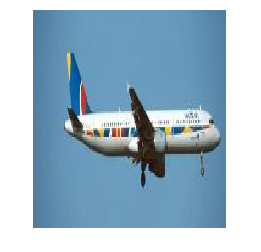

at distance 42.17691378079307:
(Class: airplanes)
at distance 42.34553645828701:
(Class: airplanes)
at distance 49.10898700266799:
(Class: airplanes)
at distance 50.09860623872307:
(Class: airplanes)
at distance 50.42557031188435:
(Class: airplanes)
5.0
============= original: =============
(Class: ketch)


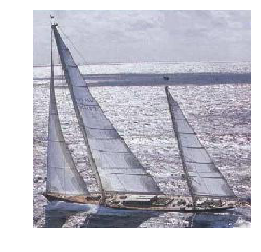

at distance 56.31527513400077:
(Class: ketch)
at distance 58.95065342130501:
(Class: schooner)
at distance 59.90534561317112:
(Class: ketch)
at distance 60.62190300206153:
(Class: ketch)
at distance 60.853008632533424:
(Class: ketch)
4.0
============= original: =============
(Class: Motorbikes)


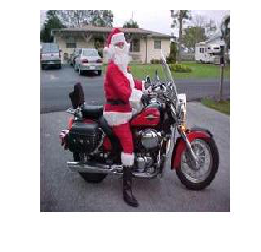

at distance 46.250056132403394:
(Class: Motorbikes)
at distance 47.819603924870506:
(Class: Motorbikes)
at distance 49.00037341784266:
(Class: Motorbikes)
at distance 49.308286387802724:
(Class: Motorbikes)
at distance 49.82400118274892:
(Class: Motorbikes)
5.0
============= original: =============
(Class: Faces)


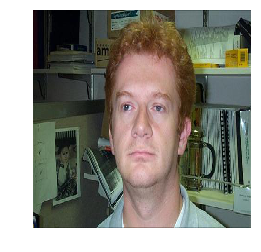

at distance 35.53541602964762:
(Class: Faces_easy)
at distance 36.480826762737024:
(Class: Faces)
at distance 37.17378799615516:
(Class: Faces_easy)
at distance 39.023931407479104:
(Class: Faces_easy)
at distance 39.07942399561807:
(Class: Faces_easy)
1.0
============= original: =============
(Class: Motorbikes)


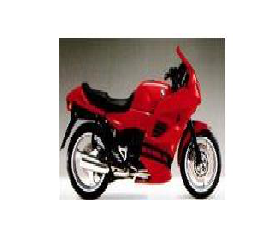

at distance 42.021792144345774:
(Class: Motorbikes)
at distance 44.78582753607645:
(Class: Motorbikes)
at distance 48.24269959349466:
(Class: Motorbikes)
at distance 48.28513295137738:
(Class: Motorbikes)
at distance 48.91347844317435:
(Class: Motorbikes)
5.0
============= original: =============
(Class: starfish)


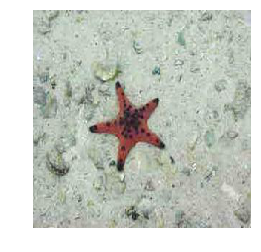

at distance 67.86208915809462:
(Class: starfish)
at distance 68.25509458936213:
(Class: starfish)
at distance 71.19539097361094:
(Class: starfish)
at distance 76.81664020946127:
(Class: starfish)
at distance 77.10655630851878:
(Class: starfish)
5.0
============= original: =============
(Class: Motorbikes)


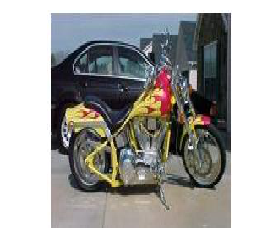

at distance 47.48977359632337:
(Class: Motorbikes)
at distance 48.33815432730928:
(Class: Motorbikes)
at distance 51.8161496867708:
(Class: Motorbikes)
at distance 53.46808631507554:
(Class: Motorbikes)
at distance 53.720430343734705:
(Class: Motorbikes)
5.0
============= original: =============
(Class: Faces)


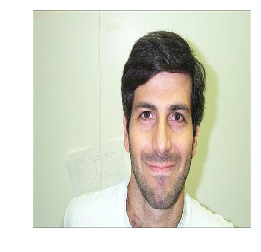

at distance 26.937272086412953:
(Class: Faces_easy)
at distance 34.57509291292601:
(Class: Faces_easy)
at distance 37.048549126904895:
(Class: Faces)
at distance 39.262091683196715:
(Class: Faces_easy)
at distance 39.905614826553666:
(Class: Faces_easy)
1.0
============= original: =============
(Class: metronome)


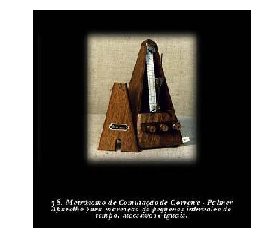

at distance 67.70170703080639:
(Class: metronome)
at distance 69.09173313651256:
(Class: Faces)
at distance 70.42907254425506:
(Class: gramophone)
at distance 71.500559815882:
(Class: watch)
at distance 71.86634320898364:
(Class: metronome)
2.0
============= original: =============
(Class: ant)


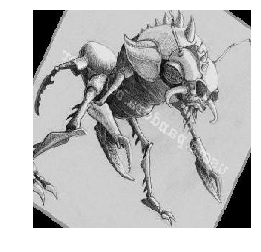

at distance 70.05721010784555:
(Class: butterfly)
at distance 70.74090532709465:
(Class: elephant)
at distance 72.14888590433445:
(Class: garfield)
at distance 73.41748397081491:
(Class: ant)
at distance 74.3334640286789:
(Class: crab)
1.0
============= original: =============
(Class: dalmatian)


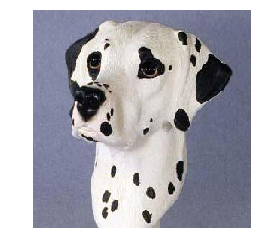

at distance 78.7707028422133:
(Class: dalmatian)
at distance 78.9194264898038:
(Class: dalmatian)
at distance 80.06822019100977:
(Class: dalmatian)
at distance 81.75156587935972:
(Class: dalmatian)
at distance 82.61460512842064:
(Class: dalmatian)
5.0
============= original: =============
(Class: llama)


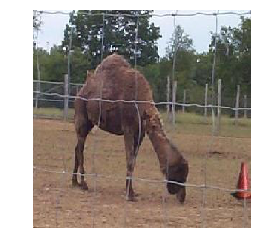

at distance 76.9867616339453:
(Class: elephant)
at distance 77.18972807681364:
(Class: elephant)
at distance 78.19978536452884:
(Class: elephant)
at distance 80.47068080006835:
(Class: elephant)
at distance 82.68092917096484:
(Class: okapi)
0.0
============= original: =============
(Class: trilobite)


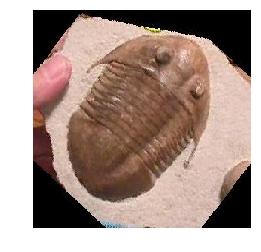

at distance 74.12995012032208:
(Class: trilobite)
at distance 75.73621223120777:
(Class: trilobite)
at distance 76.42958885462109:
(Class: trilobite)
at distance 78.11667698226911:
(Class: trilobite)
at distance 81.75039274241344:
(Class: trilobite)
5.0
============= original: =============
(Class: Motorbikes)


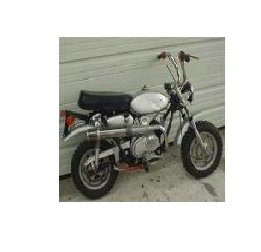

at distance 47.34555035413702:
(Class: Motorbikes)
at distance 47.58851321334581:
(Class: Motorbikes)
at distance 48.11368760901411:
(Class: Motorbikes)
at distance 48.211608742975365:
(Class: Motorbikes)
at distance 48.71692674483617:
(Class: Motorbikes)
5.0
============= original: =============
(Class: Motorbikes)


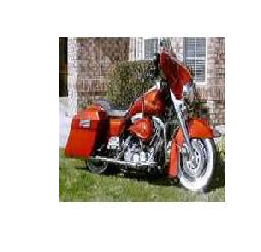

at distance 56.4416924862769:
(Class: Motorbikes)
at distance 56.90880721942466:
(Class: Motorbikes)
at distance 58.76584675013603:
(Class: Motorbikes)
at distance 58.9007947074991:
(Class: Motorbikes)
at distance 59.10429252410153:
(Class: Motorbikes)
5.0
============= original: =============
(Class: euphonium)


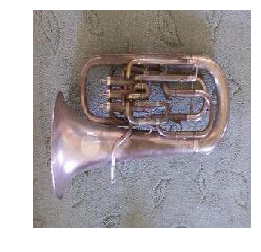

at distance 70.45005880171911:
(Class: euphonium)
at distance 72.77592727466663:
(Class: euphonium)
at distance 73.71213298858535:
(Class: euphonium)
at distance 74.36735902584113:
(Class: euphonium)
at distance 75.44025668917418:
(Class: euphonium)
5.0
============= original: =============
(Class: flamingo)


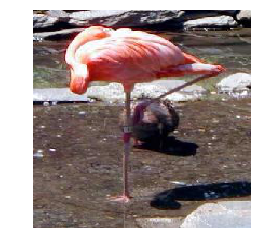

at distance 64.02526076195417:
(Class: flamingo)
at distance 66.76639014033537:
(Class: flamingo)
at distance 67.81867797821596:
(Class: flamingo)
at distance 72.31473542609129:
(Class: flamingo)
at distance 73.28400071835824:
(Class: flamingo)
5.0
============= original: =============
(Class: ferry)


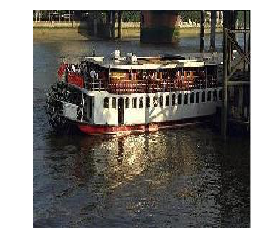

at distance 61.18767419290193:
(Class: ferry)
at distance 62.19498918436405:
(Class: ferry)
at distance 63.48722505866519:
(Class: ferry)
at distance 67.53381155844231:
(Class: ferry)
at distance 69.21616164169194:
(Class: ferry)
5.0
============= original: =============
(Class: chandelier)


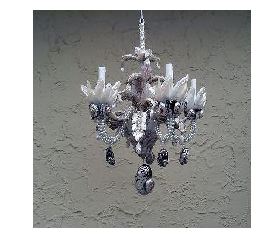

at distance 76.33939443526151:
(Class: water_lilly)
at distance 77.7166040595644:
(Class: ceiling_fan)
at distance 81.63058953518517:
(Class: chandelier)
at distance 82.15310274929784:
(Class: strawberry)
at distance 82.19929254663607:
(Class: chandelier)
2.0
============= original: =============
(Class: wheelchair)


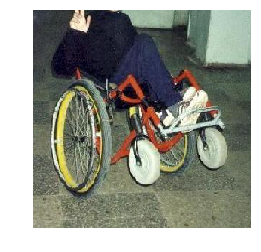

at distance 57.839655712323705:
(Class: Motorbikes)
at distance 60.93292167659226:
(Class: Motorbikes)
at distance 60.99455708374478:
(Class: Motorbikes)
at distance 61.19852989229182:
(Class: wheelchair)
at distance 61.85582713803955:
(Class: Motorbikes)
1.0
============= original: =============
(Class: Motorbikes)


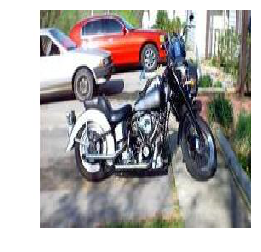

at distance 49.98547711249221:
(Class: Motorbikes)
at distance 53.720316254126175:
(Class: Motorbikes)
at distance 55.67175137619464:
(Class: Motorbikes)
at distance 56.38272817371137:
(Class: Motorbikes)
at distance 56.77607732207319:
(Class: wheelchair)
4.0
============= original: =============
(Class: ketch)


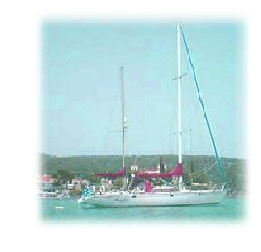

at distance 52.47602282711744:
(Class: ketch)
at distance 54.00483132279275:
(Class: ketch)
at distance 54.50487526775512:
(Class: ketch)
at distance 56.995278036084926:
(Class: ketch)
at distance 57.810843203028384:
(Class: ketch)
5.0
============= original: =============
(Class: watch)


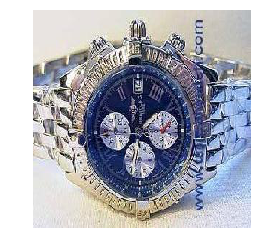

at distance 57.411739484434705:
(Class: watch)
at distance 63.14259865733626:
(Class: watch)
at distance 67.93729664890016:
(Class: watch)
at distance 68.52103352888173:
(Class: watch)
at distance 69.07571912736397:
(Class: watch)
5.0
============= original: =============
(Class: airplanes)


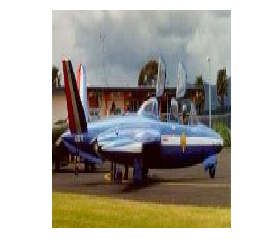

at distance 62.48948646101478:
(Class: airplanes)
at distance 62.58089031709624:
(Class: airplanes)
at distance 63.17495149611913:
(Class: airplanes)
at distance 63.73966639656882:
(Class: airplanes)
at distance 63.93917237356845:
(Class: car_side)
4.0
caltech101_VGG16_fc1.p Score: 3.59
caltech101_VGG16_fc2.p Score: 3.895


In [4]:
# NOTE: you will first need to apply some changes to "Practical-3.3.0_preprocess-caltech101.ipynb" and run it
#       to obtain a pickle file with "fc1"-features. You don't need to show these changes here.


# make random selection of n query images/indices, the same for all experiments
#########################################################################################################################
n = 200
n_examples = 8677  # the dataset has 8677 images
indices = np.random.choice(range(n_examples), size=n, replace=False)

# iterate over two data representations (make sure these two files exist in the "data" subfolder first)
scores = []
files = ("caltech101_VGG16_fc1.p", "caltech101_VGG16_fc2.p")
for datapath in files:
    # load the dataset
    with open(os.path.join("data", datapath), "rb") as f:
        X_fc, y, X_paths, classes = pickle.load(f)

    # === SOLUTION: ===
    # insert code here
    
    # 5 neighbors + itself (Euclidian distance)
    print("##########################################################################################")
    print("#################################", datapath, "#################################")
    neigh = NearestNeighbors(n_neighbors=6, p=2)
    neigh.fit(X_fc)
    
    # Find NearestNeighbors of the images corresponding to the indices
    X = X_fc[indices]
    nn = neigh.kneighbors(X)
    
    print("Query results")
    
    score = []
    for i, distances, nn_indices in zip(indices, nn[0], nn[1]):
        print("============= original: =============")
        print("(Class: {})".format(classes[y[i]]))
        show_img(X_paths[i])
        
        score.append(0.0)
        for dist, j in zip(distances, nn_indices):
            # Exclude query image from query results
            if i!=j:
                print("at distance {}:".format(dist))
                print("(Class: {})".format(classes[y[j]]))
                # show_img(X_paths[j])
                
                if classes[y[i]] == classes[y[j]]:
                    score[-1] +=1
        
        print(score[-1])
    
    scores.append(score)
        
    
for i in range(len(files)):
    print(files[i], "Score:", sum(scores[i])/len(scores[i]))

***

**b)** Which representation ("neural code") provided better features for the given retrieval task? 
Justify your answer and discuss possible reasons for the observed results. Relate your answer to the conclusions in the paper "Neural Codes for Image Retrieval".

**Answer:**

*=== write your answer here ===*

*model architecture*
1. input_1 (InputLayer)
1. block1_conv1 (Conv2D)
1. block1_conv2 (Conv2D)
1. block1_pool (MaxPooling2D)
1. block2_conv1 (Conv2D)
1. block2_conv2 (Conv2D)
1. block2_pool (MaxPooling2D)
1. block3_conv1 (Conv2D)
1. block3_conv2 (Conv2D)
1. block3_conv3 (Conv2D)
1. block3_pool (MaxPooling2D)
1. block4_conv1 (Conv2D)
1. block4_conv2 (Conv2D)
1. block4_conv3 (Conv2D)
1. block4_pool (MaxPooling2D)
1. block5_conv1 (Conv2D)
1. block5_conv2 (Conv2D)
1. block5_conv3 (Conv2D)
1. block5_pool (MaxPooling2D)
1. flatten (Flatten)
1. fc1 (Dense)
1. fc2 (Dense)
1. predictions (Dense)

We tested the performance of the neural codes of fc1 and fc2.

*Results*
- fc1 Score: 3.59
- fc2 Score: 3.895


Hence the fc2 score is better. This is not consistent with the results in the paper "Neural Codes for Image Retrieval". They found that the layer that is two layers below the outputs performs better. In our experiment the neural codes of the fc2 layer is better. This is the last layer before the output layer.

In the paper they specultated this had to do with the fact that that the last layers are too specialized for classification. In our case this does not seem to be the case. This might have to do with the fact that the score metric uses classes of the images to measure the retrieval performance.

***

### Task 1.2: Detailed evaluation
**a)** The retrieval scores can vary from one query image to another. Some images are quite representative and for them retrieval works well, some are not so much.
For the same retrieval task given above using "fc2"-features, find (if possible) six query images such that they range from excellent to poor retrieval performance. More specifically find example query images that result in query scores of exactly 0, 1, 2, 3, 4, and 5.

Visualise the six (or less) resulting query images.

In [5]:
# you'll need these extra imports:
from keras.preprocessing import image
import matplotlib.pyplot as plt
%matplotlib inline

13
============= original: =============
(Class: beaver)


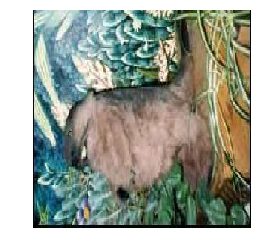

at distance 69.18237817531003:
(Class: brontosaurus)


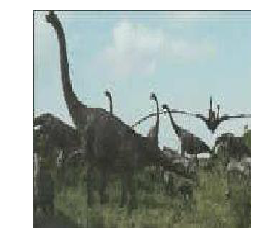

at distance 69.22968900760957:
(Class: Leopards)


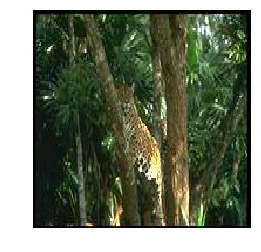

at distance 70.32243992737902:
(Class: Leopards)


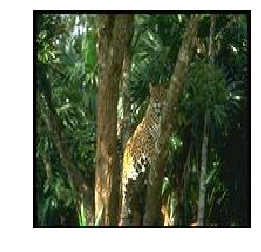

at distance 70.36117065476765:
(Class: bonsai)


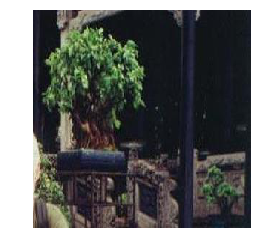

at distance 70.3928047402018:
(Class: sea_horse)


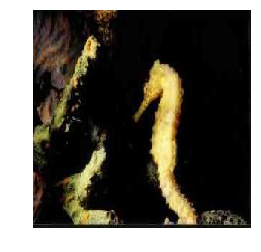

1
============= original: =============
(Class: ketch)


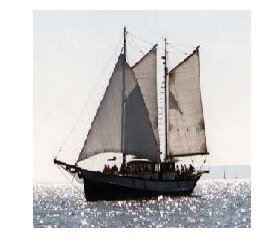

at distance 46.57570926081991:
(Class: schooner)


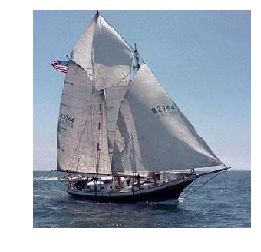

at distance 48.0237830277462:
(Class: schooner)


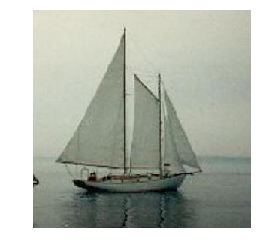

at distance 49.64692371176367:
(Class: schooner)


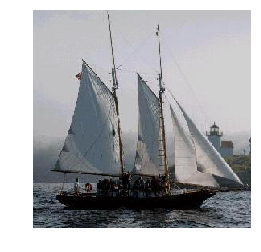

at distance 49.73686354851926:
(Class: ketch)


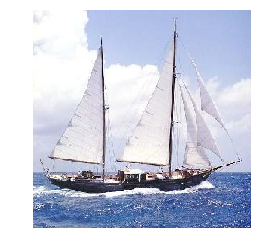

at distance 49.80095403062324:
(Class: schooner)


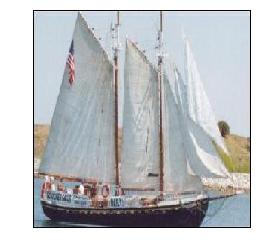

16
============= original: =============
(Class: brain)


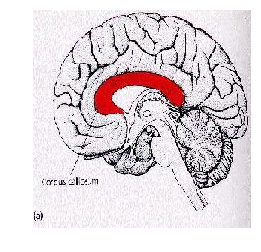

at distance 74.8920136373542:
(Class: brain)


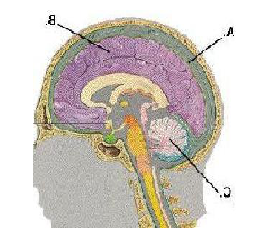

at distance 76.76138845168907:
(Class: snoopy)


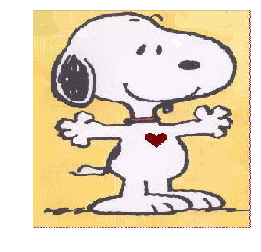

at distance 77.53973727816711:
(Class: yin_yang)


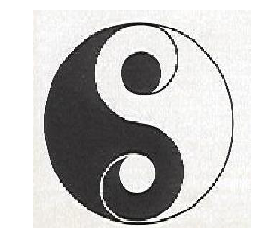

at distance 77.8182787365981:
(Class: brain)


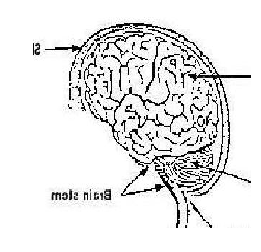

at distance 78.19036368863905:
(Class: garfield)


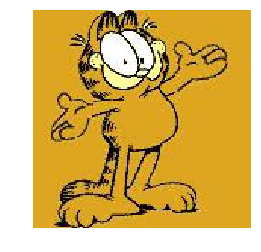

11
============= original: =============
(Class: butterfly)


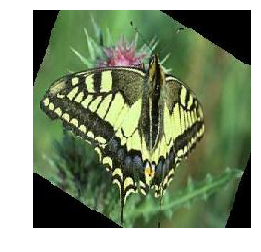

at distance 62.83662438010442:
(Class: butterfly)


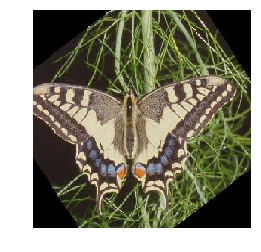

at distance 63.927249925711386:
(Class: butterfly)


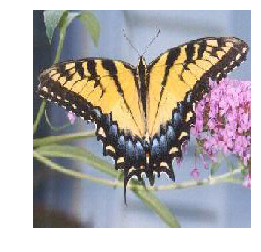

at distance 74.65157842405074:
(Class: butterfly)


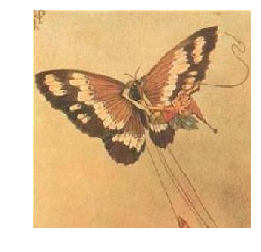

at distance 75.49523110651964:
(Class: mayfly)


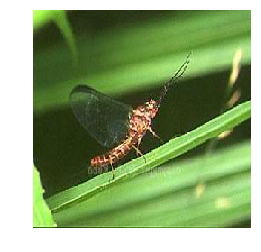

at distance 76.00203613971081:
(Class: crab)


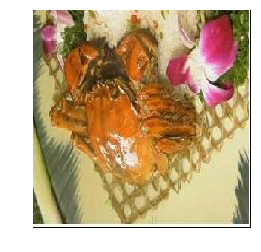

5
============= original: =============
(Class: garfield)


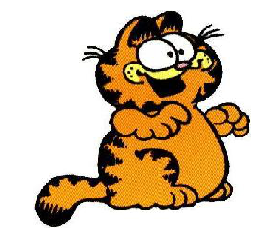

at distance 62.970697964361804:
(Class: garfield)


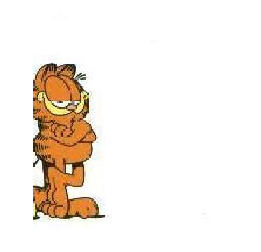

at distance 64.35415947188707:
(Class: garfield)


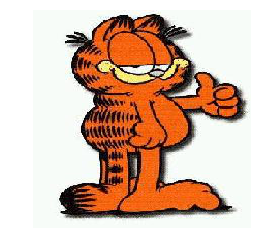

at distance 66.59186034468037:
(Class: garfield)


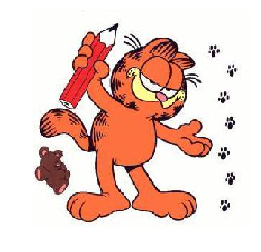

at distance 66.90086536512041:
(Class: garfield)


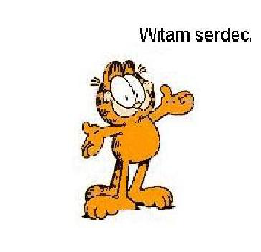

at distance 68.57715289906488:
(Class: snoopy)


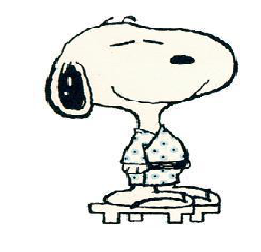

0
============= original: =============
(Class: tick)


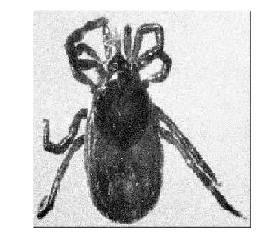

at distance 77.12784360728695:
(Class: tick)


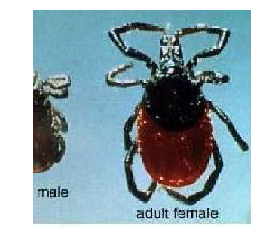

at distance 78.28907824427708:
(Class: tick)


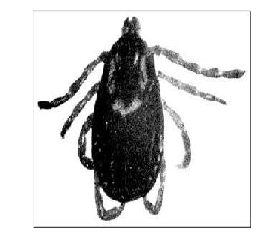

at distance 79.75457660595316:
(Class: tick)


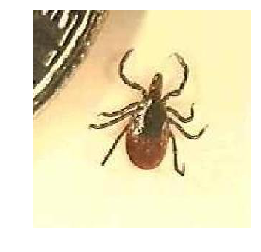

at distance 81.7488231333908:
(Class: tick)


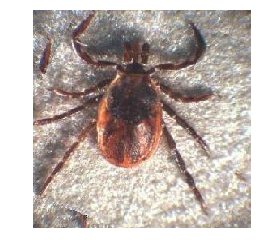

at distance 82.07303264602687:
(Class: tick)


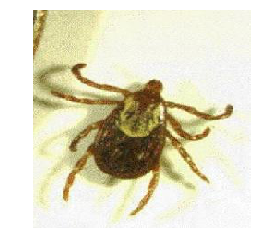

In [6]:
# load the dataset
datapath = "caltech101_VGG16_fc2.p"
with open(os.path.join("data", datapath), "rb") as f:
    X_fc, y, X_paths, classes = pickle.load(f)

neigh = NearestNeighbors(n_neighbors=6, p=2)
neigh.fit(X_fc)
    
# Find NearestNeighbors of the images corresponding to the indices
X = X_fc[indices]
nn = neigh.kneighbors(X)

for i in range(6):
    example_query_index = scores[files.index(datapath)].index(i)
    print(example_query_index)
    print("============= original: =============")
    print("(Class: {})".format(classes[y[indices[example_query_index]]]))
    show_img(X_paths[indices[example_query_index]])
    
    for dist, j in zip(nn[0][example_query_index], nn[1][example_query_index]):
        # Exclude query image from query results
        if indices[example_query_index]!=j:
            print("at distance {}:".format(dist))
            print("(Class: {})".format(classes[y[j]]))
            show_img(X_paths[j])

***

**b)** Looking at the results, what can you say about the "types" of images that obtain good retrieval scores compared to those obtaining poor retrieval scores? Give an explanation and possible solution(s).

(*HINT: How did we obtain data representations for similarity measures?*)

**Answer:**

In the first instance we see that the images which are hard to recognize by a human is also hard for a machine. The first query image is of a beaver, but this is to recognize. 

The second example is of sail boats. The network correctly sees that we are dealing with a sailing boat, but doesn't recognize the type of boats. This error can be mitigated by retraining the network on a dataset which contains more boat examples.

The network also has some problems with drawings of objects. For instance of the brain. Apparently it focusses more on low level features such as high contrast lines. This can also be solved by retraining on illustrations instead of pictures.

The network performs well on tasks where the class of the image is very clear. The tick's and garfields are retreived with high accuracy

***

### Task 1.3: Subjective evaluation
We will now use the "fc2"-features to do image retrieval for query images from the "BACKGROUND_Google" set from the Caltech101 dataset. These images are not associated to a particular class, so we will evaluate them subjectively instead.

**a)** Find two query images from the "BACKGROUND_Google" class, such that for the first query image relevant/similar images are retrieved (according to your own definition of relevancy/similarity), and for the second image mainly irrelevant/dissimilar images are retrieved. For each of them, visualise its 5 nearest neighbors in the Caltech101 dataset (*so do NOT retrieve images from the "BACKGROUND_Google" class!*), according to the "fc2-features" and L2-distance.

============= Query image =============
data/caltech101/BACKGROUND_Google/image_0451.jpg


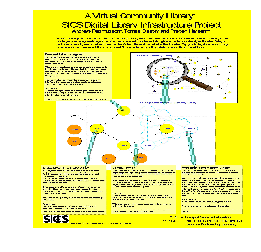

(Class: snoopy)


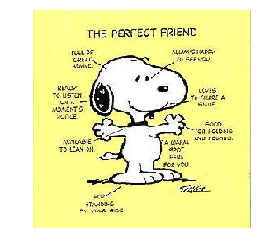

(Class: brain)


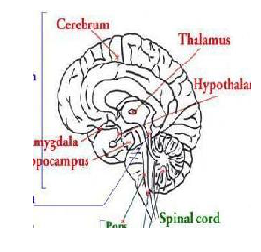

(Class: snoopy)


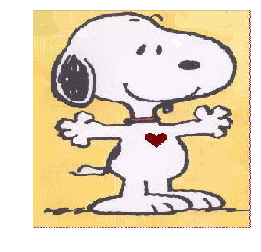

(Class: snoopy)


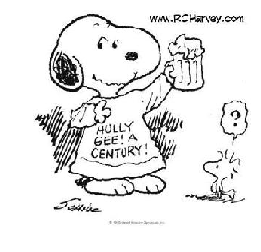

(Class: bass)


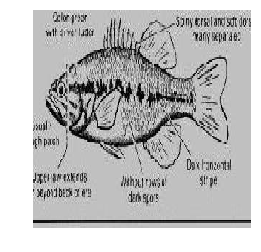

============= Query image =============
data/caltech101/BACKGROUND_Google/image_0405.jpg


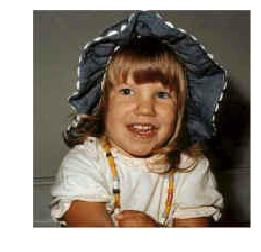

(Class: Faces)


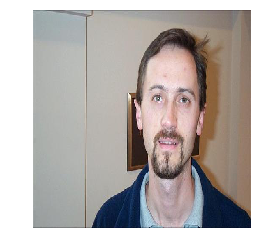

(Class: Faces)


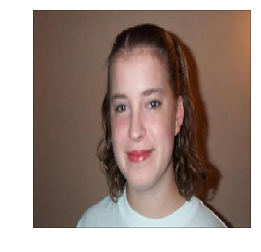

(Class: Faces)


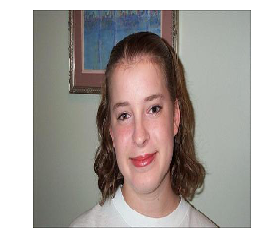

(Class: Faces)


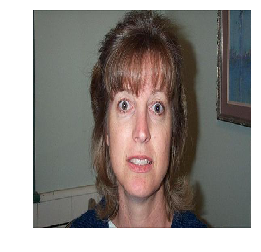

(Class: Faces)


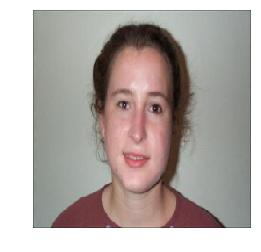

In [7]:
# load the BACKGROUND_Google set
with open(os.path.join("data","caltech101_VGG16_fc2_bg.p"), "rb") as f:
    bg_fc2, bg_paths = pickle.load(f)

# Load caltech101 set
datapath = "caltech101_VGG16_fc2.p"
with open(os.path.join("data", datapath), "rb") as f:
    X_fc, y, X_paths, classes = pickle.load(f)

# === SOLUTION: ===
# insert code here

neigh = NearestNeighbors(n_neighbors=5, p=2)
neigh.fit(X_fc)

# Find NearestNeighbors of the images corresponding to the indices
nn = neigh.kneighbors(bg_fc2)

for i, (distances, nn_indices) in enumerate(zip(nn[0], nn[1])):
    if i in [1,85]:
        print("============= Query image =============")
        print(bg_paths[i])
        show_img(bg_paths[i])

        for dist, j in zip(distances, nn_indices):
            # Exclude query image from query results

            print("(Class: {})".format(classes[y[j]]))
            show_img(X_paths[j])
    

***

**b)** Motivate your idea of "relevance": why do you consider the results for the first image relevant/similar, and those for the second image irrelevant/dissimilar?

**Answer:**

Even though the images in the BACKGROUND_Google dataset do not have a class we can still find try to find images which have a similar subject. The look of the images is less important in our subjective evaluation

***

**c)** Explain why you think this retrieval method (nearest neighbor for neural codes from VGG16) performs better on the first image than on the second.

**Answer:**

**First irrelevant/dissimilar, then relevant/similar**

The picture of a yellow scientific poster returns irrelevant illustrations. This is probably since these have few lines with high contrast. However we do not want to find pictures with a similar look, but with a similar subject. 

We found that the picture of a girl returned pictures of other faces. These pictures are relevant since they have a similar subject. The model performs well since this picture is similar to the training data.

***

### Task 1.4: Dimensionality reduction

**a)** So far we've been using 4096-dimensional neural codes. This space is however still quite high-dimensional. Apply a dimensionality reduction method and evaluate the effect on the retrieval performance.

* Use PCA to obtain lower-dimensional representations of the Caltech101 data "fc2"-features (try the same compression rates as in Table 2 of the "Neural Codes for Image Retrieval" paper).
* Evaluate the same retrieval task as explained at the start of this question for each of the compression rates/dimensionalities. Report the retrieval scores.

*HINT: See http://scikit-learn.org/stable/modules/generated/sklearn.decomposition.PCA.html on how to transform a dataset with PCA.*

In [8]:
# import PCA from scikit-learn
from sklearn.decomposition import PCA

In [9]:
# load the data
datapath = "caltech101_VGG16_fc2.p"
with open(os.path.join("data", datapath), "rb") as f:
    X_fc, y, X_paths, classes = pickle.load(f)
    
# make random selection of n query images/indices, the same for all experiments
n = 200
n_examples = 8677  # the dataset has 8677 images
indices = np.random.choice(range(n_examples), size=n, replace=False)


# === SOLUTION: ===
# insert code here
dimensions = [16, 32, 64, 128, 256, 512]

scores = []
for dim in dimensions:
    print("##########################################################################################")
    print("#################################### dimensionality", dim, "###################################")
    
    pca = PCA(n_components=dim)
    X_fc_reduced = pca.fit_transform(X_fc)
    
    neigh = NearestNeighbors(n_neighbors=6, p=2)
    neigh.fit(X_fc_reduced)
    
    # Find NearestNeighbors of the images corresponding to the indices
    X = X_fc_reduced[indices]
    nn = neigh.kneighbors(X)
    
    print("Query results")
    
    score = []
    for i, distances, nn_indices in zip(indices, nn[0], nn[1]):
        print("============= original: =============")
        print("(Class: {})\n".format(classes[y[i]]))
        #show_img(X_paths[i])
        
        score.append(0.0)
        for dist, j in zip(distances, nn_indices):
            # Exclude query image from query results
            if i!=j:
                #print("at distance {}:".format(dist))
                print("(Class: {})".format(classes[y[j]]))
                #show_img(X_paths[j])
                
                if classes[y[i]] == classes[y[j]]:
                    score[-1] +=1
        
        print(score[-1])
    
    scores.append(score)
    
for sco, dim in zip(scores, dimensions):
    print("Dimensions:", dim, "Score:", sum(sco)/len(sco))

##########################################################################################
#################################### dimensionality 16 ###################################
Query results
============= original: =============
(Class: pyramid)

(Class: pyramid)
(Class: pyramid)
(Class: pyramid)
(Class: pyramid)
(Class: pyramid)
5.0
============= original: =============
(Class: ewer)

(Class: ewer)
(Class: ewer)
(Class: ewer)
(Class: ewer)
(Class: ewer)
5.0
============= original: =============
(Class: accordion)

(Class: accordion)
(Class: accordion)
(Class: accordion)
(Class: accordion)
(Class: accordion)
5.0
============= original: =============
(Class: Motorbikes)

(Class: Motorbikes)
(Class: Motorbikes)
(Class: Motorbikes)
(Class: Motorbikes)
(Class: Motorbikes)
5.0
============= original: =============
(Class: Faces_easy)

(Class: Faces)
(Class: Faces_easy)
(Class: Faces_easy)
(Class: Faces_easy)
(Class: Faces_easy)
4.0
============= original: =============
(Class: camera)


(Class: dalmatian)
(Class: dalmatian)
(Class: dalmatian)
5.0
============= original: =============
(Class: panda)

(Class: panda)
(Class: panda)
(Class: panda)
(Class: panda)
(Class: panda)
5.0
============= original: =============
(Class: water_lilly)

(Class: water_lilly)
(Class: lotus)
(Class: lotus)
(Class: lotus)
(Class: lotus)
1.0
============= original: =============
(Class: laptop)

(Class: laptop)
(Class: laptop)
(Class: laptop)
(Class: laptop)
(Class: laptop)
5.0
============= original: =============
(Class: cougar_face)

(Class: cougar_face)
(Class: cougar_face)
(Class: cougar_face)
(Class: cougar_face)
(Class: cougar_face)
5.0
============= original: =============
(Class: sunflower)

(Class: sunflower)
(Class: sunflower)
(Class: sunflower)
(Class: sunflower)
(Class: sunflower)
5.0
============= original: =============
(Class: Motorbikes)

(Class: Motorbikes)
(Class: Motorbikes)
(Class: Motorbikes)
(Class: Motorbikes)
(Class: Motorbikes)
5.0
============= original: =========

Query results
============= original: =============
(Class: pyramid)

(Class: pyramid)
(Class: pyramid)
(Class: pyramid)
(Class: pyramid)
(Class: pyramid)
5.0
============= original: =============
(Class: ewer)

(Class: ewer)
(Class: ewer)
(Class: ewer)
(Class: ewer)
(Class: ewer)
5.0
============= original: =============
(Class: accordion)

(Class: accordion)
(Class: accordion)
(Class: accordion)
(Class: accordion)
(Class: accordion)
5.0
============= original: =============
(Class: Motorbikes)

(Class: Motorbikes)
(Class: Motorbikes)
(Class: Motorbikes)
(Class: Motorbikes)
(Class: Motorbikes)
5.0
============= original: =============
(Class: Faces_easy)

(Class: Faces_easy)
(Class: Faces)
(Class: Faces_easy)
(Class: Faces_easy)
(Class: Faces_easy)
4.0
============= original: =============
(Class: camera)

(Class: camera)
(Class: camera)
(Class: camera)
(Class: camera)
(Class: camera)
5.0
============= original: =============
(Class: cannon)

(Class: scissors)
(Class: wrench)
(Class: 

(Class: watch)
5.0
============= original: =============
(Class: lotus)

(Class: lotus)
(Class: lotus)
(Class: lotus)
(Class: lotus)
(Class: lotus)
5.0
============= original: =============
(Class: airplanes)

(Class: airplanes)
(Class: airplanes)
(Class: airplanes)
(Class: airplanes)
(Class: airplanes)
5.0
============= original: =============
(Class: cougar_body)

(Class: cougar_body)
(Class: cougar_body)
(Class: cougar_face)
(Class: kangaroo)
(Class: cougar_face)
2.0
============= original: =============
(Class: binocular)

(Class: binocular)
(Class: binocular)
(Class: cup)
(Class: camera)
(Class: binocular)
3.0
============= original: =============
(Class: watch)

(Class: watch)
(Class: watch)
(Class: watch)
(Class: watch)
(Class: watch)
5.0
============= original: =============
(Class: dalmatian)

(Class: dalmatian)
(Class: dalmatian)
(Class: dalmatian)
(Class: dalmatian)
(Class: dalmatian)
5.0
============= original: =============
(Class: ketch)

(Class: schooner)
(Class: ketch)


Query results
============= original: =============
(Class: pyramid)

(Class: pyramid)
(Class: pyramid)
(Class: pyramid)
(Class: pyramid)
(Class: pyramid)
5.0
============= original: =============
(Class: ewer)

(Class: ewer)
(Class: ewer)
(Class: ewer)
(Class: ewer)
(Class: ewer)
5.0
============= original: =============
(Class: accordion)

(Class: accordion)
(Class: accordion)
(Class: accordion)
(Class: accordion)
(Class: accordion)
5.0
============= original: =============
(Class: Motorbikes)

(Class: Motorbikes)
(Class: Motorbikes)
(Class: Motorbikes)
(Class: Motorbikes)
(Class: Motorbikes)
5.0
============= original: =============
(Class: Faces_easy)

(Class: Faces_easy)
(Class: Faces_easy)
(Class: Faces_easy)
(Class: Faces_easy)
(Class: Faces_easy)
5.0
============= original: =============
(Class: camera)

(Class: camera)
(Class: camera)
(Class: camera)
(Class: camera)
(Class: camera)
5.0
============= original: =============
(Class: cannon)

(Class: bass)
(Class: gramophone)
(Cl

(Class: camera)
(Class: camera)
5.0
============= original: =============
(Class: airplanes)

(Class: airplanes)
(Class: airplanes)
(Class: airplanes)
(Class: airplanes)
(Class: airplanes)
5.0
============= original: =============
(Class: water_lilly)

(Class: lotus)
(Class: water_lilly)
(Class: lotus)
(Class: lotus)
(Class: sunflower)
1.0
============= original: =============
(Class: cougar_face)

(Class: cougar_face)
(Class: cougar_face)
(Class: cougar_face)
(Class: cougar_face)
(Class: cougar_face)
5.0
============= original: =============
(Class: wild_cat)

(Class: crocodile)
(Class: wild_cat)
(Class: wild_cat)
(Class: wild_cat)
(Class: cougar_body)
3.0
============= original: =============
(Class: Faces)

(Class: Faces)
(Class: Faces)
(Class: Faces)
(Class: Faces)
(Class: Faces)
5.0
============= original: =============
(Class: bonsai)

(Class: bonsai)
(Class: bonsai)
(Class: bonsai)
(Class: bonsai)
(Class: bonsai)
5.0
============= original: =============
(Class: watch)

(Class: 

Query results
============= original: =============
(Class: pyramid)

(Class: pyramid)
(Class: pyramid)
(Class: pyramid)
(Class: pyramid)
(Class: pyramid)
5.0
============= original: =============
(Class: ewer)

(Class: ewer)
(Class: ewer)
(Class: ewer)
(Class: ewer)
(Class: ewer)
5.0
============= original: =============
(Class: accordion)

(Class: accordion)
(Class: accordion)
(Class: accordion)
(Class: accordion)
(Class: accordion)
5.0
============= original: =============
(Class: Motorbikes)

(Class: Motorbikes)
(Class: Motorbikes)
(Class: Motorbikes)
(Class: Motorbikes)
(Class: Motorbikes)
5.0
============= original: =============
(Class: Faces_easy)

(Class: Faces_easy)
(Class: Faces_easy)
(Class: Faces_easy)
(Class: Faces_easy)
(Class: Faces_easy)
5.0
============= original: =============
(Class: camera)

(Class: camera)
(Class: camera)
(Class: camera)
(Class: camera)
(Class: camera)
5.0
============= original: =============
(Class: cannon)

(Class: bass)
(Class: cougar_face)
(C

(Class: Faces_easy)
5.0
============= original: =============
(Class: pyramid)

(Class: pyramid)
(Class: pyramid)
(Class: pyramid)
(Class: pyramid)
(Class: pyramid)
5.0
============= original: =============
(Class: euphonium)

(Class: euphonium)
(Class: euphonium)
(Class: euphonium)
(Class: crayfish)
(Class: euphonium)
4.0
============= original: =============
(Class: sunflower)

(Class: sunflower)
(Class: sunflower)
(Class: sunflower)
(Class: sunflower)
(Class: sunflower)
5.0
============= original: =============
(Class: ant)

(Class: ant)
(Class: ant)
(Class: ant)
(Class: mayfly)
(Class: ant)
4.0
============= original: =============
(Class: watch)

(Class: watch)
(Class: watch)
(Class: watch)
(Class: watch)
(Class: watch)
5.0
============= original: =============
(Class: lobster)

(Class: lobster)
(Class: lobster)
(Class: lobster)
(Class: lobster)
(Class: bonsai)
4.0
============= original: =============
(Class: Motorbikes)

(Class: Motorbikes)
(Class: Motorbikes)
(Class: Motorbikes

Query results
============= original: =============
(Class: pyramid)

(Class: pyramid)
(Class: pyramid)
(Class: pyramid)
(Class: pyramid)
(Class: pyramid)
5.0
============= original: =============
(Class: ewer)

(Class: ewer)
(Class: ewer)
(Class: ewer)
(Class: ewer)
(Class: ewer)
5.0
============= original: =============
(Class: accordion)

(Class: accordion)
(Class: accordion)
(Class: accordion)
(Class: accordion)
(Class: accordion)
5.0
============= original: =============
(Class: Motorbikes)

(Class: Motorbikes)
(Class: Motorbikes)
(Class: Motorbikes)
(Class: Motorbikes)
(Class: Motorbikes)
5.0
============= original: =============
(Class: Faces_easy)

(Class: Faces_easy)
(Class: Faces_easy)
(Class: Faces_easy)
(Class: Faces_easy)
(Class: Faces_easy)
5.0
============= original: =============
(Class: camera)

(Class: camera)
(Class: camera)
(Class: camera)
(Class: camera)
(Class: camera)
5.0
============= original: =============
(Class: cannon)

(Class: bass)
(Class: cougar_face)
(C

(Class: lotus)
(Class: water_lilly)
(Class: lotus)
2.0
============= original: =============
(Class: laptop)

(Class: laptop)
(Class: laptop)
(Class: laptop)
(Class: laptop)
(Class: laptop)
5.0
============= original: =============
(Class: cougar_face)

(Class: cougar_face)
(Class: cougar_face)
(Class: cougar_face)
(Class: cougar_face)
(Class: cougar_face)
5.0
============= original: =============
(Class: sunflower)

(Class: sunflower)
(Class: sunflower)
(Class: sunflower)
(Class: sunflower)
(Class: sunflower)
5.0
============= original: =============
(Class: Motorbikes)

(Class: Motorbikes)
(Class: Motorbikes)
(Class: Motorbikes)
(Class: Motorbikes)
(Class: Motorbikes)
5.0
============= original: =============
(Class: chandelier)

(Class: chandelier)
(Class: chandelier)
(Class: chandelier)
(Class: chandelier)
(Class: chandelier)
5.0
============= original: =============
(Class: brain)

(Class: brain)
(Class: brain)
(Class: brain)
(Class: brain)
(Class: brain)
5.0
============= origina

Query results
============= original: =============
(Class: pyramid)

(Class: pyramid)
(Class: pyramid)
(Class: pyramid)
(Class: pyramid)
(Class: pyramid)
5.0
============= original: =============
(Class: ewer)

(Class: ewer)
(Class: ewer)
(Class: ewer)
(Class: ewer)
(Class: ewer)
5.0
============= original: =============
(Class: accordion)

(Class: accordion)
(Class: accordion)
(Class: accordion)
(Class: accordion)
(Class: accordion)
5.0
============= original: =============
(Class: Motorbikes)

(Class: Motorbikes)
(Class: Motorbikes)
(Class: Motorbikes)
(Class: Motorbikes)
(Class: Motorbikes)
5.0
============= original: =============
(Class: Faces_easy)

(Class: Faces_easy)
(Class: Faces_easy)
(Class: Faces_easy)
(Class: Faces_easy)
(Class: Faces)
4.0
============= original: =============
(Class: camera)

(Class: camera)
(Class: camera)
(Class: camera)
(Class: camera)
(Class: camera)
5.0
============= original: =============
(Class: cannon)

(Class: bass)
(Class: cougar_face)
(Class:

(Class: cougar_face)
(Class: cougar_face)
(Class: cougar_face)
(Class: cougar_face)
5.0
============= original: =============
(Class: wild_cat)

(Class: wild_cat)
(Class: crocodile)
(Class: wild_cat)
(Class: wild_cat)
(Class: wild_cat)
4.0
============= original: =============
(Class: Faces)

(Class: Faces)
(Class: Faces)
(Class: Faces)
(Class: Faces)
(Class: Faces)
5.0
============= original: =============
(Class: bonsai)

(Class: bonsai)
(Class: bonsai)
(Class: bonsai)
(Class: bonsai)
(Class: bonsai)
5.0
============= original: =============
(Class: watch)

(Class: watch)
(Class: watch)
(Class: watch)
(Class: watch)
(Class: watch)
5.0
============= original: =============
(Class: yin_yang)

(Class: yin_yang)
(Class: yin_yang)
(Class: yin_yang)
(Class: yin_yang)
(Class: yin_yang)
5.0
============= original: =============
(Class: joshua_tree)

(Class: joshua_tree)
(Class: joshua_tree)
(Class: joshua_tree)
(Class: joshua_tree)
(Class: joshua_tree)
5.0
============= original: ===========

***

**b)** Discuss your results: how much can you further reduce the dimensionality of the data representations, without affecting the retrieval performance (much)? Compare these results to those from the paper, are your conclusions similar or not?

**Answer:**

We perfrmed PCA dimensionality reduction on our neural codes. The results of our experiments are as follows:

*Results*
- Dimensions: 16 Score: 3.695
- Dimensions: 32 Score: 4.025
- Dimensions: 64 Score: 4.09
- Dimensions: 128 Score: 4.065
- Dimensions: 256 Score: 4.085
- Dimensions: 512 Score: 4.055

If we heavily compress our data we find that we sacrifice some our retrieval performance. However this applies only when we compress it to less than 32 ~ 64 dimensions. We find that the performance of more than 32 dimensions is very good. This is in line with the findings in the paper "Neural Codes for Image Retrieval". They found similar performance degradation if compress further than 32 dimensions.

***

## Question 2: Fashion-MNIST (12.5pt)
For this question we will work with the "Fashion-MNIST" dataset. This dataset is modelled to have the same specifics as MNIST; it consists of a training set of 60,000 examples, and a test set of 10,000 examples. Each example is a 28x28 greyscale image, associated with a label from one of 10 classes. The images represent various clothing items (as opposed to handwritten digits for MNIST), each class represents a different type of clothing item. The following classes exist:
* 0:	T-shirt/top
* 1:	Trouser
* 2:	Pullover
* 3:	Dress
* 4:	Coat
* 5:	Sandal
* 6:	Shirt
* 7:	Sneaker
* 8:	Bag
* 9:	Ankle boot

In this question we will investigate various ways to model visual similarity for this dataset, in order to perform image retrieval. For more info about the dataset, see https://github.com/zalandoresearch/fashion-mnist.

The dataset can directly be obtained through Keras:

4423680/4422102 [==============================] - 4s 1us/step
X_train shape: (60000, 28, 28, 1)
y_train shape: (60000, 10)
X_test shape: (10000, 28, 28, 1)
y_test shape: (10000, 10)


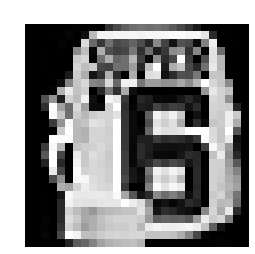

Class: Bag (8)


In [4]:
from keras.datasets import fashion_mnist
from keras.utils import to_categorical
from keras import backend as K

# load the data
(x_train, y_train), (x_test, y_test) = fashion_mnist.load_data()

# properties of the data
img_rows, img_cols, chns = 28, 28, 1
n_classes = 10

# reshape
if K.image_data_format() == 'channels_first':
    x_train = x_train.reshape(x_train.shape[0], chns, img_rows, img_cols)
    x_test = x_test.reshape(x_test.shape[0], chns, img_rows, img_cols)
    input_shape = (chns, img_rows, img_cols)
else:
    x_train = x_train.reshape(x_train.shape[0], img_rows, img_cols, chns)
    x_test = x_test.reshape(x_test.shape[0], img_rows, img_cols, chns)
    input_shape = (img_rows, img_cols, chns)

# normalise
x_train = x_train.astype("float32")
x_test = x_test.astype("float32")
x_train /= 255
x_test /= 255

# transform labels to one-hot encoding, but also keep original single-digit encoding
y_train_digits = y_train
y_test_digits = y_test
y_train = to_categorical(y_train_digits, n_classes)
y_test = to_categorical(y_test_digits, n_classes)

print("X_train shape:", x_train.shape)
print("y_train shape:", y_train.shape)
print("X_test shape:", x_test.shape)
print("y_test shape:", y_test.shape)

classes = ["T-shirt/top", "Trouser", "Pullover", "Dress", "Coat", "Sandal", "Shirt", "Sneaker", "Bag", "Ankle boot"]

# show an example
example_id = 6000  # pick any integer from 0 to 59999 to visualize a training example
example = x_train[example_id].reshape(img_rows, img_cols)
label = y_train[example_id]
label_digit = y_train_digits[example_id]
label_class = classes[label_digit]
plt.matshow(example, cmap="gray")
plt.axis("off")
plt.show()
print("Class: {} ({})".format(label_class, label_digit))

Consider the following situation: We have a fully labelled dataset (the ***labelled set***) of the images from the first 5 classes (t-shirts/tops, trousers, pullovers, dresses, coats). We are then supplied with an unlabelled dataset (the ***retrieval set***) containing the remaining Fashion-MNIST images (sandals, shirts, sneakers, bags, ankle boots) on which we want to be able to perform image retrieval. So we cannot use labels from the retrieval set, since we do not know them (note that in our case we *do* have the labels, but we will only use them for evaluation).

The following code splits the dataset up into two sets representing 5 classes each. Observe that the labelled and the retrieval set have exactly the same size.

In [5]:
# obtain indices of labelled and retrieval sets
indices_train_l = np.argwhere(y_train_digits < 5).flatten()  # indices labelled training set
indices_train_r = np.argwhere(y_train_digits >= 5).flatten()  # indices retrieval training set
indices_test_l = np.argwhere(y_test_digits < 5).flatten()  # indices labelled test set
indices_test_r = np.argwhere(y_test_digits >= 5).flatten()  # indices retrieval test set

# split up train and test set (images and labels)
x_train_l = x_train[indices_train_l]
x_train_r = x_train[indices_train_r]
y_train_l = y_train[indices_train_l]
y_train_r = y_train[indices_train_r]
y_train_digits_l = y_train_digits[indices_train_l]
y_train_digits_r = y_train_digits[indices_train_r]
x_test_l = x_test[indices_test_l]
x_test_r = x_test[indices_test_r]
y_test_l = y_test[indices_test_l]
y_test_r = y_test[indices_test_r]
y_test_digits_l = y_test_digits[indices_test_l]
y_test_digits_r = y_test_digits[indices_test_r]

# labels are now one-hot encoded 10-dimensional vectors, but only the first or last five dimensions are used
# omit unused dimensions to obtain 5-dimensional one-hot encodings
y_train_l = y_train_l[:, :5]
y_train_r = y_train_r[:, 5:]
y_test_l = y_test_l[:, :5]
y_test_r = y_test_r[:, 5:]
# (note that the dimensions of y_train_l/y_test_l do not correspond to those of y_train_r/y_test_r now)

# print the shapes
print(x_train_l.shape)
print(x_train_r.shape)
print(y_train_l.shape)
print(y_train_r.shape)
print(y_train_digits_l.shape)
print(y_train_digits_r.shape)
print(x_test_l.shape)
print(x_test_r.shape)
print(y_test_l.shape)
print(y_test_r.shape)
print(y_test_digits_l.shape)
print(y_test_digits_r.shape)

(30000, 28, 28, 1)
(30000, 28, 28, 1)
(30000, 5)
(30000, 5)
(30000,)
(30000,)
(5000, 28, 28, 1)
(5000, 28, 28, 1)
(5000, 5)
(5000, 5)
(5000,)
(5000,)


***

### Task 2.1: Fashion neural retrieval
**a)** Design an MLP (multilayer perceptron) for classification on the first 5 classes of the Fashion-MNIST dataset (i.e. only use `x_train_l` for training). You may include Dropout and BatchNormalization if needed. Let the last hidden dense layer (before the 5-dimensional output layer) have 128 dimensions. (*HINT: you can use* `name="neural_codes"` *for this layer to make it easier to obtain features from it later.*)

Train it to classify images into their corresponding classes. Make sure that it achieves decent accuracy (at least 90%) on the labelled test set `x_test_l` (show this!). Save the trained model to a ".h5" file. (make sure you're using Keras version 2.1.3!)

In [0]:
# import sequential model and layers
from keras.models import Sequential
from keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, BatchNormalization, Flatten, Dense, Reshape, InputLayer, MaxPool2D, Dropout
from keras.initializers import Constant

In [7]:
mlp = Sequential()

# encoder
mlp = Sequential()
mlp.add(Flatten(input_shape=(28,28,1)))
mlp.add(Dropout(0.13))
mlp.add(BatchNormalization())
mlp.add(Dense(128, activation = "relu", name="neural_codes"))
mlp.add(Dense(5, input_dim=128, activation='softmax'))

mlp.summary()
mlp.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten_1 (Flatten)          (None, 784)               0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 784)               0         
_________________________________________________________________
batch_normalization_1 (Batch (None, 784)               3136      
_________________________________________________________________
neural_codes (Dense)         (None, 128)               100480    
_________________________________________________________________
dense_1 (Dense)              (None, 5)                 645       
Total params: 104,261
Trainable params: 102,693
Non-trainable params: 1,568
_________________________________________________________________


In [8]:
batch_size = 30
epochs = 10

mlp.fit(x_train_l,  y_train_l,
                batch_size=batch_size,
                epochs=epochs,
                validation_data=(x_test_l, y_test_l)
       )

Train on 30000 samples, validate on 5000 samples
Epoch 1/10
30000/30000 [==============================] - 7s 227us/step - loss: 0.1414 - acc: 0.9439 - val_loss: 0.1213 - val_acc: 0.9530
Epoch 2/10
30000/30000 [==============================] - 7s 221us/step - loss: 0.1124 - acc: 0.9554 - val_loss: 0.1070 - val_acc: 0.9594
Epoch 3/10
30000/30000 [==============================] - 7s 219us/step - loss: 0.1023 - acc: 0.9607 - val_loss: 0.1088 - val_acc: 0.9573
Epoch 4/10
30000/30000 [==============================] - 7s 220us/step - loss: 0.0970 - acc: 0.9619 - val_loss: 0.1065 - val_acc: 0.9586
Epoch 5/10
30000/30000 [==============================] - 7s 219us/step - loss: 0.0926 - acc: 0.9639 - val_loss: 0.1014 - val_acc: 0.9612
Epoch 6/10
30000/30000 [==============================] - 7s 220us/step - loss: 0.0894 - acc: 0.9647 - val_loss: 0.1025 - val_acc: 0.9600
Epoch 7/10
 8520/30000 [=======>......................] - ETA: 4s - loss: 0.0874 - acc: 0.965030000/30000 [================

In [0]:
from google.colab import files
mlp.save("mlp_fashionmnist_l.h5")

#files.download("mlp_fashionmnist_1.h5")


***

**b)** Briefly motivate how and why you chose this architecture.

**Answer:**

We chose for the above structure because partially trial and error and from our knowledge both obtained during this course aswell as other courses. Our first layer is a Flatten layer, this layer makes sure that the data structure has the correct shape for the next layers in our model. Our second layer is a Dropout layer, this layer is there to prevent overfitting. During the buidling of our network we had the feeling that it was overfitting so we added a layer to deal with it. The thrid layer is used for normalization. It uses the Batch normalization as proposed by (Ioffe and Szegedy, 2014). Finally we use two dense layers as specified by the assignment. The first dense layer we found out via trail and error that relu was the best activation for it and as specified in the assignment the output of this layer has 128 dimensions. In the last layer we use Softmax as activation and specifiy that the output has to be of 5 dimensions. 


Using the hereby explained neural network we obtained an accuracy of 97% as can be seen above.

***

### Task 2.2: Fashion neural retrieval #2
**a)** Design a CNN (convolutional neural network) for classification on the first 5 classes of the Fashion-MNIST dataset (i.e. only use x_train_l for training), consisting of a number of Convolutions with Max-Pooling, followed by one or more Dense layers. You may use Dropout and BatchNormalization to improve generalization and training speed. Let the last hidden dense layer (before the 5-dimensional output layer) have 128 dimensions. (*HINT: you can use* `name="neural_codes"` *for this layer to make it easier to obtain features from it later.*)

Train the CNN to classify images into their corresponding classes. Make sure that it achieves decent accuracy (at least 94%) on the test set `x_test_l` (show this!). Save the trained model to a ".h5" file. (make sure you're using Keras version 2.1.3!)

In [0]:
# import additional layers
from keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, BatchNormalization, Flatten, Dense, Reshape, InputLayer, MaxPool2D, Convolution2D, Dropout


In [11]:
cnn = Sequential()
cnn.add(Conv2D(32, kernel_size=(3, 3), activation='relu', input_shape=(28,28,1)))
cnn.add(MaxPooling2D(pool_size=(2,2), padding="same"))
cnn.add(Flatten())
cnn.add(Dropout(0.17))
cnn.add(BatchNormalization())
cnn.add(Dense(128,activation='relu',name='neural_codes'))
cnn.add(Dense(5,activation='softmax'))

cnn.summary()
cnn.compile(loss='binary_crossentropy',
              optimizer='adam',
              metrics=['accuracy'])

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_1 (Conv2D)            (None, 26, 26, 32)        320       
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 13, 13, 32)        0         
_________________________________________________________________
flatten_2 (Flatten)          (None, 5408)              0         
_________________________________________________________________
dropout_2 (Dropout)          (None, 5408)              0         
_________________________________________________________________
batch_normalization_2 (Batch (None, 5408)              21632     
_________________________________________________________________
neural_codes (Dense)         (None, 128)               692352    
_________________________________________________________________
dense_2 (Dense)              (None, 5)                 645       
Total para

In [12]:
batch_size = 30
epochs = 10

cnn.fit(x_train_l,  y_train_l,
                batch_size=batch_size,
                epochs=epochs,
                validation_data=(x_test_l, y_test_l)
       )

Train on 30000 samples, validate on 5000 samples
Epoch 1/10
30000/30000 [==============================] - 12s 402us/step - loss: 0.1091 - acc: 0.9584 - val_loss: 0.0872 - val_acc: 0.9690
Epoch 2/10
30000/30000 [==============================] - 11s 367us/step - loss: 0.0745 - acc: 0.9715 - val_loss: 0.0824 - val_acc: 0.9720
Epoch 3/10
 6180/30000 [=====>........................] - ETA: 8s - loss: 0.0615 - acc: 0.977130000/30000 [==============================] - 11s 362us/step - loss: 0.0616 - acc: 0.9760 - val_loss: 0.0812 - val_acc: 0.9726
Epoch 4/10
30000/30000 [==============================] - 11s 367us/step - loss: 0.0530 - acc: 0.9799 - val_loss: 0.0784 - val_acc: 0.9742
Epoch 5/10
18840/30000 [=================>............] - ETA: 3s - loss: 0.0434 - acc: 0.983930000/30000 [==============================] - 11s 366us/step - loss: 0.0446 - acc: 0.9834 - val_loss: 0.0960 - val_acc: 0.9711
Epoch 6/10
30000/30000 [==============================] - 11s 363us/step - loss: 0.0394 - 

In [0]:
from google.colab import files
cnn.save("cnn_fashionmnist_l.h5")

#files.download("cnn_fashionmnist_1.h5")

***

**b)** Briefly motivate how and why you chose this architecture.

**Answer:**

For the architecture of the convolunational neural network we choose for only one convolutional layer and only one maxPooling2D layer. Because using trial and error we found that that was the best. Adding more layers both convolutional as maxpooling layers did not further improve the accuracy.  The rest of the architecture looks very similair to the architecture of our MLP network. We thought that if it worked quite well with out the maxPooling it might as well work after maxPooling. So we tried that and immediately found that the accuracy reached the 97% with ony one Conv2D layer and one maxPooling2D layer.

***

### Task 2.3: Fashion neural retrieval #3
**a)** Design a (convolutional) Denoising Autoencoder (DAE) for the *full* Fashion-MNIST dataset (i.e. use `x_train`, *not* `x_train_l`). For the encoder, use only Convolutional layers and Max-Pooling, followed by a Dense layer with 128 units. The output of this layer will be the "code" of the autoencoder (*HINT: you can use* `name="neural_codes"` *for this layer to make it easier to obtain features from it later*). For the decoder, start with a Dense layer to upscale to a suitable dimension, and then use only Convolutional layers and UpSampling. You may use BatchNormalization to speed up training.

Train the DAE to reconstruct noisy images to the original input images. Make sure that it achieves a binary cross-entropy loss of at most 0.29 on the test set (show this!). Save the trained model to a ".h5" file. (make sure you're using Keras version 2.1.3!)

In [0]:
# import additional layer
from keras.layers import UpSampling2D, Reshape



In [15]:
# obtain noisy version of data
noise_factor = 0.5
x_train_noisy = x_train + noise_factor * np.random.normal(loc=0.0, scale=1.0, size=x_train.shape) 
x_test_noisy = x_test + noise_factor * np.random.normal(loc=0.0, scale=1.0, size=x_test.shape) 

x_train_noisy = np.clip(x_train_noisy, 0., 1.)
x_test_noisy = np.clip(x_test_noisy, 0., 1.)


# define autoencoder
dae = Sequential()

# === SOLUTION: ===
# encoder
dae.add(Conv2D(32, (3, 3), activation='elu', padding='same', input_shape=input_shape))
dae.add(MaxPooling2D((2, 2), padding='same'))
dae.add(BatchNormalization())
dae.add(Conv2D(32, (3, 3), activation='elu', padding='same'))
dae.add(MaxPooling2D((2, 2), padding='same'))
dae.add(BatchNormalization())
dae.add(Flatten())  
dae.add(Dense(128, activation='elu', name="neural_codes"))  


# decoder
dae.add(Dense(1568))  
dae.add(Reshape((7, 7, 32)))
dae.add(Conv2D(32, (3, 3), activation='elu', padding='same'))
dae.add(UpSampling2D((2, 2)))
dae.add(BatchNormalization())
dae.add(Conv2D(32, (3, 3), activation='elu', padding='same'))
dae.add(UpSampling2D((2, 2)))
dae.add(BatchNormalization())
dae.add(Conv2D(1, (3, 3), activation='sigmoid', padding='same'))

dae.summary()
dae.compile(optimizer='adam', loss='binary_crossentropy')

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_2 (Conv2D)            (None, 28, 28, 32)        320       
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 14, 14, 32)        0         
_________________________________________________________________
batch_normalization_3 (Batch (None, 14, 14, 32)        128       
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 14, 14, 32)        9248      
_________________________________________________________________
max_pooling2d_3 (MaxPooling2 (None, 7, 7, 32)          0         
_________________________________________________________________
batch_normalization_4 (Batch (None, 7, 7, 32)          128       
_________________________________________________________________
flatten_3 (Flatten)          (None, 1568)              0         
__________

In [16]:
batch_size = 32
epochs = 10

dae.fit(x_train_noisy, x_train,
                batch_size=batch_size,
                epochs=epochs,
                validation_split=1/12)

Train on 55000 samples, validate on 5000 samples
Epoch 1/10
55000/55000 [==============================] - 36s 656us/step - loss: 0.3093 - val_loss: 0.2946
Epoch 2/10
10112/55000 [====>.........................] - ETA: 26s - loss: 0.292655000/55000 [==============================] - 34s 610us/step - loss: 0.2917 - val_loss: 0.2909
Epoch 3/10
36416/55000 [==================>...........] - ETA: 11s - loss: 0.288255000/55000 [==============================] - 34s 613us/step - loss: 0.2882 - val_loss: 0.2914
Epoch 4/10
46784/55000 [========================>.....] - ETA: 4s - loss: 0.286155000/55000 [==============================] - 34s 612us/step - loss: 0.2861 - val_loss: 0.2876
Epoch 5/10
50912/55000 [==========================>...] - ETA: 2s - loss: 0.284755000/55000 [==============================] - 33s 608us/step - loss: 0.2847 - val_loss: 0.2884
Epoch 6/10
52448/55000 [===========================>..] - ETA: 1s - loss: 0.283655000/55000 [==============================] - 34s 614us/s

In [0]:
from google.colab import files
dae.save("dae_fashionmnist_l.h5")

#files.download("dae_fashionmnist_1.h5")

***

**b)** Briefly motivate how and why you chose this architecture.

**Answer:**

We chose for this architecture based on the architecture of the Denoising Autoencoder from practical 4.1. In this practical an Denoising Autoencoder was build for the MNIST dataset. We tried different activation functions for the different layers of the model. For the convolutional layers we found that relu provided better results than eelu so we sticked by the activation function relu. For the last layer we tried out sigmoid (the same as in the practial) but also hard_sigmoid and tanh. We expected tanh to do better since it is 0 based, however it performed much worse so we sticked with sigmoid as activation function for the last layer. 

***

Visualise a few test examples, their noisy versions, and their reconstructions.

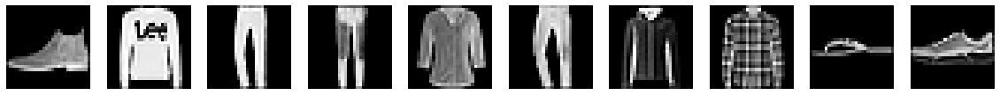

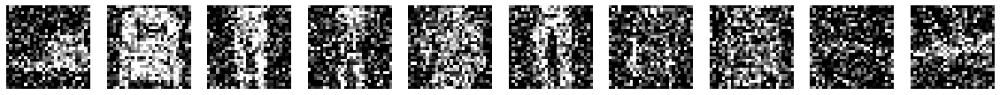

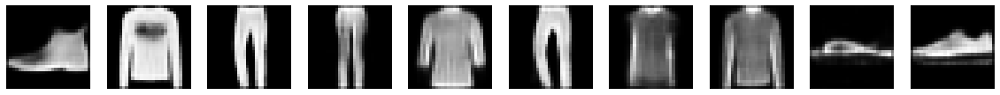

In [111]:
# NOTE: you don't need to change this code, just run it after having trained the DAE
def plot_examples(x):
    n = 10
    plt.figure(figsize=(20, 2))
    for i in range(n):
        ax = plt.subplot(1, n, i+1)
        plt.imshow(x[i].reshape(28, 28))
        plt.gray()
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
    plt.show()

x_test_reconstr = dae.predict(x_test_noisy, batch_size=batch_size)

plot_examples(x_test)
plot_examples(x_test_noisy)
plot_examples(x_test_reconstr)

**c)** Do you consider the results acceptable? Do you think they can be useful for image retrieval? Explain why in one or two sentences.

**Answer:**

We think the obtained results are indeed acceptable. The images reconstructed via our Denoising Autoencoder are recognisable except for the flipflop. However based on the noisy image of the flipflop seems like random pixels. In other of the noisy pictures there is some form recognizable. Another unrecoginizable thing is the text "LEE" on the second example picture. This is most likely due to the lack of training material for such strings.

We think that the can be used for image retrieval since no picture is ever without noise. If you know beforehand what kind of images you will get it is possible to train a Denoising Autoencoder and have it work to obtain pictures which should be somewhat the same as which you were trying to retrieve.

***

**d)** Why can we train on the full dataset `x_train` here, whereas in Tasks 2.1 and 2.2 we had to use `x_train_l` (the first 5 classes only) for training?

**Answer:**

We can do that here because we artifically add noise to the different images. Because of this none of the images which were originally in the set is still in the training sets. We can use a different noise function to obtain a test set which can be quite different than the training images. In the tasks 2.1 and 2.2 this was impossible so we needed to split up the set in order to have a training and test set. We do not need the labels from the training set to validate just the original image for DAE training. 

***

### Task 2.4: Fashion neural retrieval #4
Autoencoders come in different shapes and sizes. One key defining property of autoencoders is the means the model uses to prevent the learning of the identity function. Typically, this is done with different regularization methods. In the previous task you used a model that uses noise as a regularizer. In this task you will develop a Sparse Autoencoder (SAE). A sparse autoencoder uses a sparsity regularization to obtain sparse representations of the input data. Sparsity can be achieved by using L1-regularization on the activations of the hidden "code" layer.


**a)** Design a (convolutional) Sparse Autoencoder (SAE) for the *full* Fashion-MNIST dataset (i.e. use `x_train`, *not* `x_train_l`). For the encoder, use only Convolutional layers and Max-Pooling, followed by a Dense layer with 128 units. The output of this layer will be the "code" of the autoencoder (*HINT: you can use* `name="neural_codes"` *for this layer to make it easier to obtain features from it later*). Add an activity regularizer to this layer, using `regularizers.l1(10e-5)` from Keras.
For the decoder, start with a Dense layer to upscale to a suitable dimension, and then use only Convolutional layers and UpSampling. You may use BatchNormalization to speed up training.

Train the SAE to reconstruct input images. Make sure that it achieves a loss value of at most 0.31 on the test set (show this!). Save the trained model to a ".h5" file. (make sure you're using Keras version 2.1.3!)

In [0]:
# import regularizers for sparse autoencoder
from keras import regularizers

In [19]:
# define autoencoder
sae = Sequential()

# === SOLUTION: ===
# insert code here

sae.add(Conv2D(32, (3, 3), activation='elu', padding='same', input_shape=input_shape))
sae.add(MaxPooling2D((2, 2), padding='same'))
sae.add(BatchNormalization())
sae.add(Conv2D(32, (3, 3), activation='elu', padding='same'))
sae.add(MaxPooling2D((2, 2), padding='same'))
sae.add(BatchNormalization())
sae.add(Flatten())  
sae.add(Dense(128, activation='elu', activity_regularizer=regularizers.l1(10e-5), name="neural_codes"))  


# decoder
sae.add(Dense(1568))  
sae.add(Reshape((7, 7, 32)))
sae.add(Conv2D(32, (3, 3), activation='elu', padding='same'))
sae.add(UpSampling2D((2, 2)))
sae.add(BatchNormalization())
sae.add(Conv2D(32, (3, 3), activation='elu', padding='same'))
sae.add(UpSampling2D((2, 2)))
sae.add(BatchNormalization())
sae.add(Conv2D(1, (3, 3), activation='sigmoid', padding='same'))

sae.summary()
sae.compile(optimizer='adam', loss='binary_crossentropy')

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_7 (Conv2D)            (None, 28, 28, 32)        320       
_________________________________________________________________
max_pooling2d_4 (MaxPooling2 (None, 14, 14, 32)        0         
_________________________________________________________________
batch_normalization_7 (Batch (None, 14, 14, 32)        128       
_________________________________________________________________
conv2d_8 (Conv2D)            (None, 14, 14, 32)        9248      
_________________________________________________________________
max_pooling2d_5 (MaxPooling2 (None, 7, 7, 32)          0         
_________________________________________________________________
batch_normalization_8 (Batch (None, 7, 7, 32)          128       
_________________________________________________________________
flatten_4 (Flatten)          (None, 1568)              0         
__________

In [20]:
batch_size = 32
epochs = 10

sae.fit(x_train_noisy, x_train,
                batch_size=batch_size,
                epochs=epochs,
                validation_split=1/12)

Train on 55000 samples, validate on 5000 samples
Epoch 1/10
55000/55000 [==============================] - 36s 653us/step - loss: 0.3793 - val_loss: 0.3353
Epoch 2/10
10112/55000 [====>.........................] - ETA: 27s - loss: 0.327755000/55000 [==============================] - 34s 621us/step - loss: 0.3124 - val_loss: 0.3004
Epoch 3/10
36416/55000 [==================>...........] - ETA: 11s - loss: 0.299255000/55000 [==============================] - 34s 621us/step - loss: 0.2982 - val_loss: 0.2978
Epoch 4/10
46880/55000 [========================>.....] - ETA: 4s - loss: 0.295255000/55000 [==============================] - 34s 619us/step - loss: 0.2949 - val_loss: 0.2957
Epoch 5/10
50976/55000 [==========================>...] - ETA: 2s - loss: 0.292555000/55000 [==============================] - 34s 624us/step - loss: 0.2926 - val_loss: 0.2934
Epoch 6/10
52544/55000 [===========================>..] - ETA: 1s - loss: 0.291055000/55000 [==============================] - 34s 624us/s

In [0]:
from google.colab import files
sae.save("sae_fashionmnist_l.h5")

#files.download("sae_fashionmnist_1.h5")

***

**b)** Briefly motivate how and why you chose this architecture.

**Answer:**

We chose for this architecture because it already obtained satisfactory results in the previous question with the DEA. We thought and hoped that it would perform equally good. 

***

Visualise a few test examples and their reconstructions.

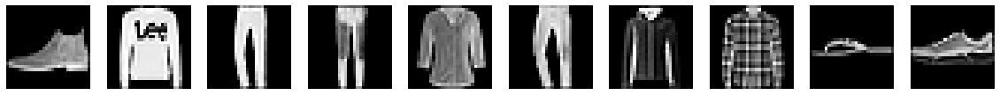

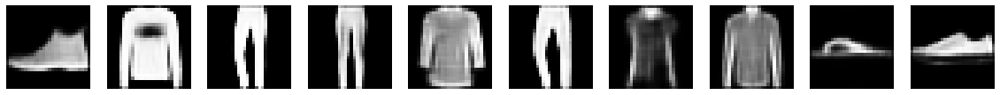

In [121]:
# NOTE: you don't need to change this code, just run it after having trained the SAE
def plot_examples(x):
    n = 10
    plt.figure(figsize=(20, 2))
    for i in range(n):
        ax = plt.subplot(1, n, i+1)
        plt.imshow(x[i].reshape(28, 28))
        plt.gray()
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
    plt.show()

x_test_reconstr = sae.predict(x_test, batch_size=batch_size)

plot_examples(x_test)
plot_examples(x_test_reconstr)

**c)** Compare the visual results to those of the DAE in Task 2.3. Also compare the loss values of the test set for the DAE and SAE. How can you explain the difference?

**Answer:**

There is a little bit of a difference between the loss values of the DAE and the one from the SAE. The SAE has slightly higher loss values but in our opinion does generate better representations of the original picture. For example the flipflop is clearly a flipflop now instead of somewhat of a blur with the DAE. The differences come from the way that both encoders generate their 'corrupted' data of the original data. For the DEA the 'corrupted' data is generated somewhat random and beforehand. This means that any possbible 'corrupted' version has a change to exists, every pixel of the image can be changed. The sparse autoencoder imposes sparcity on hidden layers, in our case on the last dense layer of the encoder. This allowes the autoencoder to learn useful structures of the data. The sparse autoencoder applies penalties on layers. In this case on the activity layer and this penalty is then incorperated into the loss function, thus explaining the higher loss values. 

***

### Task 2.5: Comparison
Obtain 128-dimensional neural code representations of the last five classes of the Fashion-MNIST dataset (the *retrieval set*: `x_train_r`) from the following models/layers:
1. The last dense hidden layer (before the output layer) of the MLP you trained in Task 2.1
2. The last dense hidden layer (before the output layer) of the CNN you trained in Task 2.2
3. The center layer/code of the DAE you trained in Task 2.3
4. The center layer/code of the SAE you trained in Task 2.4
5. A PCA-transformation

In [0]:
# additional imports
from keras.models import load_model
from keras.models import Model
from sklearn.decomposition import PCA

In [28]:
# load the previously trained and saved models
mlp = load_model("mlp_fashionmnist_l.h5")
cnn = load_model("cnn_fashionmnist_l.h5")
dae = load_model("dae_fashionmnist_l.h5")
sae = load_model("sae_fashionmnist_l.h5")
# NOTE: change the name "neural codes" if the layer from which you wish to retrieve neural codes has a different name
mlp_nc = Model(inputs=mlp.input, outputs=mlp.get_layer("neural_codes").output)
cnn_nc = Model(inputs=cnn.input, outputs=cnn.get_layer("neural_codes").output)
dae_nc = Model(inputs=dae.input, outputs=dae.get_layer("neural_codes").output)
sae_nc = Model(inputs=sae.input, outputs=sae.get_layer("neural_codes").output)

# obtain flat representations of the data
x_train_r_flat = x_train_r.reshape((x_train_r.shape[0], -1))
x_test_r_flat = x_test_r.reshape((x_test_r.shape[0], -1))

# train PCA on the retrieval set
pca = PCA(n_components=128)
pca.fit(x_train_r_flat)

# obtain 128-dimensional representations
nc_mlp_train = mlp_nc.predict(x_train_r)
nc_mlp_test = mlp_nc.predict(x_test_r)
nc_cnn_train = cnn_nc.predict(x_train_r)
nc_cnn_test = cnn_nc.predict(x_test_r)
nc_dae_train = dae_nc.predict(x_train_r)
nc_dae_test = dae_nc.predict(x_test_r)
nc_sae_train = sae_nc.predict(x_train_r)
nc_sae_test = sae_nc.predict(x_test_r)
nc_pca_train = pca.transform(x_train_r_flat)
nc_pca_test = pca.transform(x_test_r_flat)

# print the shapes to confirm all features are 128-dimensional
print(nc_mlp_train.shape)
print(nc_mlp_test.shape)
print(nc_cnn_train.shape)
print(nc_cnn_test.shape)
print(nc_dae_train.shape)
print(nc_dae_test.shape)
print(nc_sae_train.shape)
print(nc_sae_test.shape)
print(nc_pca_train.shape)
print(nc_pca_test.shape)

(30000, 128)
(5000, 128)
(30000, 128)
(5000, 128)
(30000, 128)
(5000, 128)
(30000, 128)
(5000, 128)
(30000, 128)
(5000, 128)


***

**a)** Evaluate the retrieval task as described in Question 1 on the last 5 classes (the retrieval set) of the Fashion-MNIST dataset, for the five data representations given above. Use query images from the test set and retrieve images from the training set only. Print the five resulting retrieval scores (between 0 and 5).

*HINT: you can use* `y_train_digits_r` *and* `y_test_digits_r` *to obtain digit encodings (as opposed to one-hot encodings) of the data labels.*

In [66]:
!pip install itertools

  Could not find a version that satisfies the requirement itertools (from versions: )
No matching distribution found for itertools


In [86]:
# make random selection of n query images/indices, the same for all experiments
n = 200
n_examples = 5000  # the retrieval test set has 5000 images
indices = np.random.choice(range(n_examples), size=n, replace=False)
scores=[0,0,0,0,0]
p = 0
#print(y_train_digits_r)
representations = [
    (nc_mlp_train, nc_mlp_test),
    (nc_cnn_train, nc_cnn_test),
    (nc_dae_train, nc_dae_test),
    (nc_sae_train, nc_sae_test),
    (nc_pca_train, nc_pca_test),
]
for (nc_train, nc_test) in representations:
    # === SOLUTION: ===
    # insert code here
    neigh = NearestNeighbors(n_neighbors=5, p=2)
    neigh.fit(nc_train)
    QI = nc_test[indices]
    nn = neigh.kneighbors(QI)
    for i in nn[1]:
      for k, l  in zip(i[:-1], i[1:]):
        #print(k, l)
        label = y_train[k]
        label_digit = y_train_digits[k]
        label_class_j = classes[label_digit]
        #print(label_class)
        label = y_train[l]
        label_digit = y_train_digits[l]
        label_class_k = classes[label_digit]
        #print(label_class)
        if label_class_j == label_class_k:
          scores[p] +=1
    p += 1
for s in scores:
  q = s/200
  print(q)

0.37
0.365
0.435
0.41
0.41


***

**b)** Compare the "baseline" PCA-transformed data with the other methods. Is PCA a suitable method to obtain representations for image retrieval in this situation? Why do you think so? Would you expect a similar conclusion for the Caltech101 dataset from Question 1?

**Answer:**

We do not think that PCA is a suitable method to obtain representations for image retrieval. Out of all the three different models it obtains the best score however it was trained on the retraival set instead of the labeled set. Ofcourse all of them don't achieve a spectecular score (all of them are less than 0.5). Since it is quite random for them to select items from the training set based on images out of the test set. However based on the scores we see that PCA does not perform really better than our trained models. We think this is due to the fact that our models were trained a lot and look at a lot of different things while PCA is a rather simple way of classification compared to neural networks. 

We expect the same result for the Caltech101 dataset since here also there are quite some different classes. However it could play a factor that in those pictures there is color as well which is not present in the FASHION-MINST data set.

***

Observe the difference between encodings from the DAE and SAE.

In [84]:
print("Mean activation for DAE encodings:", np.mean(nc_dae_train))
print("Mean activation for SAE encodings:", np.mean(nc_sae_train))

index = 9000  # try a few indices here
print("DAE encoding example:")
print(nc_dae_train[index])
print("SAE encoding example:")
print(nc_sae_train[index])

Mean activation for DAE encodings: 3.442056
Mean activation for SAE encodings: -0.00017243795
DAE encoding example:
[ 2.83382630e+00 -9.98998106e-01 -9.95019734e-01 -7.43273079e-01
 -9.42138851e-01 -9.99733448e-01 -9.98841822e-01  2.29535084e+01
  9.52881241e+00  1.87907219e+00 -1.00000000e+00  1.34943123e+01
  9.93903828e+00 -9.99506056e-01  6.09373856e+00 -9.98469472e-01
 -9.99911487e-01  1.11554861e+01 -9.65158641e-01 -9.91949856e-01
  2.97600722e+00 -9.99993503e-01 -9.69555378e-01 -9.99689400e-01
 -5.69364727e-01  1.39413226e+00  6.23614550e+00  8.58841133e+00
 -9.99770880e-01 -9.99563694e-01  1.06557169e+01  5.51328135e+00
 -9.92507696e-01  4.86196578e-03 -9.85668480e-01  2.74740434e+00
  6.03305674e+00  5.08033371e+00 -9.99938905e-01 -9.99669135e-01
 -5.35120487e-01  2.18159959e-01 -8.84691238e-01 -9.94392157e-01
 -9.42477942e-01 -9.99991834e-01 -4.34415936e-01 -9.99806225e-01
 -9.88536239e-01  5.49327326e+00  1.54768925e+01 -1.93113625e-01
  8.17384815e+00  8.09881115e+00 -9.985

**c)** Discuss the difference in encodings between the two autoencoders (denoising and sparse). Also discuss the difference in retrieval performance for these encodings. How would you explain this difference?

**Answer:**

There is quite a difference between the different mean activations. It seems that in almost every case the DAE encoding is way more positive than the SAE encoding. We think that it is due to the fact that the DAE encoding looks at a lot of different aspects of the image. It tries to find what are key features for certain classes. The SEA encoding tries to find hidden features in the data. We expect that because of that the encoding is a lot less positive because these features are hidden.

Because the SAE encodings are about hidden features we excpect them to have small differences between images which look a lot like eachother. Because of that it could have a harder time to retrieve images out of the training set based on images out of the trainings set. Since it could not learn those hidden features of the test set. The DAE encoding on the otherhand tries to base itself on noisy images. Because of that we expected it to do a little bit better since now if images look a like it could be seen as a noisy image. 

***

**d)** What is the best performing method you found in part a)? Describe what advantage you believe this method has over the others.

**Answer:**

The best performing method in part a) was the DAE method. We think this is due to the the fact that is model is trained on noisy images, it is trained to deal with corupt data. In some way pictures which have never been seen by the neurel network can be seen as corupted data. We believe that to be the advantage which gives this method an edge over the other methods used in part a). 